### Akbota Mussa

#### Crime  analysis

In [1]:
import pandas as pd
import numpy as np
from arcgis.gis import GIS

In [ ]:
import collections
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap # Needs to be configured if running basemap package
from arcgis.gis import GIS

In [133]:
from mpl_toolkits.basemap import Basemap 
import mpl_toolkits

In [4]:
df = pd.read_csv('MCI_2014_to_2017.csv')

In [5]:
df.head()

,X,Y,Index_,event_unique_id,occurrencedate,reporteddate,premisetype,ucr_code,ucr_ext,offence,...,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Hood_ID,Neighbourhood,Lat,Long,FID
0,-79.520401,43.768829,14601,GO-20142775022,2014-08-25T04:00:00.000Z,2014-08-25T04:00:00.000Z,Outside,1430,100,Assault,...,237.0,Monday,18,Assault,D31,24,Black Creek (24),43.768829,-79.520401,14001
1,-79.580856,43.642574,14602,GO-20142870874,2014-08-25T04:00:00.000Z,2014-09-08T04:00:00.000Z,House,2120,220,B&E W'Intent,...,237.0,Monday,9,Break and Enter,D22,11,Eringate-Centennial-West Deane (11),43.642574,-79.580856,14002
2,-79.260445,43.762909,14603,GO-20142802386,2014-08-25T04:00:00.000Z,2014-08-29T04:00:00.000Z,House,1430,100,Assault,...,237.0,Monday,11,Assault,D41,127,Bendale (127),43.762909,-79.260445,14003
3,-79.367546,43.663208,14604,GO-20142777955,2014-08-25T04:00:00.000Z,2014-08-26T04:00:00.000Z,Commercial,2120,200,B&E,...,237.0,Monday,17,Break and Enter,D51,71,Cabbagetown-South St.James Town (71),43.663208,-79.367546,14004
4,-79.231758,43.776440,14605,GO-20142778699,2014-08-25T04:00:00.000Z,2014-08-26T04:00:00.000Z,Other,2120,200,B&E,...,237.0,Monday,16,Break and Enter,D43,137,Woburn (137),43.776440,-79.231758,14005


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 131073 entries, 0 to 131072
Data columns (total 29 columns):
X                      131073 non-null float64
Y                      131073 non-null float64
Index_                 131073 non-null int64
event_unique_id        131073 non-null object
occurrencedate         131073 non-null object
reporteddate           131073 non-null object
premisetype            131073 non-null object
ucr_code               131073 non-null int64
ucr_ext                131073 non-null int64
offence                131073 non-null object
reportedyear           131073 non-null int64
reportedmonth          131073 non-null object
reportedday            131073 non-null int64
reporteddayofyear      131073 non-null int64
reporteddayofweek      131073 non-null object
reportedhour           131073 non-null int64
occurrenceyear         131033 non-null float64
occurrencemonth        131033 non-null object
occurrenceday          131033 non-null float64
occurrencedayofyea

In [19]:
df.dtypes

X                      float64
Y                      float64
Index_                   int64
event_unique_id         object
occurrencedate          object
reporteddate            object
premisetype             object
ucr_code                 int64
ucr_ext                  int64
offence                 object
reportedyear             int64
reportedmonth           object
reportedday              int64
reporteddayofyear        int64
reporteddayofweek       object
reportedhour             int64
occurrenceyear         float64
occurrencemonth         object
occurrenceday          float64
occurrencedayofyear    float64
occurrencedayofweek     object
occurrencehour           int64
MCI                     object
Division                object
Hood_ID                  int64
Neighbourhood           object
Lat                    float64
Long                   float64
FID                      int64
dtype: object

In [7]:
df.columns

Index(['X', 'Y', 'Index_', 'event_unique_id', 'occurrencedate', 'reporteddate',
       'premisetype', 'ucr_code', 'ucr_ext', 'offence', 'reportedyear',
       'reportedmonth', 'reportedday', 'reporteddayofyear',
       'reporteddayofweek', 'reportedhour', 'occurrenceyear',
       'occurrencemonth', 'occurrenceday', 'occurrencedayofyear',
       'occurrencedayofweek', 'occurrencehour', 'MCI', 'Division', 'Hood_ID',
       'Neighbourhood', 'Lat', 'Long', 'FID'],
      dtype='object')

# Data Visualization

In [134]:
try:
    import csv
    import numpy as np
    import pandas as pd
    import collections
    import matplotlib.pyplot as plt
    from mpl_toolkits.basemap import Basemap # Needs to be configured if running basemap package
    from arcgis.gis import GIS
except:
    !pip install arcgis
    !pip install --upgrade matplotlib

C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:15: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  from ipykernel import kernelapp as app


Text(0.5, 1.0, 'Location of Major Crime Indicator Toronto 2014 - 2017')

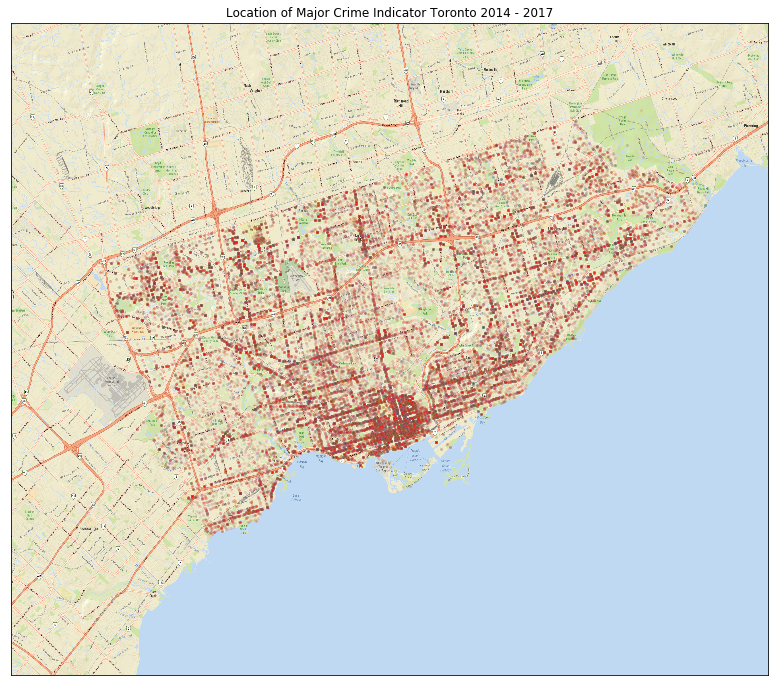

In [16]:
plt.figure(figsize=(15,12))

Long = [-79.71,-79.07] # Longitude Range
Lat = [43.5,43.9] # Latitude Range

# Create basemap map
my_map = Basemap(
    epsg=3395,
    projection='merc',
    resolution='h',
    area_thresh = 10,
    llcrnrlon = Long[0],     # Lower latitude
    urcrnrlon = Long[1],     # Upper longitude
    llcrnrlat = Lat[0],      # Lower latitude
    urcrnrlat = Lat[1]       # Upper latitude
)

# Basemap map drawing parameters
#my_map.drawcoastlines()
#my_map.drawcountries()
#my_map.drawmapboundary()
#my_map.drawstates()
#my_map.drawrivers()
#my_map.fillcontinents(color='green',alpha=0.3)
#my_map.shadedrelief()

my_map.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels=12000, verbose=False)

my_lats = list(df.Lat)
my_lats = my_lats[0:71440]
my_longs = list(df.Long)
my_longs = my_longs[0:71440]

X,Y = my_map(my_longs, my_lats)
# Draw weather stations on map:
for (x,y) in zip(X,Y):
    my_map.plot(x,y,
                markerfacecolor=([1,0,0]),
                marker = 'o',
                markersize = 2,
                alpha = 0.1)
plt.title('Location of Major Crime Indicator Toronto 2014 - 2017')

In [17]:
x = 0
for i in dic_Assault:
    x += dic_Assault[i]
print (x)

NameError: name 'dic_Assault' is not defined

In [18]:
df.head(2)

,X,Y,Index_,event_unique_id,occurrencedate,reporteddate,premisetype,ucr_code,ucr_ext,offence,...,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Hood_ID,Neighbourhood,Lat,Long,FID
0,-79.520401,43.768829,14601,GO-20142775022,2014-08-25T04:00:00.000Z,2014-08-25T04:00:00.000Z,Outside,1430,100,Assault,...,237.0,Monday,18,Assault,D31,24,Black Creek (24),43.768829,-79.520401,14001
1,-79.580856,43.642574,14602,GO-20142870874,2014-08-25T04:00:00.000Z,2014-09-08T04:00:00.000Z,House,2120,220,B&E W'Intent,...,237.0,Monday,9,Break and Enter,D22,11,Eringate-Centennial-West Deane (11),43.642574,-79.580856,14002


In [8]:
df.MCI.head()

0            Assault
1    Break and Enter
2            Assault
3    Break and Enter
4    Break and Enter
Name: MCI, dtype: object

In [6]:
assault = df[df['MCI']=='Assault']
type(assault)

pandas.core.frame.DataFrame

In [7]:
assault.shape

(71440, 29)

In [26]:
for i,a in assault.iterrows():
    print(i)

(0, X                                      -79.5204
Y                                       43.7688
Index_                                    14601
event_unique_id                  GO-20142775022
occurrencedate         2014-08-25T04:00:00.000Z
reporteddate           2014-08-25T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  25
reporteddayofyear                           237
reporteddayofweek                    Monday    
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                25
occurrencedayofyear                         237
occurrencedayofweek                 

(64, X                                          -79.5131
Y                                           43.6869
Index_                                        14665
event_unique_id                      GO-20142924017
occurrencedate             2014-09-16T04:00:00.000Z
reporteddate               2014-09-16T04:00:00.000Z
premisetype                               Apartment
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                             September
reportedday                                      16
reporteddayofyear                               259
reporteddayofweek                        Tuesday   
reportedhour                                     22
occurrenceyear                                 2014
occurrencemonth                           September
occurrenceday                                    16
occurre

(134, X                                          -79.4982
Y                                           43.7655
Index_                                        14531
event_unique_id                      GO-20142908701
occurrencedate             2014-09-14T04:00:00.000Z
reporteddate               2014-09-14T04:00:00.000Z
premisetype                                 Outside
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                             September
reportedday                                      14
reporteddayofyear                               257
reporteddayofweek                        Sunday    
reportedhour                                     17
occurrenceyear                                 2014
occurrencemonth                           September
occurrenceday                                    14
occurr

Name: 184, dtype: object)
(185, X                                                      -79.4465
Y                                                       43.6667
Index_                                                    14580
event_unique_id                                  GO-20142908318
occurrencedate                         2014-09-14T04:00:00.000Z
reporteddate                           2014-09-14T04:00:00.000Z
premisetype                                           Apartment
ucr_code                                                   1430
ucr_ext                                                     100
offence                                                 Assault
reportedyear                                               2014
reportedmonth                                         September
reportedday                                                  14
reporteddayofyear                                           257
reporteddayofweek                                    Sunday    
reported

(271, X                                         -79.5201
Y                                          43.7378
Index_                                       14750
event_unique_id                     GO-20142717501
occurrencedate            2014-08-16T04:00:00.000Z
reporteddate              2014-08-17T04:00:00.000Z
premisetype                                Outside
ucr_code                                      1430
ucr_ext                                        100
offence                                    Assault
reportedyear                                  2014
reportedmonth                               August
reportedday                                     17
reporteddayofyear                              229
reporteddayofweek                       Sunday    
reportedhour                                     0
occurrenceyear                                2014
occurrencemonth                             August
occurrenceday                                   16
occurrencedayofyear      

Name: 389, dtype: object)
(390, X                                      -79.1621
Y                                       43.7888
Index_                                    14862
event_unique_id                  GO-20142863595
occurrencedate         2014-09-07T04:00:00.000Z
reporteddate           2014-09-07T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                   7
reporteddayofyear                           250
reporteddayofweek                    Sunday    
reportedhour                                 17
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                 7
occurrencedayofyear                         250
occurren

(449, X                                      -79.4442
Y                                         43.64
Index_                                    14111
event_unique_id                  GO-20142804542
occurrencedate         2014-08-30T04:00:00.000Z
reporteddate           2014-08-30T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  30
reporteddayofyear                           242
reporteddayofweek                    Saturday  
reportedhour                                  5
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                30
occurrencedayofyear                         242
occurrencedayofweek               

(547, X                                       -79.421
Y                                       43.6395
Index_                                    14430
event_unique_id                  GO-20142716904
occurrencedate         2014-08-16T04:00:00.000Z
reporteddate           2014-08-16T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  16
reporteddayofyear                           228
reporteddayofweek                    Saturday  
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                16
occurrencedayofyear                         228
occurrencedayofweek               

(623, X                                      -79.4159
Y                                       43.6836
Index_                                    14498
event_unique_id                  GO-20143002368
occurrencedate         2014-09-05T04:00:00.000Z
reporteddate           2014-09-05T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                   5
reporteddayofyear                           248
reporteddayofweek                    Friday    
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                 5
occurrencedayofyear                         248
occurrencedayofweek               

(721, X                                       -79.3909
Y                                        43.6995
Index_                                     14021
event_unique_id                   GO-20142407596
occurrencedate          2014-07-01T04:00:00.000Z
reporteddate            2014-07-01T04:00:00.000Z
premisetype                            Apartment
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                               July
reportedday                                    1
reporteddayofyear                            182
reporteddayofweek                     Tuesday   
reportedhour                                  12
occurrenceyear                              2014
occurrencemonth                             July
occurrenceday                                  1
occurrencedayofyear                          182
occurrencedayo

(884, X                                                      -79.5158
Y                                                       43.6121
Index_                                                    14385
event_unique_id                                  GO-20142893630
occurrencedate                         2014-08-25T04:00:00.000Z
reporteddate                           2014-09-12T04:00:00.000Z
premisetype                                               Other
ucr_code                                                   1430
ucr_ext                                                     100
offence                                                 Assault
reportedyear                                               2014
reportedmonth                                         September
reportedday                                                  12
reporteddayofyear                                           255
reporteddayofweek                                    Friday    
reportedhour                      

Name: 1005, dtype: object)
(1006, X                                       -79.261
Y                                       43.7566
Index_                                      507
event_unique_id                  GO-20141438766
occurrencedate         2013-09-27T04:00:00.000Z
reporteddate           2014-01-30T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  30
reporteddayofyear                            30
reporteddayofweek                    Thursday  
reportedhour                                 17
occurrenceyear                             2013
occurrencemonth                       September
occurrenceday                                27
occurrencedayofyear                         270
occurr

Name: 1064, dtype: object)
(1065, X                                      -79.3421
Y                                       43.6909
Index_                                      564
event_unique_id                  GO-20141354605
occurrencedate         2013-11-01T04:00:00.000Z
reporteddate           2014-01-16T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  16
reporteddayofyear                            16
reporteddayofweek                    Thursday  
reportedhour                                 13
occurrenceyear                             2013
occurrencemonth                        November
occurrenceday                                 1
occurrencedayofyear                         305
occurr

Name: 1111, dtype: object)
(1113, X                                                   -79.5894
Y                                                    43.7585
Index_                                                     7
event_unique_id                               GO-20151776190
occurrencedate                      2000-01-01T05:00:00.000Z
reporteddate                        2015-10-15T04:00:00.000Z
premisetype                                        Apartment
ucr_code                                                1430
ucr_ext                                                  100
offence                                              Assault
reportedyear                                            2015
reportedmonth                                        October
reportedday                                               15
reporteddayofyear                                        288
reporteddayofweek                                 Thursday  
reportedhour                                       

Name: 1151, dtype: object)
(1152, X                                      -79.2414
Y                                       43.7209
Index_                                       46
event_unique_id                  GO-20142840249
occurrencedate         2008-06-06T04:00:00.000Z
reporteddate           2014-09-04T04:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                         September
reportedday                                   4
reporteddayofyear                           247
reporteddayofweek                    Thursday  
reportedhour                                 10
occurrenceyear                             2008
occurrencemonth                            June
occurrenceday                                 6
occurrencedayofyear                         158
occurr

(1196, X                                                  -79.3704
Y                                                   43.6703
Index_                                                   88
event_unique_id                              GO-20141963354
occurrencedate                     1998-01-01T05:00:00.000Z
reporteddate                       2014-04-26T04:00:00.000Z
premisetype                                       Apartment
ucr_code                                               1420
ucr_ext                                                 100
offence                                 Assault With Weapon
reportedyear                                           2014
reportedmonth                                         April
reportedday                                              26
reporteddayofyear                                       116
reporteddayofweek                                Saturday  
reportedhour                                             15
occurrenceyear                   

Name: 1249, dtype: object)
(1250, X                                                -79.2815
Y                                                 43.7782
Index_                                                142
event_unique_id                            GO-20162307104
occurrencedate                   2010-08-01T04:00:00.000Z
reporteddate                     2016-12-29T05:00:00.000Z
premisetype                                     Apartment
ucr_code                                             1430
ucr_ext                                               100
offence                                           Assault
reportedyear                                         2016
reportedmonth                                    December
reportedday                                            29
reporteddayofyear                                     364
reporteddayofweek                              Thursday  
reportedhour                                           20
occurrenceyear                        

Name: 1295, dtype: object)
(1299, X                                        -79.22
Y                                       43.8103
Index_                                      189
event_unique_id                  GO-20141536165
occurrencedate         2011-02-07T05:00:00.000Z
reporteddate           2014-02-15T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  15
reporteddayofyear                            46
reporteddayofweek                    Saturday  
reportedhour                                 16
occurrenceyear                             2011
occurrencemonth                        February
occurrenceday                                 7
occurrencedayofyear                          38
occurr

Name: 1347, dtype: object)
(1348, X                                       -79.2867
Y                                        43.7001
Index_                                       233
event_unique_id                   GO-20141637937
occurrencedate          2012-03-01T05:00:00.000Z
reporteddate            2014-01-01T05:00:00.000Z
premisetype                            Apartment
ucr_code                                    1420
ucr_ext                                      110
offence                      Assault Bodily Harm
reportedyear                                2014
reportedmonth                            January
reportedday                                    1
reporteddayofyear                              1
reporteddayofweek                     Wednesday 
reportedhour                                  16
occurrenceyear                              2012
occurrencemonth                            March
occurrenceday                                  1
occurrencedayofyear                

(1393, X                                       -79.4267
Y                                        43.7207
Index_                                       275
event_unique_id                   GO-20151997686
occurrencedate          2012-06-01T04:00:00.000Z
reporteddate            2015-11-21T05:00:00.000Z
premisetype                                House
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2015
reportedmonth                           November
reportedday                                   21
reporteddayofyear                            325
reporteddayofweek                     Saturday  
reportedhour                                  11
occurrenceyear                              2012
occurrencemonth                             June
occurrenceday                                  1
occurrencedayofyear                          153
occurrenceday

Name: 1436, dtype: object)
(1437, X                                      -79.1738
Y                                       43.7647
Index_                                      322
event_unique_id                  GO-20152092228
occurrencedate         2012-03-27T04:00:00.000Z
reporteddate           2015-12-06T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          December
reportedday                                   6
reporteddayofyear                           340
reporteddayofweek                    Sunday    
reportedhour                                 20
occurrenceyear                             2012
occurrencemonth                           March
occurrenceday                                27
occurrencedayofyear                          87
occurr

Name: 1488, dtype: object)
(1489, X                                      -79.2268
Y                                         43.73
Index_                                      373
event_unique_id                  GO-20161510735
occurrencedate         2013-08-01T04:00:00.000Z
reporteddate           2016-08-26T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2016
reportedmonth                            August
reportedday                                  26
reporteddayofyear                           239
reporteddayofweek                    Friday    
reportedhour                                  7
occurrenceyear                             2013
occurrencemonth                          August
occurrenceday                                 1
occurrencedayofyear                         213
occurr

Name: 1550, dtype: object)
(1551, X                                                    -79.3889
Y                                                     43.6488
Index_                                                    827
event_unique_id                                GO-20141453453
occurrencedate                       2014-02-02T05:00:00.000Z
reporteddate                         2014-02-02T05:00:00.000Z
premisetype                                         Apartment
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                        February
reportedday                                                 2
reporteddayofyear                                          33
reporteddayofweek                                  Sunday    
reportedhour                        

Name: 1595, dtype: object)
(1597, X                                      -79.3536
Y                                       43.6616
Index_                                      873
event_unique_id                  GO-20141453179
occurrencedate         2014-02-02T05:00:00.000Z
reporteddate           2014-02-02T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                   2
reporteddayofyear                            33
reporteddayofweek                    Sunday    
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                 2
occurrencedayofyear                          33
occurr

Name: 1639, dtype: object)
(1640, X                                      -79.2779
Y                                         43.73
Index_                                      409
event_unique_id                  GO-20143187432
occurrencedate         2013-01-01T05:00:00.000Z
reporteddate           2014-10-27T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  27
reporteddayofyear                           300
reporteddayofweek                    Monday    
reportedhour                                 18
occurrenceyear                             2013
occurrencemonth                         January
occurrenceday                                 1
occurrencedayofyear                           1
occurr

Name: 1734, dtype: object)
(1735, X                                                    -79.3939
Y                                                     43.6465
Index_                                                    999
event_unique_id                                GO-20141259767
occurrencedate                       2014-01-01T05:00:00.000Z
reporteddate                         2014-01-01T05:00:00.000Z
premisetype                                           Outside
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                         January
reportedday                                                 1
reporteddayofyear                                           1
reporteddayofweek                                  Wednesday 
reportedhour                        

Name: 1846, dtype: object)
(1847, X                                      -79.3466
Y                                       43.7032
Index_                                      737
event_unique_id                  GO-20142509323
occurrencedate         2014-01-01T05:00:00.000Z
reporteddate           2014-07-16T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  16
reporteddayofyear                           197
reporteddayofweek                    Wednesday 
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 1
occurrencedayofyear                           1
occurr

Name: 1930, dtype: object)
(1931, X                                         -79.2492
Y                                          43.7066
Index_                                         432
event_unique_id                     GO-20141627088
occurrencedate            2013-05-01T04:00:00.000Z
reporteddate              2014-03-02T05:00:00.000Z
premisetype                              Apartment
ucr_code                                      1430
ucr_ext                                        100
offence                                    Assault
reportedyear                                  2014
reportedmonth                                March
reportedday                                      2
reporteddayofyear                               61
reporteddayofweek                       Sunday    
reportedhour                                    15
occurrenceyear                                2013
occurrencemonth                                May
occurrenceday                                   

Name: 2004, dtype: object)
(2005, X                                        -79.26
Y                                       43.7389
Index_                                    11406
event_unique_id                  GO-20142353498
occurrencedate         2014-06-23T04:00:00.000Z
reporteddate           2014-06-23T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                  23
reporteddayofyear                           174
reporteddayofweek                    Monday    
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                23
occurrencedayofyear                         174
occurr

Name: 2061, dtype: object)
(2062, X                                                    -79.3923
Y                                                     43.6461
Index_                                                  11461
event_unique_id                                GO-20142347639
occurrencedate                       2014-06-23T04:00:00.000Z
reporteddate                         2014-06-23T04:00:00.000Z
premisetype                                        Commercial
ucr_code                                                 1410
ucr_ext                                                   100
offence                                    Aggravated Assault
reportedyear                                             2014
reportedmonth                                            June
reportedday                                                23
reporteddayofyear                                         174
reporteddayofweek                                  Monday    
reportedhour                        

Name: 2130, dtype: object)
(2131, X                                                    -79.3933
Y                                                     43.6484
Index_                                                  11503
event_unique_id                                GO-20142367648
occurrencedate                       2014-06-24T04:00:00.000Z
reporteddate                         2014-06-24T04:00:00.000Z
premisetype                                        Commercial
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                            June
reportedday                                                24
reporteddayofyear                                         175
reporteddayofweek                                  Tuesday   
reportedhour                        

Name: 2218, dtype: object)
(2220, X                                       -79.5132
Y                                        43.7255
Index_                                     11370
event_unique_id                   GO-20142558065
occurrencedate          2014-06-20T04:00:00.000Z
reporteddate            2014-07-23T04:00:00.000Z
premisetype                            Apartment
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                               July
reportedday                                   23
reporteddayofyear                            204
reporteddayofweek                     Wednesday 
reportedhour                                  19
occurrenceyear                              2014
occurrencemonth                             June
occurrenceday                                 20
occurrencedayofyear                

Name: 2313, dtype: object)
(2314, X                                      -79.3268
Y                                       43.6789
Index_                                    11254
event_unique_id                  GO-20142347077
occurrencedate         2014-06-22T04:00:00.000Z
reporteddate           2014-06-22T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                  22
reporteddayofyear                           173
reporteddayofweek                    Sunday    
reportedhour                                 23
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                22
occurrencedayofyear                         173
occurr

Name: 2410, dtype: object)
(2411, X                                      -79.4434
Y                                       43.6908
Index_                                    11517
event_unique_id                  GO-20142360750
occurrencedate         2014-06-24T04:00:00.000Z
reporteddate           2014-06-24T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                              June
reportedday                                  24
reporteddayofyear                           175
reporteddayofweek                    Tuesday   
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                24
occurrencedayofyear                         175
occurr

Name: 2486, dtype: object)
(2487, X                                      -79.3414
Y                                       43.6579
Index_                                    11183
event_unique_id                  GO-20142103676
occurrencedate         2014-05-18T04:00:00.000Z
reporteddate           2014-05-18T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                               May
reportedday                                  18
reporteddayofyear                           138
reporteddayofweek                    Sunday    
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                18
occurrencedayofyear                         138
occurr

Name: 2536, dtype: object)
(2537, X                                        -79.3785
Y                                         43.6599
Index_                                      11525
event_unique_id                    GO-20142356210
occurrencedate           2014-06-24T04:00:00.000Z
reporteddate             2014-06-24T04:00:00.000Z
premisetype                               Outside
ucr_code                                     1460
ucr_ext                                       100
offence                     Assault Peace Officer
reportedyear                                 2014
reportedmonth                                June
reportedday                                    24
reporteddayofyear                             175
reporteddayofweek                      Tuesday   
reportedhour                                    9
occurrenceyear                               2014
occurrencemonth                              June
occurrenceday                                  24
occurrencedayofy

(2578, X                                       -79.2828
Y                                        43.7279
Index_                                     11564
event_unique_id                   GO-20142393732
occurrencedate          2014-06-29T04:00:00.000Z
reporteddate            2014-06-29T04:00:00.000Z
premisetype                                Other
ucr_code                                    1420
ucr_ext                                      100
offence                      Assault With Weapon
reportedyear                                2014
reportedmonth                               June
reportedday                                   29
reporteddayofyear                            180
reporteddayofweek                     Sunday    
reportedhour                                  16
occurrenceyear                              2014
occurrencemonth                             June
occurrenceday                                 29
occurrencedayofyear                          180
occurrenceday

Name: 2643, dtype: object)
(2644, X                                         -79.5166
Y                                          43.7461
Index_                                       11735
event_unique_id                     GO-20142427889
occurrencedate            2014-07-04T04:00:00.000Z
reporteddate              2014-07-04T04:00:00.000Z
premisetype                              Apartment
ucr_code                                      1430
ucr_ext                                        100
offence                                    Assault
reportedyear                                  2014
reportedmonth                                 July
reportedday                                      4
reporteddayofyear                              185
reporteddayofweek                       Friday    
reportedhour                                    10
occurrenceyear                                2014
occurrencemonth                               July
occurrenceday                                   

Name: 2700, dtype: object)
(2701, X                                      -79.5421
Y                                       43.7509
Index_                                    11792
event_unique_id                  GO-20142140172
occurrencedate         2014-05-24T04:00:00.000Z
reporteddate           2014-05-24T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                  24
reporteddayofyear                           144
reporteddayofweek                    Saturday  
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                24
occurrencedayofyear                         144
occurr

Name: 2756, dtype: object)
(2758, X                                      -79.2774
Y                                       43.8057
Index_                                    11962
event_unique_id                  GO-20142524749
occurrencedate         2014-07-18T04:00:00.000Z
reporteddate           2014-07-18T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                              July
reportedday                                  18
reporteddayofyear                           199
reporteddayofweek                    Friday    
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                18
occurrencedayofyear                         199
occurr

Name: 2814, dtype: object)
(2815, X                                        -79.3793
Y                                         43.6524
Index_                                      11832
event_unique_id                    GO-20142480545
occurrencedate           2014-07-12T04:00:00.000Z
reporteddate             2014-07-12T04:00:00.000Z
premisetype                               Outside
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                                July
reportedday                                    12
reporteddayofyear                             193
reporteddayofweek                      Saturday  
reportedhour                                    3
occurrenceyear                               2014
occurrencemonth                              July
occurrenceday                                  12
occurrencedayofy

Name: 2870, dtype: object)
(2872, X                                       -79.436
Y                                       43.6988
Index_                                    11885
event_unique_id                  GO-20142412806
occurrencedate         2014-07-02T04:00:00.000Z
reporteddate           2014-07-02T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                   2
reporteddayofyear                           183
reporteddayofweek                    Wednesday 
reportedhour                                 10
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                 2
occurrencedayofyear                         183
occurr

Name: 2947, dtype: object)
(2948, X                                      -79.2765
Y                                          43.8
Index_                                    11093
event_unique_id                  GO-20142328478
occurrencedate         2014-06-20T04:00:00.000Z
reporteddate           2014-06-20T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                  20
reporteddayofyear                           171
reporteddayofweek                    Friday    
reportedhour                                  7
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                20
occurrencedayofyear                         171
occurr

Name: 3013, dtype: object)
(3014, X                                      -79.3234
Y                                       43.8116
Index_                                     3915
event_unique_id                  GO-20142622001
occurrencedate         2014-03-01T05:00:00.000Z
reporteddate           2014-08-02T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                   2
reporteddayofyear                           214
reporteddayofweek                    Saturday  
reportedhour                                 13
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                 1
occurrencedayofyear                          60
occurr

(3069, X                                       -79.2993
Y                                        43.7167
Index_                                      3969
event_unique_id                   GO-20141584187
occurrencedate          2014-02-22T05:00:00.000Z
reporteddate            2014-02-23T05:00:00.000Z
premisetype                              Outside
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                           February
reportedday                                   23
reporteddayofyear                             54
reporteddayofweek                     Sunday    
reportedhour                                  20
occurrenceyear                              2014
occurrencemonth                         February
occurrenceday                                 22
occurrencedayofyear                           53
occurrenceday

Name: 3140, dtype: object)
(3141, X                                      -79.4102
Y                                       43.6627
Index_                                     3631
event_unique_id                  GO-20141565198
occurrencedate         2014-02-20T05:00:00.000Z
reporteddate           2014-02-20T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  20
reporteddayofyear                            51
reporteddayofweek                    Thursday  
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                20
occurrencedayofyear                          51
occurr

Name: 3225, dtype: object)
(3226, X                                      -79.5117
Y                                        43.766
Index_                                     3102
event_unique_id                  GO-20141515774
occurrencedate         2014-02-09T05:00:00.000Z
reporteddate           2014-02-12T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                          February
reportedday                                  12
reporteddayofyear                            43
reporteddayofweek                    Wednesday 
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                 9
occurrencedayofyear                          40
occurr

Name: 3321, dtype: object)
(3325, X                                                   -79.5901
Y                                                    43.7375
Index_                                                  3464
event_unique_id                               GO-20141551093
occurrencedate                      2014-02-14T05:00:00.000Z
reporteddate                        2014-02-18T05:00:00.000Z
premisetype                                            Other
ucr_code                                                1430
ucr_ext                                                  100
offence                                              Assault
reportedyear                                            2014
reportedmonth                                       February
reportedday                                               18
reporteddayofyear                                         49
reporteddayofweek                                 Tuesday   
reportedhour                                       

Name: 3410, dtype: object)
(3413, X                                        -79.391
Y                                         43.656
Index_                                      3838
event_unique_id                   GO-20141560969
occurrencedate          2014-02-19T05:00:00.000Z
reporteddate            2014-02-19T05:00:00.000Z
premisetype                            Apartment
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                           February
reportedday                                   19
reporteddayofyear                             50
reporteddayofweek                     Wednesday 
reportedhour                                  21
occurrenceyear                              2014
occurrencemonth                         February
occurrenceday                                 19
occurrencedayofyear                

Name: 3477, dtype: object)
(3478, X                                      -79.2737
Y                                       43.6944
Index_                                     3717
event_unique_id                  GO-20141623094
occurrencedate         2014-03-01T05:00:00.000Z
reporteddate           2014-03-01T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                             March
reportedday                                   1
reporteddayofyear                            60
reporteddayofweek                    Saturday  
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                 1
occurrencedayofyear                          60
occurr

Name: 3556, dtype: object)
(3557, X                                      -79.5744
Y                                       43.7336
Index_                                     3572
event_unique_id                  GO-20141531924
occurrencedate         2014-02-14T05:00:00.000Z
reporteddate           2014-02-14T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  14
reporteddayofyear                            45
reporteddayofweek                    Friday    
reportedhour                                 23
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                14
occurrencedayofyear                          45
occurr

Name: 3635, dtype: object)
(3636, X                                       -79.5039
Y                                        43.7328
Index_                                      3765
event_unique_id                   GO-20141509000
occurrencedate          2014-02-11T05:00:00.000Z
reporteddate            2014-02-11T05:00:00.000Z
premisetype                                Other
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                           February
reportedday                                   11
reporteddayofyear                             42
reporteddayofweek                     Tuesday   
reportedhour                                  14
occurrenceyear                              2014
occurrencemonth                         February
occurrenceday                                 11
occurrencedayofyear                

Name: 3721, dtype: object)
(3722, X                                          -79.4865
Y                                           43.7448
Index_                                         3359
event_unique_id                      GO-20141589783
occurrencedate             2014-02-18T05:00:00.000Z
reporteddate               2014-02-24T05:00:00.000Z
premisetype                                   Other
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                              February
reportedday                                      24
reporteddayofyear                                55
reporteddayofweek                        Monday    
reportedhour                                     14
occurrenceyear                                 2014
occurrencemonth                            February
occurrenceday                 

Name: 3787, dtype: object)
(3789, X                                      -79.2455
Y                                       43.7399
Index_                                     3222
event_unique_id                  GO-20142976942
occurrencedate         2014-05-01T04:00:00.000Z
reporteddate           2014-09-24T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                  24
reporteddayofyear                           267
reporteddayofweek                    Wednesday 
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                 1
occurrencedayofyear                         121
occurr

Name: 3846, dtype: object)
(3848, X                                      -79.3166
Y                                       43.6664
Index_                                     3178
event_unique_id                  GO-20141525749
occurrencedate         2014-02-12T05:00:00.000Z
reporteddate           2014-02-12T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                          February
reportedday                                  12
reporteddayofyear                            43
reporteddayofweek                    Wednesday 
reportedhour                                 23
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                12
occurrencedayofyear                          43
occurr

Name: 3932, dtype: object)
(3938, X                                      -79.3738
Y                                       43.6673
Index_                                     3239
event_unique_id                  GO-20141510813
occurrencedate         2014-02-11T05:00:00.000Z
reporteddate           2014-02-11T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  11
reporteddayofyear                            42
reporteddayofweek                    Tuesday   
reportedhour                                 16
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                11
occurrencedayofyear                          42
occurr

Name: 4035, dtype: object)
(4036, X                                        -79.4503
Y                                         43.6957
Index_                                       9329
event_unique_id                    GO-20142198142
occurrencedate           2014-06-01T04:00:00.000Z
reporteddate             2014-06-01T04:00:00.000Z
premisetype                               Outside
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                                June
reportedday                                     1
reporteddayofyear                             152
reporteddayofweek                      Sunday    
reportedhour                                   15
occurrenceyear                               2014
occurrencemonth                              June
occurrenceday                                   1
occurrencedayofy

Name: 4116, dtype: object)
(4117, X                                      -79.2318
Y                                       43.7764
Index_                                     9202
event_unique_id                  GO-20141850031
occurrencedate         2014-04-01T04:00:00.000Z
reporteddate           2014-04-08T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                   8
reporteddayofyear                            98
reporteddayofweek                    Tuesday   
reportedhour                                 10
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                 1
occurrencedayofyear                          91
occurr

Name: 4186, dtype: object)
(4188, X                                      -79.4367
Y                                       43.6406
Index_                                     9608
event_unique_id                  GO-20141849630
occurrencedate         2014-04-08T04:00:00.000Z
reporteddate           2014-04-08T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                             April
reportedday                                   8
reporteddayofyear                            98
reporteddayofweek                    Tuesday   
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                 8
occurrencedayofyear                          98
occurr

Name: 4325, dtype: object)
(4328, X                                      -79.3245
Y                                       43.7124
Index_                                     9525
event_unique_id                  GO-20142213661
occurrencedate         2014-06-03T04:00:00.000Z
reporteddate           2014-06-03T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                   3
reporteddayofyear                           154
reporteddayofweek                    Tuesday   
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                 3
occurrencedayofyear                         154
occurr

Name: 4489, dtype: object)
(4490, X                                      -79.4278
Y                                       43.6352
Index_                                     9188
event_unique_id                  GO-20141805158
occurrencedate         2014-04-01T04:00:00.000Z
reporteddate           2014-04-01T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                   1
reporteddayofyear                            91
reporteddayofweek                    Tuesday   
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                 1
occurrencedayofyear                          91
occurr

Name: 4671, dtype: object)
(4672, X                                          -79.381
Y                                          43.6657
Index_                                        9481
event_unique_id                     GO-20142398311
occurrencedate            2014-06-30T04:00:00.000Z
reporteddate              2014-06-30T04:00:00.000Z
premisetype                             Commercial
ucr_code                                      1480
ucr_ext                                        110
offence                Administering Noxious Thing
reportedyear                                  2014
reportedmonth                                 June
reportedday                                     30
reporteddayofyear                              181
reporteddayofweek                       Monday    
reportedhour                                     5
occurrenceyear                                2014
occurrencemonth                               June
occurrenceday                                   

Name: 4891, dtype: object)
(4893, X                                         -79.595
Y                                         43.7311
Index_                                       9967
event_unique_id                    GO-20142255258
occurrencedate           2014-06-08T04:00:00.000Z
reporteddate             2014-06-09T04:00:00.000Z
premisetype                                 House
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                                June
reportedday                                     9
reporteddayofyear                             160
reporteddayofweek                      Monday    
reportedhour                                   13
occurrenceyear                               2014
occurrencemonth                              June
occurrenceday                                   8
occurrencedayofy

Name: 4953, dtype: object)
(4954, X                                      -79.3366
Y                                        43.669
Index_                                     9755
event_unique_id                  GO-20141910514
occurrencedate         2014-04-17T04:00:00.000Z
reporteddate           2014-04-17T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                  17
reporteddayofyear                           107
reporteddayofweek                    Thursday  
reportedhour                                 17
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                17
occurrencedayofyear                         107
occurr

Name: 5036, dtype: object)
(5037, X                                      -79.3416
Y                                       43.6908
Index_                                     6036
event_unique_id                  GO-20141319265
occurrencedate         2014-01-08T05:00:00.000Z
reporteddate           2014-01-10T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  10
reporteddayofyear                            10
reporteddayofweek                    Friday    
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 8
occurrencedayofyear                           8
occurr

Name: 5086, dtype: object)
(5092, X                                      -79.3002
Y                                        43.684
Index_                                     6091
event_unique_id                  GO-20141303307
occurrencedate         2014-01-08T05:00:00.000Z
reporteddate           2014-01-08T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1460
ucr_ext                                     100
offence                   Assault Peace Officer
reportedyear                               2014
reportedmonth                           January
reportedday                                   8
reporteddayofyear                             8
reporteddayofweek                    Wednesday 
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 8
occurrencedayofyear                           8
occurr

(5160, X                                       -79.204
Y                                       43.7519
Index_                                     6254
event_unique_id                  GO-20141320499
occurrencedate         2014-01-10T05:00:00.000Z
reporteddate           2014-01-10T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  10
reporteddayofyear                            10
reporteddayofweek                    Friday    
reportedhour                                 23
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                10
occurrencedayofyear                          10
occurrencedayofweek              

Name: 5269, dtype: object)
(5270, X                                                 -79.249
Y                                                 43.7917
Index_                                               6952
event_unique_id                            GO-20142027703
occurrencedate                   2014-05-06T04:00:00.000Z
reporteddate                     2014-05-06T04:00:00.000Z
premisetype                                    Commercial
ucr_code                                             1420
ucr_ext                                               100
offence                               Assault With Weapon
reportedyear                                         2014
reportedmonth                                         May
reportedday                                             6
reporteddayofyear                                     126
reporteddayofweek                              Tuesday   
reportedhour                                           19
occurrenceyear                        

Name: 5372, dtype: object)
(5375, X                                            -79.3984
Y                                             43.7067
Index_                                           6343
event_unique_id                        GO-20141351191
occurrencedate               2014-01-15T05:00:00.000Z
reporteddate                 2014-01-15T05:00:00.000Z
premisetype                                   Outside
ucr_code                                         1440
ucr_ext                                           100
offence                Unlawfully Causing Bodily Harm
reportedyear                                     2014
reportedmonth                                 January
reportedday                                        15
reporteddayofyear                                  15
reporteddayofweek                          Wednesday 
reportedhour                                       22
occurrenceyear                                   2014
occurrencemonth                               Ja

Name: 5460, dtype: object)
(5461, X                                            -79.3005
Y                                              43.725
Index_                                           6441
event_unique_id                        GO-20141361869
occurrencedate               2014-01-17T05:00:00.000Z
reporteddate                 2014-01-17T05:00:00.000Z
premisetype                                Commercial
ucr_code                                         1480
ucr_ext                                           100
offence                Assault - Resist/ Prevent Seiz
reportedyear                                     2014
reportedmonth                                 January
reportedday                                        17
reporteddayofyear                                  17
reporteddayofweek                          Friday    
reportedhour                                       15
occurrenceyear                                   2014
occurrencemonth                               Ja

(5568, X                                               -79.4896
Y                                                43.6657
Index_                                              6569
event_unique_id                           GO-20141719924
occurrencedate                  2014-03-17T04:00:00.000Z
reporteddate                    2014-03-17T04:00:00.000Z
premisetype                                        House
ucr_code                                            1430
ucr_ext                                              100
offence                                          Assault
reportedyear                                        2014
reportedmonth                                      March
reportedday                                           17
reporteddayofyear                                     76
reporteddayofweek                             Monday    
reportedhour                                          23
occurrenceyear                                      2014
occurrencemonth         

(5626, X                                          -79.5253
Y                                           43.6793
Index_                                         6127
event_unique_id                      GO-20142151369
occurrencedate             2014-05-25T04:00:00.000Z
reporteddate               2014-05-25T04:00:00.000Z
premisetype                                 Outside
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                                   May
reportedday                                      25
reporteddayofyear                               145
reporteddayofweek                        Sunday    
reportedhour                                     19
occurrenceyear                                 2014
occurrencemonth                                 May
occurrenceday                                    25
occur

Name: 5748, dtype: object)
(5749, X                                       -79.2804
Y                                        43.7158
Index_                                      6650
event_unique_id                   GO-20151898147
occurrencedate          2014-02-01T05:00:00.000Z
reporteddate            2015-11-04T05:00:00.000Z
premisetype                                House
ucr_code                                    1420
ucr_ext                                      100
offence                      Assault With Weapon
reportedyear                                2015
reportedmonth                           November
reportedday                                    4
reporteddayofyear                            308
reporteddayofweek                     Wednesday 
reportedhour                                  20
occurrenceyear                              2014
occurrencemonth                         February
occurrenceday                                  1
occurrencedayofyear                

Name: 5828, dtype: object)
(5829, X                                      -79.2495
Y                                       43.7512
Index_                                     6729
event_unique_id                  GO-20141447352
occurrencedate         2014-02-01T05:00:00.000Z
reporteddate           2014-02-01T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                   1
reporteddayofyear                            32
reporteddayofweek                    Saturday  
reportedhour                                  1
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                 1
occurrencedayofyear                          32
occurr

Name: 5939, dtype: object)
(5940, X                                        -79.3821
Y                                         43.6591
Index_                                       6841
event_unique_id                    GO-20142016378
occurrencedate           2014-05-05T04:00:00.000Z
reporteddate             2014-05-05T04:00:00.000Z
premisetype                             Apartment
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                                 May
reportedday                                     5
reporteddayofyear                             125
reporteddayofweek                      Monday    
reportedhour                                    0
occurrenceyear                               2014
occurrencemonth                               May
occurrenceday                                   5
occurrencedayofy

Name: 6046, dtype: object)
(6050, X                                      -79.3194
Y                                       43.7043
Index_                                    10050
event_unique_id                  GO-20142300599
occurrencedate         2014-06-16T04:00:00.000Z
reporteddate           2014-06-16T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                  16
reporteddayofyear                           167
reporteddayofweek                    Monday    
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                16
occurrencedayofyear                         167
occurr

Name: 6266, dtype: object)
(6267, X                                       -79.442
Y                                       43.7357
Index_                                    10212
event_unique_id                  GO-20142012498
occurrencedate         2014-05-03T04:00:00.000Z
reporteddate           2014-05-04T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                   4
reporteddayofyear                           124
reporteddayofweek                    Sunday    
reportedhour                                 10
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                 3
occurrencedayofyear                         123
occurr

Name: 6339, dtype: object)
(6342, X                                      -79.4524
Y                                       43.7796
Index_                                    10371
event_unique_id                  GO-20142037202
occurrencedate         2014-05-08T04:00:00.000Z
reporteddate           2014-05-08T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                   8
reporteddayofyear                           128
reporteddayofweek                    Thursday  
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                 8
occurrencedayofyear                         128
occurr

Name: 6415, dtype: object)
(6416, X                                               -79.56
Y                                              43.6479
Index_                                           10134
event_unique_id                         GO-20142448134
occurrencedate                2014-07-05T04:00:00.000Z
reporteddate                  2014-07-07T04:00:00.000Z
premisetype                                      Other
ucr_code                                          1430
ucr_ext                                            100
offence                                        Assault
reportedyear                                      2014
reportedmonth                                     July
reportedday                                          7
reporteddayofyear                                  188
reporteddayofweek                           Monday    
reportedhour                                        12
occurrenceyear                                    2014
occurrencemonth                

Name: 6520, dtype: object)
(6521, X                                      -79.3042
Y                                       43.6831
Index_                                    10839
event_unique_id                  GO-20142123798
occurrencedate         2014-05-17T04:00:00.000Z
reporteddate           2014-05-21T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                               May
reportedday                                  21
reporteddayofyear                           141
reporteddayofweek                    Wednesday 
reportedhour                                 16
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                17
occurrencedayofyear                         137
occurr

Name: 6592, dtype: object)
(6593, X                                      -79.5474
Y                                       43.6066
Index_                                    10524
event_unique_id                  GO-20142059053
occurrencedate         2014-05-11T04:00:00.000Z
reporteddate           2014-05-11T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                  11
reporteddayofyear                           131
reporteddayofweek                    Sunday    
reportedhour                                 17
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                11
occurrencedayofyear                         131
occurr

Name: 6702, dtype: object)
(6704, X                                      -79.3555
Y                                       43.6912
Index_                                    10230
event_unique_id                  GO-20142437334
occurrencedate         2014-07-05T04:00:00.000Z
reporteddate           2014-07-05T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                   5
reporteddayofyear                           186
reporteddayofweek                    Saturday  
reportedhour                                 17
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                 5
occurrencedayofyear                         186
occurr

Name: 6790, dtype: object)
(6792, X                                      -79.4185
Y                                       43.7791
Index_                                    10533
event_unique_id                  GO-20142056871
occurrencedate         2014-05-11T04:00:00.000Z
reporteddate           2014-05-11T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                  11
reporteddayofyear                           131
reporteddayofweek                    Sunday    
reportedhour                                 10
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                11
occurrencedayofyear                         131
occurr

Name: 6904, dtype: object)
(6905, X                                      -79.5188
Y                                       43.7692
Index_                                    10464
event_unique_id                  GO-20142035952
occurrencedate         2014-05-08T04:00:00.000Z
reporteddate           2014-05-08T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                   8
reporteddayofyear                           128
reporteddayofweek                    Thursday  
reportedhour                                  3
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                 8
occurrencedayofyear                         128
occurr

Name: 7009, dtype: object)
(7010, X                                       -79.2828
Y                                        43.7279
Index_                                     12009
event_unique_id                   GO-20142264357
occurrencedate          2014-06-10T04:00:00.000Z
reporteddate            2014-06-10T04:00:00.000Z
premisetype                                Other
ucr_code                                    1460
ucr_ext                                      100
offence                    Assault Peace Officer
reportedyear                                2014
reportedmonth                               June
reportedday                                   10
reporteddayofyear                            161
reporteddayofweek                     Tuesday   
reportedhour                                  21
occurrenceyear                              2014
occurrencemonth                             June
occurrenceday                                 10
occurrencedayofyear                

Name: 7131, dtype: object)
(7133, X                                       -79.5086
Y                                        43.7209
Index_                                     12119
event_unique_id                   GO-20142310249
occurrencedate          2014-06-17T04:00:00.000Z
reporteddate            2014-06-17T04:00:00.000Z
premisetype                              Outside
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                               June
reportedday                                   17
reporteddayofyear                            168
reporteddayofweek                     Tuesday   
reportedhour                                  16
occurrenceyear                              2014
occurrencemonth                             June
occurrenceday                                 17
occurrencedayofyear                

Name: 7269, dtype: object)
(7270, X                                      -79.4524
Y                                       43.7796
Index_                                    12656
event_unique_id                  GO-20142556732
occurrencedate         2014-07-21T04:00:00.000Z
reporteddate           2014-07-23T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  23
reporteddayofyear                           204
reporteddayofweek                    Wednesday 
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                21
occurrencedayofyear                         202
occurr

Name: 7361, dtype: object)
(7362, X                                      -79.2651
Y                                       43.7515
Index_                                    12325
event_unique_id                  GO-20142809841
occurrencedate         2014-07-12T04:00:00.000Z
reporteddate           2014-08-30T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  30
reporteddayofyear                           242
reporteddayofweek                    Saturday  
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                12
occurrencedayofyear                         193
occurr

Name: 7474, dtype: object)
(7475, X                                       -79.2202
Y                                        43.7359
Index_                                     12422
event_unique_id                   GO-20142607027
occurrencedate          2014-07-31T04:00:00.000Z
reporteddate            2014-07-31T04:00:00.000Z
premisetype                            Apartment
ucr_code                                    1420
ucr_ext                                      100
offence                      Assault With Weapon
reportedyear                                2014
reportedmonth                               July
reportedday                                   31
reporteddayofyear                            212
reporteddayofweek                     Thursday  
reportedhour                                   7
occurrenceyear                              2014
occurrencemonth                             July
occurrenceday                                 31
occurrencedayofyear                

Name: 7561, dtype: object)
(7564, X                                            -79.352
Y                                            43.6776
Index_                                         12709
event_unique_id                       GO-20142643250
occurrencedate              2014-08-05T04:00:00.000Z
reporteddate                2014-08-05T04:00:00.000Z
premisetype                                    Other
ucr_code                                        1430
ucr_ext                                          100
offence                                      Assault
reportedyear                                    2014
reportedmonth                                 August
reportedday                                        5
reporteddayofyear                                217
reporteddayofweek                         Tuesday   
reportedhour                                      21
occurrenceyear                                  2014
occurrencemonth                               August
occurrenceda

Name: 7635, dtype: object)
(7636, X                                      -79.3526
Y                                       43.6655
Index_                                    12870
event_unique_id                  GO-20142529103
occurrencedate         2014-07-19T04:00:00.000Z
reporteddate           2014-07-19T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  19
reporteddayofyear                           200
reporteddayofweek                    Saturday  
reportedhour                                 13
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                19
occurrencedayofyear                         200
occurr

Name: 7723, dtype: object)
(7727, X                                          -79.2927
Y                                           43.7935
Index_                                        12584
event_unique_id                      GO-20142317829
occurrencedate             2014-06-18T04:00:00.000Z
reporteddate               2014-06-18T04:00:00.000Z
premisetype                                 Outside
ucr_code                                       1420
ucr_ext                                         110
offence                         Assault Bodily Harm
reportedyear                                   2014
reportedmonth                                  June
reportedday                                      18
reporteddayofyear                               169
reporteddayofweek                        Wednesday 
reportedhour                                     16
occurrenceyear                                 2014
occurrencemonth                                June
occurrenceday                 

Name: 7820, dtype: object)
(7821, X                                      -79.3035
Y                                       43.6951
Index_                                    12276
event_unique_id                  GO-20142365009
occurrencedate         2014-06-25T04:00:00.000Z
reporteddate           2014-06-25T04:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                              June
reportedday                                  25
reporteddayofyear                           176
reporteddayofweek                    Wednesday 
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                25
occurrencedayofyear                         176
occurr

Name: 7895, dtype: object)
(7896, X                                      -79.2739
Y                                       43.7308
Index_                                    12973
event_unique_id                  GO-20142465361
occurrencedate         2014-06-26T04:00:00.000Z
reporteddate           2014-07-09T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                              July
reportedday                                   9
reporteddayofyear                           190
reporteddayofweek                    Wednesday 
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                26
occurrencedayofyear                         177
occurr

(8045, X                                                    -79.3802
Y                                                       43.64
Index_                                                  15544
event_unique_id                                GO-20142973632
occurrencedate                       2014-09-24T04:00:00.000Z
reporteddate                         2014-09-24T04:00:00.000Z
premisetype                                           Outside
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                       September
reportedday                                                24
reporteddayofyear                                         267
reporteddayofweek                                  Wednesday 
reportedhour                                               12
o

(8235, X                                            -79.3871
Y                                             43.6685
Index_                                          15120
event_unique_id                        GO-20142955868
occurrencedate               2014-09-21T04:00:00.000Z
reporteddate                 2014-09-21T04:00:00.000Z
premisetype                                Commercial
ucr_code                                         1480
ucr_ext                                           100
offence                Assault - Resist/ Prevent Seiz
reportedyear                                     2014
reportedmonth                               September
reportedday                                        21
reporteddayofyear                                 264
reporteddayofweek                          Sunday    
reportedhour                                       19
occurrenceyear                                   2014
occurrencemonth                             September
occurrenceday        

Name: 8347, dtype: object)
(8350, X                                      -79.1892
Y                                       43.7617
Index_                                    15018
event_unique_id                  GO-20142585049
occurrencedate         2014-07-27T04:00:00.000Z
reporteddate           2014-07-27T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  27
reporteddayofyear                           208
reporteddayofweek                    Sunday    
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                27
occurrencedayofyear                         208
occurr

Name: 8475, dtype: object)
(8476, X                                      -79.4455
Y                                       43.7839
Index_                                    15335
event_unique_id                  GO-20142839281
occurrencedate         2014-08-09T04:00:00.000Z
reporteddate           2014-09-10T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                  10
reporteddayofyear                           253
reporteddayofweek                    Wednesday 
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                 9
occurrencedayofyear                         221
occurr

Name: 8579, dtype: object)
(8580, X                                        -79.3853
Y                                         43.6665
Index_                                      15654
event_unique_id                    GO-20142670332
occurrencedate           2014-08-09T04:00:00.000Z
reporteddate             2014-08-09T04:00:00.000Z
premisetype                            Commercial
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                              August
reportedday                                     9
reporteddayofyear                             221
reporteddayofweek                      Saturday  
reportedhour                                   21
occurrenceyear                               2014
occurrencemonth                            August
occurrenceday                                   9
occurrencedayofy

Name: 8673, dtype: object)
(8674, X                                        -79.6195
Y                                          43.753
Index_                                      15860
event_unique_id                    GO-20143057939
occurrencedate           2014-10-07T04:00:00.000Z
reporteddate             2014-10-07T04:00:00.000Z
premisetype                            Commercial
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                             October
reportedday                                     7
reporteddayofyear                             280
reporteddayofweek                      Tuesday   
reportedhour                                    8
occurrenceyear                               2014
occurrencemonth                           October
occurrenceday                                   7
occurrencedayofy

Name: 8739, dtype: object)
(8740, X                                             -79.5468
Y                                              43.6472
Index_                                           15741
event_unique_id                         GO-20142674663
occurrencedate                2014-08-10T04:00:00.000Z
reporteddate                  2014-08-10T04:00:00.000Z
premisetype                                      House
ucr_code                                          1420
ucr_ext                                            100
offence                            Assault With Weapon
reportedyear                                      2014
reportedmonth                                   August
reportedday                                         10
reporteddayofyear                                  222
reporteddayofweek                           Sunday    
reportedhour                                        15
occurrenceyear                                    2014
occurrencemonth                

Name: 8826, dtype: object)
(8827, X                                      -79.5725
Y                                       43.6433
Index_                                    15928
event_unique_id                  GO-20142616560
occurrencedate         2014-08-01T04:00:00.000Z
reporteddate           2014-08-01T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                   1
reporteddayofyear                           213
reporteddayofweek                    Friday    
reportedhour                                 16
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                 1
occurrencedayofyear                         213
occurr

Name: 8893, dtype: object)
(8894, X                                      -79.4144
Y                                       43.6294
Index_                                    15995
event_unique_id                  GO-20142796542
occurrencedate         2014-08-28T04:00:00.000Z
reporteddate           2014-08-28T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1460
ucr_ext                                     100
offence                   Assault Peace Officer
reportedyear                               2014
reportedmonth                            August
reportedday                                  28
reporteddayofyear                           240
reporteddayofweek                    Thursday  
reportedhour                                 23
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                28
occurrencedayofyear                         240
occurr

Name: 8966, dtype: object)
(8967, X                                                   -79.5871
Y                                                    43.7536
Index_                                                 15468
event_unique_id                               GO-20142615574
occurrencedate                      2014-08-01T04:00:00.000Z
reporteddate                        2014-08-01T04:00:00.000Z
premisetype                                        Apartment
ucr_code                                                1420
ucr_ext                                                  100
offence                                  Assault With Weapon
reportedyear                                            2014
reportedmonth                                         August
reportedday                                                1
reporteddayofyear                                        213
reporteddayofweek                                 Friday    
reportedhour                                       

Name: 9110, dtype: object)
(9111, X                                                    -79.3976
Y                                                      43.645
Index_                                                   7764
event_unique_id                                GO-20141861104
occurrencedate                       2014-04-10T04:00:00.000Z
reporteddate                         2014-04-10T04:00:00.000Z
premisetype                                        Commercial
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                           April
reportedday                                                10
reporteddayofyear                                         100
reporteddayofweek                                  Thursday  
reportedhour                        

Name: 9320, dtype: object)
(9323, X                                       -79.412
Y                                       43.7657
Index_                                     7439
event_unique_id                  GO-20142178930
occurrencedate         2014-05-29T04:00:00.000Z
reporteddate           2014-05-29T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                  29
reporteddayofyear                           149
reporteddayofweek                    Thursday  
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                29
occurrencedayofyear                         149
occurr

Name: 9397, dtype: object)
(9402, X                                        -79.509
Y                                        43.7224
Index_                                      7914
event_unique_id                   GO-20142222978
occurrencedate          2014-06-04T04:00:00.000Z
reporteddate            2014-06-04T04:00:00.000Z
premisetype                            Apartment
ucr_code                                    1420
ucr_ext                                      110
offence                      Assault Bodily Harm
reportedyear                                2014
reportedmonth                               June
reportedday                                    4
reporteddayofyear                            155
reporteddayofweek                     Wednesday 
reportedhour                                  22
occurrenceyear                              2014
occurrencemonth                             June
occurrenceday                                  4
occurrencedayofyear                

Name: 9496, dtype: object)
(9497, X                                      -79.3259
Y                                       43.6888
Index_                                     7575
event_unique_id                  GO-20142170312
occurrencedate         2014-05-26T04:00:00.000Z
reporteddate           2014-05-29T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                  29
reporteddayofyear                           149
reporteddayofweek                    Thursday  
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                26
occurrencedayofyear                         146
occurr

Name: 9578, dtype: object)
(9579, X                                      -79.2305
Y                                       43.7282
Index_                                     7162
event_unique_id                  GO-20141832753
occurrencedate         2014-03-26T04:00:00.000Z
reporteddate           2014-04-05T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                             April
reportedday                                   5
reporteddayofyear                            95
reporteddayofweek                    Saturday  
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                26
occurrencedayofyear                          85
occurr

Name: 9651, dtype: object)
(9652, X                                       -79.3975
Y                                        43.7069
Index_                                      7946
event_unique_id                   GO-20142234101
occurrencedate          2014-06-06T04:00:00.000Z
reporteddate            2014-06-06T04:00:00.000Z
premisetype                            Apartment
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                               June
reportedday                                    6
reporteddayofyear                            157
reporteddayofweek                     Friday    
reportedhour                                  14
occurrenceyear                              2014
occurrencemonth                             June
occurrenceday                                  6
occurrencedayofyear                

Name: 9747, dtype: object)
(9748, X                                      -79.3834
Y                                       43.6451
Index_                                     7268
event_unique_id                  GO-20141537429
occurrencedate         2014-02-15T05:00:00.000Z
reporteddate           2014-02-15T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  15
reporteddayofyear                            46
reporteddayofweek                    Saturday  
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                15
occurrencedayofyear                          46
occurr

Name: 9832, dtype: object)
(9836, X                                      -79.4518
Y                                       43.6539
Index_                                     7072
event_unique_id                  GO-20141761279
occurrencedate         2014-03-24T04:00:00.000Z
reporteddate           2014-03-24T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             March
reportedday                                  24
reporteddayofyear                            83
reporteddayofweek                    Monday    
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                24
occurrencedayofyear                          83
occurr

Name: 9916, dtype: object)
(9917, X                                      -79.3846
Y                                       43.6718
Index_                                     7686
event_unique_id                  GO-20141863667
occurrencedate         2014-04-09T04:00:00.000Z
reporteddate           2014-04-09T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                   9
reporteddayofyear                            99
reporteddayofweek                    Wednesday 
reportedhour                                 16
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                 9
occurrencedayofyear                          99
occurr

(10041, X                                       -79.453
Y                                       43.6582
Index_                                     2142
event_unique_id                  GO-20141392361
occurrencedate         2014-01-11T05:00:00.000Z
reporteddate           2014-01-11T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  11
reporteddayofyear                            11
reporteddayofweek                    Saturday  
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                11
occurrencedayofyear                          11
occurrencedayofweek             

Name: 10183, dtype: object)
(10184, X                                      -79.4363
Y                                        43.643
Index_                                     2678
event_unique_id                  GO-20141399705
occurrencedate         2014-01-24T05:00:00.000Z
reporteddate           2014-01-24T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                           January
reportedday                                  24
reporteddayofyear                            24
reporteddayofweek                    Friday    
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                24
occurrencedayofyear                          24
occu

Name: 10287, dtype: object)
(10289, X                                      -79.3695
Y                                       43.6545
Index_                                     2761
event_unique_id                  GO-20141387876
occurrencedate         2014-01-22T05:00:00.000Z
reporteddate           2014-01-22T05:00:00.000Z
premisetype                               Other
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                           January
reportedday                                  22
reporteddayofyear                            22
reporteddayofweek                    Wednesday 
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                22
occurrencedayofyear                          22
occu

(10332, X                                               -79.4992
Y                                                43.6655
Index_                                              2806
event_unique_id                           GO-20141482466
occurrencedate                  2014-02-06T05:00:00.000Z
reporteddate                    2014-02-06T05:00:00.000Z
premisetype                                    Apartment
ucr_code                                            1420
ucr_ext                                              100
offence                              Assault With Weapon
reportedyear                                        2014
reportedmonth                                   February
reportedday                                            6
reporteddayofyear                                     37
reporteddayofweek                             Thursday  
reportedhour                                          20
occurrenceyear                                      2014
occurrencemonth        

Name: 10432, dtype: object)
(10436, X                                      -79.4342
Y                                       43.7292
Index_                                     2597
event_unique_id                  GO-20141390283
occurrencedate         2014-01-21T05:00:00.000Z
reporteddate           2014-01-22T05:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  22
reporteddayofyear                            22
reporteddayofweek                    Wednesday 
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                21
occurrencedayofyear                          21
occu

Name: 10566, dtype: object)
(10568, X                                      -79.4375
Y                                       43.6427
Index_                                     2336
event_unique_id                  GO-20141333911
occurrencedate         2014-01-13T05:00:00.000Z
reporteddate           2014-01-13T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                           January
reportedday                                  13
reporteddayofyear                            13
reporteddayofweek                    Monday    
reportedhour                                  8
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                13
occurrencedayofyear                          13
occu

Name: 10765, dtype: object)
(10768, X                                      -79.4563
Y                                       43.6919
Index_                                     2949
event_unique_id                  GO-20141445114
occurrencedate         2014-01-31T05:00:00.000Z
reporteddate           2014-01-31T05:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  31
reporteddayofyear                            31
reporteddayofweek                    Friday    
reportedhour                                 17
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                31
occurrencedayofyear                          31
occu

Name: 10926, dtype: object)
(10929, X                                      -79.3165
Y                                       43.6714
Index_                                     2030
event_unique_id                  GO-20141327087
occurrencedate         2014-01-12T05:00:00.000Z
reporteddate           2014-01-12T05:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  12
reporteddayofyear                            12
reporteddayofweek                    Sunday    
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                12
occurrencedayofyear                          12
occu

Name: 11102, dtype: object)
(11106, X                                      -79.3363
Y                                       43.7144
Index_                                     5802
event_unique_id                  GO-20141938703
occurrencedate         2014-04-22T04:00:00.000Z
reporteddate           2014-04-22T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1457
ucr_ext                                     100
offence                      Pointing A Firearm
reportedyear                               2014
reportedmonth                             April
reportedday                                  22
reporteddayofyear                           112
reporteddayofweek                    Tuesday   
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                22
occurrencedayofyear                         112
occu

Name: 11301, dtype: object)
(11302, X                                      -79.3701
Y                                       43.6562
Index_                                     5231
event_unique_id                  GO-20141840150
occurrencedate         2014-04-06T04:00:00.000Z
reporteddate           2014-04-06T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                   6
reporteddayofyear                            96
reporteddayofweek                    Sunday    
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                 6
occurrencedayofyear                          96
occu

Name: 11565, dtype: object)
(11566, X                                                      -79.4493
Y                                                       43.6642
Index_                                                     5596
event_unique_id                                  GO-20141898347
occurrencedate                         2014-04-15T04:00:00.000Z
reporteddate                           2014-04-15T04:00:00.000Z
premisetype                                               House
ucr_code                                                   1430
ucr_ext                                                     100
offence                                                 Assault
reportedyear                                               2014
reportedmonth                                             April
reportedday                                                  15
reporteddayofyear                                           105
reporteddayofweek                                    Tuesday   
repo

Name: 11680, dtype: object)
(11681, X                                             -79.437
Y                                             43.6552
Index_                                           5020
event_unique_id                        GO-20141827114
occurrencedate               2014-04-04T04:00:00.000Z
reporteddate                 2014-04-04T04:00:00.000Z
premisetype                                Commercial
ucr_code                                         1480
ucr_ext                                           100
offence                Assault - Resist/ Prevent Seiz
reportedyear                                     2014
reportedmonth                                   April
reportedday                                         4
reporteddayofyear                                  94
reporteddayofweek                          Friday    
reportedhour                                       14
occurrenceyear                                   2014
occurrencemonth                               

Name: 11791, dtype: object)
(11792, X                                      -79.3664
Y                                       43.7769
Index_                                     5829
event_unique_id                  GO-20141951570
occurrencedate         2014-04-22T04:00:00.000Z
reporteddate           2014-04-24T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                  24
reporteddayofyear                           114
reporteddayofweek                    Thursday  
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                22
occurrencedayofyear                         112
occu

Name: 11873, dtype: object)
(11876, X                                      -79.2156
Y                                       43.8078
Index_                                     5397
event_unique_id                  GO-20142746271
occurrencedate         2014-04-12T04:00:00.000Z
reporteddate           2014-08-21T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  21
reporteddayofyear                           233
reporteddayofweek                    Thursday  
reportedhour                                 12
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                12
occurrencedayofyear                         102
occu

Name: 11959, dtype: object)
(11961, X                                        -79.4493
Y                                         43.6959
Index_                                       5862
event_unique_id                    GO-20141726074
occurrencedate           2014-03-07T05:00:00.000Z
reporteddate             2014-03-18T04:00:00.000Z
premisetype                            Commercial
ucr_code                                     1420
ucr_ext                                       100
offence                       Assault With Weapon
reportedyear                                 2014
reportedmonth                               March
reportedday                                    18
reporteddayofyear                              77
reporteddayofweek                      Tuesday   
reportedhour                                   22
occurrenceyear                               2014
occurrencemonth                             March
occurrenceday                                   7
occurrencedayo

Name: 12025, dtype: object)
(12027, X                                      -79.5035
Y                                       43.6639
Index_                                    13316
event_unique_id                  GO-20142389986
occurrencedate         2014-06-28T04:00:00.000Z
reporteddate           2014-06-28T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                  28
reporteddayofyear                           179
reporteddayofweek                    Saturday  
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                28
occurrencedayofyear                         179
occu

Name: 12087, dtype: object)
(12088, X                                      -79.3587
Y                                       43.6624
Index_                                    13377
event_unique_id                  GO-20142418464
occurrencedate         2014-07-03T04:00:00.000Z
reporteddate           2014-07-03T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                   3
reporteddayofyear                           184
reporteddayofweek                    Thursday  
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                 3
occurrencedayofyear                         184
occu

Name: 12175, dtype: object)
(12176, X                                      -79.3838
Y                                       43.6557
Index_                                    13764
event_unique_id                  GO-20142573038
occurrencedate         2014-07-26T04:00:00.000Z
reporteddate           2014-07-26T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  26
reporteddayofyear                           207
reporteddayofweek                    Saturday  
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                26
occurrencedayofyear                         207
occu

Name: 12274, dtype: object)
(12275, X                                      -79.5092
Y                                        43.704
Index_                                    13606
event_unique_id                  GO-20142569600
occurrencedate         2014-07-25T04:00:00.000Z
reporteddate           2014-07-25T04:00:00.000Z
premisetype                               Other
ucr_code                                   1460
ucr_ext                                     100
offence                   Assault Peace Officer
reportedyear                               2014
reportedmonth                              July
reportedday                                  25
reporteddayofyear                           206
reporteddayofweek                    Friday    
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                25
occurrencedayofyear                         206
occu

Name: 12361, dtype: object)
(12363, X                                      -79.2111
Y                                       43.7629
Index_                                    13548
event_unique_id                  GO-20142710503
occurrencedate         2014-08-15T04:00:00.000Z
reporteddate           2014-08-15T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  15
reporteddayofyear                           227
reporteddayofweek                    Friday    
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                15
occurrencedayofyear                         227
occu

Name: 12449, dtype: object)
(12451, X                                      -79.2098
Y                                        43.747
Index_                                    13619
event_unique_id                  GO-20142566580
occurrencedate         2014-07-25T04:00:00.000Z
reporteddate           2014-07-25T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  25
reporteddayofyear                           206
reporteddayofweek                    Friday    
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                25
occurrencedayofyear                         206
occu

Name: 12531, dtype: object)
(12537, X                                      -79.5452
Y                                       43.7397
Index_                                    13924
event_unique_id                  GO-20142408201
occurrencedate         2014-07-01T04:00:00.000Z
reporteddate           2014-07-01T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                   1
reporteddayofyear                           182
reporteddayofweek                    Tuesday   
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                 1
occurrencedayofyear                         182
occu

Name: 12613, dtype: object)
(12615, X                                       -79.362
Y                                       43.6576
Index_                                    13997
event_unique_id                  GO-20142759474
occurrencedate         2014-08-23T04:00:00.000Z
reporteddate           2014-08-23T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  23
reporteddayofyear                           235
reporteddayofweek                    Saturday  
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                23
occurrencedayofyear                         235
occu

Name: 12690, dtype: object)
(12691, X                                      -79.3162
Y                                       43.6924
Index_                                    13278
event_unique_id                  GO-20142389581
occurrencedate         2014-06-28T04:00:00.000Z
reporteddate           2014-06-28T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                  28
reporteddayofyear                           179
reporteddayofweek                    Saturday  
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                28
occurrencedayofyear                         179
occu

Name: 12776, dtype: object)
(12781, X                                       -79.291
Y                                       43.7362
Index_                                    13898
event_unique_id                  GO-20142575654
occurrencedate         2014-07-26T04:00:00.000Z
reporteddate           2014-07-26T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  26
reporteddayofyear                           207
reporteddayofweek                    Saturday  
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                26
occurrencedayofyear                         207
occu

Name: 12888, dtype: object)
(12889, X                                      -79.3006
Y                                       43.6944
Index_                                    13167
event_unique_id                  GO-20142535508
occurrencedate         2014-07-20T04:00:00.000Z
reporteddate           2014-07-20T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              July
reportedday                                  20
reporteddayofyear                           201
reporteddayofweek                    Sunday    
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                            July
occurrenceday                                20
occurrencedayofyear                         201
occu

Name: 12969, dtype: object)
(12970, X                                          -79.3004
Y                                           43.7805
Index_                                        13071
event_unique_id                      GO-20142543405
occurrencedate             2014-07-21T04:00:00.000Z
reporteddate               2014-07-21T04:00:00.000Z
premisetype                                 Outside
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                                  July
reportedday                                      21
reporteddayofyear                               202
reporteddayofweek                        Monday    
reportedhour                                     18
occurrenceyear                                 2014
occurrencemonth                                July
occurrenceday               

Name: 13077, dtype: object)
(13078, X                                      -79.3428
Y                                       43.6612
Index_                                     4474
event_unique_id                  GO-20141614178
occurrencedate         2014-02-28T05:00:00.000Z
reporteddate           2014-02-28T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  28
reporteddayofyear                            59
reporteddayofweek                    Friday    
reportedhour                                 13
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                28
occurrencedayofyear                          59
occu

Name: 13156, dtype: object)
(13158, X                                      -79.3314
Y                                       43.7184
Index_                                     4338
event_unique_id                  GO-20141581870
occurrencedate         2014-02-23T05:00:00.000Z
reporteddate           2014-02-23T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  23
reporteddayofyear                            54
reporteddayofweek                    Sunday    
reportedhour                                  4
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                23
occurrencedayofyear                          54
occu

Name: 13267, dtype: object)
(13269, X                                           -79.3496
Y                                             43.678
Index_                                          4711
event_unique_id                       GO-20141734130
occurrencedate              2014-03-20T04:00:00.000Z
reporteddate                2014-03-20T04:00:00.000Z
premisetype                                  Outside
ucr_code                                        1430
ucr_ext                                          100
offence                                      Assault
reportedyear                                    2014
reportedmonth                                  March
reportedday                                       20
reporteddayofyear                                 79
reporteddayofweek                         Thursday  
reportedhour                                      15
occurrenceyear                                  2014
occurrencemonth                                March
occurrence

Name: 13402, dtype: object)
(13403, X                                      -79.4075
Y                                       43.6659
Index_                                     4021
event_unique_id                  GO-20141575392
occurrencedate         2014-02-22T05:00:00.000Z
reporteddate           2014-02-22T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                          February
reportedday                                  22
reporteddayofyear                            53
reporteddayofweek                    Saturday  
reportedhour                                  4
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                22
occurrencedayofyear                          53
occu

Name: 13496, dtype: object)
(13497, X                                      -79.2646
Y                                       43.7328
Index_                                     4829
event_unique_id                  GO-20141750374
occurrencedate         2014-03-22T04:00:00.000Z
reporteddate           2014-03-22T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             March
reportedday                                  22
reporteddayofyear                            81
reporteddayofweek                    Saturday  
reportedhour                                 23
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                22
occurrencedayofyear                          81
occu

Name: 13563, dtype: object)
(13564, X                                      -79.5243
Y                                       43.7559
Index_                                     4893
event_unique_id                  GO-20142044778
occurrencedate         2014-05-09T04:00:00.000Z
reporteddate           2014-05-09T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                   9
reporteddayofyear                           129
reporteddayofweek                    Friday    
reportedhour                                 12
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                 9
occurrencedayofyear                         129
occu

Name: 13686, dtype: object)
(13688, X                                      -79.4354
Y                                       43.6442
Index_                                     4799
event_unique_id                  GO-20141796151
occurrencedate         2014-03-30T04:00:00.000Z
reporteddate           2014-03-30T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             March
reportedday                                  30
reporteddayofyear                            89
reporteddayofweek                    Sunday    
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                30
occurrencedayofyear                          89
occu

Name: 13824, dtype: object)
(13825, X                                      -79.4272
Y                                        43.793
Index_                                     4558
event_unique_id                  GO-20141950099
occurrencedate         2014-03-03T05:00:00.000Z
reporteddate           2014-04-24T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                  24
reporteddayofyear                           114
reporteddayofweek                    Thursday  
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                 3
occurrencedayofyear                          62
occu

Name: 13911, dtype: object)
(13912, X                                        -79.5641
Y                                         43.7062
Index_                                       4678
event_unique_id                    GO-20141734349
occurrencedate           2014-03-20T04:00:00.000Z
reporteddate             2014-03-20T04:00:00.000Z
premisetype                                 Other
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                               March
reportedday                                    20
reporteddayofyear                              79
reporteddayofweek                      Thursday  
reportedhour                                   11
occurrenceyear                               2014
occurrencemonth                             March
occurrenceday                                  20
occurrencedayo

Name: 13999, dtype: object)
(14000, X                                          -79.4175
Y                                           43.6599
Index_                                         8201
event_unique_id                      GO-20141969144
occurrencedate             2014-04-26T04:00:00.000Z
reporteddate               2014-04-27T04:00:00.000Z
premisetype                                 Outside
ucr_code                                       1420
ucr_ext                                         100
offence                         Assault With Weapon
reportedyear                                   2014
reportedmonth                                 April
reportedday                                      27
reporteddayofyear                               117
reporteddayofweek                        Sunday    
reportedhour                                     21
occurrenceyear                                 2014
occurrencemonth                               April
occurrenceday               

Name: 14109, dtype: object)
(14111, X                                                    -79.3913
Y                                                     43.6434
Index_                                                   8905
event_unique_id                                GO-20141667201
occurrencedate                       2014-03-09T05:00:00.000Z
reporteddate                         2014-03-09T05:00:00.000Z
premisetype                                         Apartment
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                           March
reportedday                                                 9
reporteddayofyear                                          68
reporteddayofweek                                  Sunday    
reportedhour                      

Name: 14220, dtype: object)
(14221, X                                        -79.6099
Y                                         43.7341
Index_                                       8605
event_unique_id                    GO-20141664993
occurrencedate           2014-03-08T05:00:00.000Z
reporteddate             2014-03-08T05:00:00.000Z
premisetype                               Outside
ucr_code                                     1420
ucr_ext                                       100
offence                       Assault With Weapon
reportedyear                                 2014
reportedmonth                               March
reportedday                                     8
reporteddayofyear                              67
reporteddayofweek                      Saturday  
reportedhour                                   20
occurrenceyear                               2014
occurrencemonth                             March
occurrenceday                                   8
occurrencedayo

Name: 14294, dtype: object)
(14295, X                                      -79.2979
Y                                        43.689
Index_                                     8663
event_unique_id                  GO-20141964194
occurrencedate         2014-04-26T04:00:00.000Z
reporteddate           2014-04-26T04:00:00.000Z
premisetype                               Other
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                             April
reportedday                                  26
reporteddayofyear                           116
reporteddayofweek                    Saturday  
reportedhour                                 17
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                26
occurrencedayofyear                         116
occu

Name: 14393, dtype: object)
(14395, X                                      -79.2946
Y                                       43.8001
Index_                                     8859
event_unique_id                  GO-20142193987
occurrencedate         2014-05-31T04:00:00.000Z
reporteddate           2014-05-31T04:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                               May
reportedday                                  31
reporteddayofyear                           151
reporteddayofweek                    Saturday  
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                             May
occurrenceday                                31
occurrencedayofyear                         151
occu

Name: 14467, dtype: object)
(14468, X                                       -79.233
Y                                       43.7795
Index_                                     8431
event_unique_id                  GO-20141963874
occurrencedate         2014-04-26T04:00:00.000Z
reporteddate           2014-04-26T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                  26
reporteddayofyear                           116
reporteddayofweek                    Saturday  
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                26
occurrencedayofyear                         116
occu

Name: 14536, dtype: object)
(14537, X                                         -79.5009
Y                                            43.74
Index_                                        8500
event_unique_id                     GO-20141628410
occurrencedate            2014-03-02T05:00:00.000Z
reporteddate              2014-03-02T05:00:00.000Z
premisetype                                  House
ucr_code                                      1430
ucr_ext                                        100
offence                                    Assault
reportedyear                                  2014
reportedmonth                                March
reportedday                                      2
reporteddayofyear                               61
reporteddayofweek                       Sunday    
reportedhour                                    20
occurrenceyear                                2014
occurrencemonth                              March
occurrenceday                                 

Name: 14621, dtype: object)
(14623, X                                      -79.3023
Y                                       43.7695
Index_                                     8311
event_unique_id                  GO-20142232835
occurrencedate         2014-06-06T04:00:00.000Z
reporteddate           2014-06-06T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                              June
reportedday                                   6
reporteddayofyear                           157
reporteddayofweek                    Friday    
reportedhour                                  7
occurrenceyear                             2014
occurrencemonth                            June
occurrenceday                                 6
occurrencedayofyear                         157
occu

Name: 14847, dtype: object)
(14848, X                                      -79.4985
Y                                       43.6023
Index_                                     8743
event_unique_id                  GO-20141966958
occurrencedate         2014-04-27T04:00:00.000Z
reporteddate           2014-04-27T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                  27
reporteddayofyear                           117
reporteddayofweek                    Sunday    
reportedhour                                  3
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                27
occurrencedayofyear                         117
occu

Name: 14929, dtype: object)
(14930, X                                          -79.4203
Y                                           43.6549
Index_                                         8131
event_unique_id                      GO-20141961748
occurrencedate             2014-04-19T04:00:00.000Z
reporteddate               2014-04-26T04:00:00.000Z
premisetype                              Commercial
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                                 April
reportedday                                      26
reporteddayofyear                               116
reporteddayofweek                        Saturday  
reportedhour                                     11
occurrenceyear                                 2014
occurrencemonth                               April
occurrenceday               

Name: 15006, dtype: object)
(15008, X                                      -79.4232
Y                                       43.6506
Index_                                     1708
event_unique_id                  GO-20141355932
occurrencedate         2014-01-06T05:00:00.000Z
reporteddate           2014-01-16T05:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                           January
reportedday                                  16
reporteddayofyear                            16
reporteddayofweek                    Thursday  
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 6
occurrencedayofyear                           6
occu

(15085, X                                      -79.5148
Y                                       43.7672
Index_                                     1785
event_unique_id                  GO-20141294364
occurrencedate         2014-01-06T05:00:00.000Z
reporteddate           2014-01-06T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                   6
reporteddayofyear                             6
reporteddayofweek                    Monday    
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 6
occurrencedayofyear                           6
occurrencedayofweek             

Name: 15252, dtype: object)
(15253, X                                      -79.4237
Y                                       43.6411
Index_                                     1282
event_unique_id                  GO-20141586582
occurrencedate         2014-02-24T05:00:00.000Z
reporteddate           2014-02-24T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  24
reporteddayofyear                            55
reporteddayofweek                    Monday    
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                24
occurrencedayofyear                          55
occu

Name: 15339, dtype: object)
(15344, X                                                   -79.5892
Y                                                    43.7411
Index_                                                  1658
event_unique_id                               GO-20141367805
occurrencedate                      2014-01-18T05:00:00.000Z
reporteddate                        2014-01-18T05:00:00.000Z
premisetype                                       Commercial
ucr_code                                                1430
ucr_ext                                                  100
offence                                              Assault
reportedyear                                            2014
reportedmonth                                        January
reportedday                                               18
reporteddayofyear                                         18
reporteddayofweek                                 Saturday  
reportedhour                                     

Name: 15435, dtype: object)
(15436, X                                       -79.403
Y                                       43.6908
Index_                                     1553
event_unique_id                  GO-20142158036
occurrencedate         2014-01-01T05:00:00.000Z
reporteddate           2014-05-26T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                               May
reportedday                                  26
reporteddayofyear                           146
reporteddayofweek                    Monday    
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 1
occurrencedayofyear                           1
occu

Name: 15587, dtype: object)
(15591, X                                      -79.1911
Y                                        43.766
Index_                                     1892
event_unique_id                    GO-201418206
occurrencedate         2014-04-02T04:00:00.000Z
reporteddate           2014-04-03T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                   3
reporteddayofyear                            93
reporteddayofweek                    Thursday  
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                 2
occurrencedayofyear                          92
occu

Name: 15662, dtype: object)
(15663, X                                      -79.2325
Y                                       43.8132
Index_                                     1471
event_unique_id                  GO-20141353524
occurrencedate         2014-01-16T05:00:00.000Z
reporteddate           2014-01-16T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  16
reporteddayofyear                            16
reporteddayofweek                    Thursday  
reportedhour                                 10
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                16
occurrencedayofyear                          16
occu

Name: 15754, dtype: object)
(15755, X                                      -79.3632
Y                                       43.6559
Index_                                     1393
event_unique_id                  GO-20141262013
occurrencedate         2014-01-01T05:00:00.000Z
reporteddate           2014-01-01T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                           January
reportedday                                   1
reporteddayofyear                             1
reporteddayofweek                    Wednesday 
reportedhour                                 11
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 1
occurrencedayofyear                           1
occu

Name: 15827, dtype: object)
(15828, X                                      -79.2392
Y                                       43.7734
Index_                                     1977
event_unique_id                  GO-20141327187
occurrencedate         2014-01-12T05:00:00.000Z
reporteddate           2014-01-12T05:00:00.000Z
premisetype                               House
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  12
reporteddayofyear                            12
reporteddayofweek                    Sunday    
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                12
occurrencedayofyear                          12
occu

Name: 15929, dtype: object)
(15930, X                                                  -79.5684
Y                                                   43.6757
Index_                                                 1131
event_unique_id                              GO-20141298391
occurrencedate                     2014-01-07T05:00:00.000Z
reporteddate                       2014-01-07T05:00:00.000Z
premisetype                                       Apartment
ucr_code                                               1420
ucr_ext                                                 100
offence                                 Assault With Weapon
reportedyear                                           2014
reportedmonth                                       January
reportedday                                               7
reporteddayofyear                                         7
reporteddayofweek                                Tuesday   
reportedhour                                             13
occu

Name: 16051, dtype: object)
(16054, X                                      -79.2143
Y                                       43.8058
Index_                                    19055
event_unique_id                  GO-20143357813
occurrencedate         2014-11-24T05:00:00.000Z
reporteddate           2014-11-24T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          November
reportedday                                  24
reporteddayofyear                           328
reporteddayofweek                    Monday    
reportedhour                                  6
occurrenceyear                             2014
occurrencemonth                        November
occurrenceday                                24
occurrencedayofyear                         328
occu

Name: 16148, dtype: object)
(16149, X                                      -79.3045
Y                                       43.7189
Index_                                    19545
event_unique_id                  GO-20143454026
occurrencedate         2014-12-05T05:00:00.000Z
reporteddate           2014-12-09T05:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                   9
reporteddayofyear                           343
reporteddayofweek                    Tuesday   
reportedhour                                 16
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                 5
occurrencedayofyear                         339
occu

Name: 16235, dtype: object)
(16239, X                                      -79.1367
Y                                       43.7796
Index_                                    19408
event_unique_id                  GO-20142895914
occurrencedate         2014-09-11T04:00:00.000Z
reporteddate           2014-09-12T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                  12
reporteddayofyear                           255
reporteddayofweek                    Friday    
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                11
occurrencedayofyear                         254
occu

Name: 16300, dtype: object)
(16301, X                                        -79.3831
Y                                         43.6614
Index_                                      19470
event_unique_id                    GO-20143002387
occurrencedate           2014-09-11T04:00:00.000Z
reporteddate             2014-09-11T04:00:00.000Z
premisetype                                 Other
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                           September
reportedday                                    11
reporteddayofyear                             254
reporteddayofweek                      Thursday  
reportedhour                                   22
occurrenceyear                               2014
occurrencemonth                         September
occurrenceday                                  11
occurrencedayo

(16380, X                                      -79.3855
Y                                       43.6561
Index_                                    19333
event_unique_id                  GO-20142878648
occurrencedate         2014-09-09T04:00:00.000Z
reporteddate           2014-09-09T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                   9
reporteddayofyear                           252
reporteddayofweek                    Tuesday   
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                 9
occurrencedayofyear                         252
occurrencedayofweek             

(16584, X                                      -79.3446
Y                                       43.6806
Index_                                    19224
event_unique_id                  GO-20143427570
occurrencedate         2014-12-05T05:00:00.000Z
reporteddate           2014-12-05T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                   5
reporteddayofyear                           339
reporteddayofweek                    Friday    
reportedhour                                  7
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                 5
occurrencedayofyear                         339
occurrencedayofweek             

Name: 16678, dtype: object)
(16679, X                                       -79.3892
Y                                        43.7599
Index_                                     19119
event_unique_id                   GO-20143022717
occurrencedate          2014-10-01T04:00:00.000Z
reporteddate            2014-10-01T04:00:00.000Z
premisetype                            Apartment
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2014
reportedmonth                            October
reportedday                                    1
reporteddayofyear                            274
reporteddayofweek                     Wednesday 
reportedhour                                  19
occurrenceyear                              2014
occurrencemonth                          October
occurrenceday                                  1
occurrencedayofyear              

Name: 16774, dtype: object)
(16775, X                                      -79.3701
Y                                       43.6562
Index_                                    19126
event_unique_id                  GO-20142844293
occurrencedate         2014-09-04T04:00:00.000Z
reporteddate           2014-09-04T04:00:00.000Z
premisetype                               Other
ucr_code                                   1457
ucr_ext                                     100
offence                      Pointing A Firearm
reportedyear                               2014
reportedmonth                         September
reportedday                                   4
reporteddayofyear                           247
reporteddayofweek                    Thursday  
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                 4
occurrencedayofyear                         247
occu

Name: 16882, dtype: object)
(16884, X                                            -79.2642
Y                                             43.7278
Index_                                          19852
event_unique_id                        GO-20143443355
occurrencedate               2014-12-07T05:00:00.000Z
reporteddate                 2014-12-07T05:00:00.000Z
premisetype                                 Apartment
ucr_code                                         1455
ucr_ext                                           100
offence                Use Firearm / Immit Commit Off
reportedyear                                     2014
reportedmonth                                December
reportedday                                         7
reporteddayofyear                                 341
reporteddayofweek                          Sunday    
reportedhour                                       19
occurrenceyear                                   2014
occurrencemonth                              D

Name: 16963, dtype: object)
(16965, X                                      -79.4237
Y                                       43.6411
Index_                                    19966
event_unique_id                    GO-201581277
occurrencedate         2015-01-14T05:00:00.000Z
reporteddate           2015-01-14T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                           January
reportedday                                  14
reporteddayofyear                            14
reporteddayofweek                    Wednesday 
reportedhour                                 22
occurrenceyear                             2015
occurrencemonth                         January
occurrenceday                                14
occurrencedayofyear                          14
occu

Name: 17118, dtype: object)
(17119, X                                      -79.1637
Y                                       43.8035
Index_                                    17620
event_unique_id                  GO-20143211601
occurrencedate         2014-10-30T04:00:00.000Z
reporteddate           2014-10-31T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  31
reporteddayofyear                           304
reporteddayofweek                    Friday    
reportedhour                                 13
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                30
occurrencedayofyear                         303
occu

Name: 17208, dtype: object)
(17209, X                                      -79.3377
Y                                       43.6616
Index_                                    17504
event_unique_id                  GO-20143176174
occurrencedate         2014-10-25T04:00:00.000Z
reporteddate           2014-10-26T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  26
reporteddayofyear                           299
reporteddayofweek                    Sunday    
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                25
occurrencedayofyear                         298
occu

Name: 17281, dtype: object)
(17282, X                                      -79.4513
Y                                       43.6393
Index_                                    17564
event_unique_id                  GO-20143207579
occurrencedate         2014-10-30T04:00:00.000Z
reporteddate           2014-10-30T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  30
reporteddayofyear                           303
reporteddayofweek                    Thursday  
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                30
occurrencedayofyear                         303
occu

Name: 17360, dtype: object)
(17361, X                                             -79.5548
Y                                              43.6357
Index_                                           17236
event_unique_id                         GO-20143118372
occurrencedate                2014-10-16T04:00:00.000Z
reporteddate                  2014-10-16T04:00:00.000Z
premisetype                                      House
ucr_code                                          1430
ucr_ext                                            100
offence                                        Assault
reportedyear                                      2014
reportedmonth                                  October
reportedday                                         16
reporteddayofyear                                  289
reporteddayofweek                           Thursday  
reportedhour                                        22
occurrenceyear                                    2014
occurrencemonth              

Name: 17430, dtype: object)
(17431, X                                      -79.5363
Y                                       43.7533
Index_                                    17919
event_unique_id                  GO-20142740364
occurrencedate         2014-08-20T04:00:00.000Z
reporteddate           2014-08-20T04:00:00.000Z
premisetype                               Other
ucr_code                                   1460
ucr_ext                                     100
offence                   Assault Peace Officer
reportedyear                               2014
reportedmonth                            August
reportedday                                  20
reporteddayofyear                           232
reporteddayofweek                    Wednesday 
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                20
occurrencedayofyear                         232
occu

Name: 17483, dtype: object)
(17484, X                                      -79.3324
Y                                       43.6815
Index_                                    17972
event_unique_id                  GO-20143218710
occurrencedate         2014-10-31T04:00:00.000Z
reporteddate           2014-11-01T04:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                          November
reportedday                                   1
reporteddayofyear                           305
reporteddayofweek                    Saturday  
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                31
occurrencedayofyear                         304
occu

Name: 17530, dtype: object)
(17531, X                                                    -79.3905
Y                                                      43.645
Index_                                                  17132
event_unique_id                                GO-20142625460
occurrencedate                       2014-08-02T04:00:00.000Z
reporteddate                         2014-08-03T04:00:00.000Z
premisetype                                           Outside
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                          August
reportedday                                                 3
reporteddayofyear                                         215
reporteddayofweek                                  Sunday    
reportedhour                      

Name: 17598, dtype: object)
(17600, X                                      -79.1849
Y                                       43.7649
Index_                                    17701
event_unique_id                  GO-20143215002
occurrencedate         2014-10-31T04:00:00.000Z
reporteddate           2014-11-01T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          November
reportedday                                   1
reporteddayofyear                           305
reporteddayofweek                    Saturday  
reportedhour                                  1
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                31
occurrencedayofyear                         304
occu

Name: 17687, dtype: object)
(17688, X                                        -79.3805
Y                                         43.6647
Index_                                      17788
event_unique_id                    GO-20142717766
occurrencedate           2014-08-17T04:00:00.000Z
reporteddate             2014-08-17T04:00:00.000Z
premisetype                            Commercial
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                              August
reportedday                                    17
reporteddayofyear                             229
reporteddayofweek                      Sunday    
reportedhour                                    2
occurrenceyear                               2014
occurrencemonth                            August
occurrenceday                                  17
occurrencedayo

Name: 17739, dtype: object)
(17740, X                                      -79.3434
Y                                        43.775
Index_                                    17841
event_unique_id                  GO-20142740775
occurrencedate         2014-08-20T04:00:00.000Z
reporteddate           2014-08-20T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                  20
reporteddayofyear                           232
reporteddayofweek                    Wednesday 
reportedhour                                 16
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                20
occurrencedayofyear                         232
occu

Name: 17809, dtype: object)
(17810, X                                      -79.2973
Y                                       43.7022
Index_                                    17410
event_unique_id                  GO-20143161862
occurrencedate         2014-10-23T04:00:00.000Z
reporteddate           2014-10-23T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  23
reporteddayofyear                           296
reporteddayofweek                    Thursday  
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                23
occurrencedayofyear                         296
occu

Name: 17905, dtype: object)
(17908, X                                       -79.521
Y                                       43.7651
Index_                                    17309
event_unique_id                  GO-20143122881
occurrencedate         2014-10-16T04:00:00.000Z
reporteddate           2014-10-17T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  17
reporteddayofyear                           290
reporteddayofweek                    Friday    
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                16
occurrencedayofyear                         289
occu

Name: 18045, dtype: object)
(18046, X                                      -79.2974
Y                                       43.7519
Index_                                    22446
event_unique_id                  GO-20143290008
occurrencedate         2014-11-12T05:00:00.000Z
reporteddate           2014-11-12T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          November
reportedday                                  12
reporteddayofyear                           316
reporteddayofweek                    Wednesday 
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                        November
occurrenceday                                12
occurrencedayofyear                         316
occu

(18126, X                                        -79.404
Y                                        43.6472
Index_                                     22810
event_unique_id                     GO-201572522
occurrencedate          2015-01-13T05:00:00.000Z
reporteddate            2015-01-13T05:00:00.000Z
premisetype                              Outside
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2015
reportedmonth                            January
reportedday                                   13
reporteddayofyear                             13
reporteddayofweek                     Tuesday   
reportedhour                                  14
occurrenceyear                              2015
occurrencemonth                          January
occurrenceday                                 13
occurrencedayofyear                           13
occurrenceda

Name: 18215, dtype: object)
(18219, X                                       -79.208
Y                                       43.7587
Index_                                    22005
event_unique_id                  GO-20142050481
occurrencedate         2013-06-01T04:00:00.000Z
reporteddate           2014-05-10T04:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                               May
reportedday                                  10
reporteddayofyear                           130
reporteddayofweek                    Saturday  
reportedhour                                  8
occurrenceyear                             2013
occurrencemonth                            June
occurrenceday                                 1
occurrencedayofyear                         152
occu

Name: 18301, dtype: object)
(18302, X                                      -79.3571
Y                                       43.6743
Index_                                    22073
event_unique_id                  GO-20143545307
occurrencedate         2014-12-24T05:00:00.000Z
reporteddate           2014-12-24T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                          December
reportedday                                  24
reporteddayofyear                           358
reporteddayofweek                    Wednesday 
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                24
occurrencedayofyear                         358
occu

Name: 18376, dtype: object)
(18377, X                                                      -79.4416
Y                                                       43.6586
Index_                                                    22728
event_unique_id                                    GO-201585177
occurrencedate                         2014-12-25T05:00:00.000Z
reporteddate                           2015-01-15T05:00:00.000Z
premisetype                                           Apartment
ucr_code                                                   1430
ucr_ext                                                     100
offence                                                 Assault
reportedyear                                               2015
reportedmonth                                           January
reportedday                                                  15
reporteddayofyear                                            15
reporteddayofweek                                    Thursday  
repo

Name: 18479, dtype: object)
(18481, X                                        -79.3794
Y                                         43.6619
Index_                                      22106
event_unique_id                     GO-2015144117
occurrencedate           2015-01-25T05:00:00.000Z
reporteddate             2015-01-25T05:00:00.000Z
premisetype                               Outside
ucr_code                                     1410
ucr_ext                                       100
offence                        Aggravated Assault
reportedyear                                 2015
reportedmonth                             January
reportedday                                    25
reporteddayofyear                              25
reporteddayofweek                      Sunday    
reportedhour                                    8
occurrenceyear                               2015
occurrencemonth                           January
occurrenceday                                  25
occurrencedayo

Name: 18559, dtype: object)
(18560, X                                        -79.398
Y                                        43.6529
Index_                                     22663
event_unique_id                   GO-20143215925
occurrencedate          2014-11-01T04:00:00.000Z
reporteddate            2014-11-01T04:00:00.000Z
premisetype                           Commercial
ucr_code                                    1420
ucr_ext                                      110
offence                      Assault Bodily Harm
reportedyear                                2014
reportedmonth                           November
reportedday                                    1
reporteddayofyear                            305
reporteddayofweek                     Saturday  
reportedhour                                   2
occurrenceyear                              2014
occurrencemonth                         November
occurrenceday                                  1
occurrencedayofyear              

Name: 18596, dtype: object)
(18598, X                                          -79.4153
Y                                           43.6588
Index_                                        22330
event_unique_id                      GO-20143282316
occurrencedate             2014-11-10T05:00:00.000Z
reporteddate               2014-11-11T05:00:00.000Z
premisetype                               Apartment
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                              November
reportedday                                      11
reporteddayofyear                               315
reporteddayofweek                        Tuesday   
reportedhour                                     15
occurrenceyear                                 2014
occurrencemonth                            November
occurrenceday               

Name: 18692, dtype: object)
(18693, X                                       -79.298
Y                                       43.6789
Index_                                    22226
event_unique_id                  GO-20141266856
occurrencedate         2013-06-27T04:00:00.000Z
reporteddate           2014-01-02T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                   2
reporteddayofyear                             2
reporteddayofweek                    Thursday  
reportedhour                                 11
occurrenceyear                             2013
occurrencemonth                            June
occurrenceday                                27
occurrencedayofyear                         178
occu

Name: 18784, dtype: object)
(18785, X                                         -79.5192
Y                                          43.7529
Index_                                       22935
event_unique_id                     GO-20143329141
occurrencedate            2014-11-19T05:00:00.000Z
reporteddate              2014-11-19T05:00:00.000Z
premisetype                              Apartment
ucr_code                                      1430
ucr_ext                                        100
offence                                    Assault
reportedyear                                  2014
reportedmonth                             November
reportedday                                     19
reporteddayofyear                              323
reporteddayofweek                       Wednesday 
reportedhour                                    11
occurrenceyear                                2014
occurrencemonth                           November
occurrenceday                                 

Name: 18874, dtype: object)
(18875, X                                           -79.5197
Y                                            43.7659
Index_                                         22348
event_unique_id                       GO-20143546455
occurrencedate              2014-12-25T05:00:00.000Z
reporteddate                2014-12-25T05:00:00.000Z
premisetype                                    House
ucr_code                                        1450
ucr_ext                                          120
offence                Discharge Firearm With Intent
reportedyear                                    2014
reportedmonth                               December
reportedday                                       25
reporteddayofyear                                359
reporteddayofweek                         Thursday  
reportedhour                                       3
occurrenceyear                                  2014
occurrencemonth                             December
occurrence

Name: 18954, dtype: object)
(18956, X                                      -79.5445
Y                                       43.5953
Index_                                    22157
event_unique_id                  GO-20143270614
occurrencedate         2014-11-09T05:00:00.000Z
reporteddate           2014-11-09T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          November
reportedday                                   9
reporteddayofyear                           313
reporteddayofweek                    Sunday    
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                        November
occurrenceday                                 9
occurrencedayofyear                         313
occu

Name: 19021, dtype: object)
(19024, X                                      -79.3436
Y                                       43.7075
Index_                                    25525
event_unique_id                   GO-2015158568
occurrencedate         2015-01-27T05:00:00.000Z
reporteddate           2015-01-27T05:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                           January
reportedday                                  27
reporteddayofyear                            27
reporteddayofweek                    Tuesday   
reportedhour                                 19
occurrenceyear                             2015
occurrencemonth                         January
occurrenceday                                27
occurrencedayofyear                          27
occu

Name: 19086, dtype: object)
(19087, X                                      -79.2521
Y                                       43.7359
Index_                                    25588
event_unique_id                  GO-20141691502
occurrencedate         2014-01-04T05:00:00.000Z
reporteddate           2014-03-12T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             March
reportedday                                  12
reporteddayofyear                            71
reporteddayofweek                    Wednesday 
reportedhour                                  4
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 4
occurrencedayofyear                           4
occu

Name: 19177, dtype: object)
(19178, X                                      -79.4503
Y                                       43.7339
Index_                                    25464
event_unique_id                   GO-2015110798
occurrencedate         2015-01-19T05:00:00.000Z
reporteddate           2015-01-19T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                           January
reportedday                                  19
reporteddayofyear                            19
reporteddayofweek                    Monday    
reportedhour                                 20
occurrenceyear                             2015
occurrencemonth                         January
occurrenceday                                19
occurrencedayofyear                          19
occu

Name: 19255, dtype: object)
(19256, X                                      -79.1995
Y                                       43.7654
Index_                                    25106
event_unique_id                   GO-2015176903
occurrencedate         2015-01-30T05:00:00.000Z
reporteddate           2015-01-30T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                           January
reportedday                                  30
reporteddayofyear                            30
reporteddayofweek                    Friday    
reportedhour                                 17
occurrenceyear                             2015
occurrencemonth                         January
occurrenceday                                30
occurrencedayofyear                          30
occu

Name: 19347, dtype: object)
(19348, X                                        -79.44
Y                                        43.651
Index_                                    25907
event_unique_id                   GO-2015272234
occurrencedate         2015-02-15T05:00:00.000Z
reporteddate           2015-02-15T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          February
reportedday                                  15
reporteddayofyear                            46
reporteddayofweek                    Sunday    
reportedhour                                 18
occurrenceyear                             2015
occurrencemonth                        February
occurrenceday                                15
occurrencedayofyear                          46
occu

Name: 19406, dtype: object)
(19407, X                                      -79.1667
Y                                       43.8047
Index_                                    25946
event_unique_id                    GO-201547705
occurrencedate         2014-12-27T05:00:00.000Z
reporteddate           2015-01-09T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                           January
reportedday                                   9
reporteddayofyear                             9
reporteddayofweek                    Friday    
reportedhour                                 10
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                27
occurrencedayofyear                         361
occu

Name: 19477, dtype: object)
(19478, X                                          -79.331
Y                                          43.7705
Index_                                       25122
event_unique_id                      GO-2015177168
occurrencedate            2015-01-30T05:00:00.000Z
reporteddate              2015-01-30T05:00:00.000Z
premisetype                             Commercial
ucr_code                                      1480
ucr_ext                                        110
offence                Administering Noxious Thing
reportedyear                                  2015
reportedmonth                              January
reportedday                                     30
reporteddayofyear                               30
reporteddayofweek                       Friday    
reportedhour                                    22
occurrenceyear                                2015
occurrencemonth                            January
occurrenceday                                 

Name: 19570, dtype: object)
(19571, X                                      -79.3214
Y                                       43.6948
Index_                                    25720
event_unique_id                  GO-20143524335
occurrencedate         2014-12-21T05:00:00.000Z
reporteddate           2014-12-21T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                  21
reporteddayofyear                           355
reporteddayofweek                    Sunday    
reportedhour                                  0
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                21
occurrencedayofyear                         355
occu

Name: 19633, dtype: object)
(19634, X                                      -79.2967
Y                                       43.7425
Index_                                    25779
event_unique_id                  GO-20143529107
occurrencedate         2014-12-21T05:00:00.000Z
reporteddate           2014-12-21T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                          December
reportedday                                  21
reporteddayofyear                           355
reporteddayofweek                    Sunday    
reportedhour                                 22
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                21
occurrencedayofyear                         355
occu

Name: 19730, dtype: object)
(19733, X                                      -79.3276
Y                                       43.7266
Index_                                    25100
event_unique_id                   GO-2015176183
occurrencedate         2015-01-30T05:00:00.000Z
reporteddate           2015-01-30T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                           January
reportedday                                  30
reporteddayofyear                            30
reporteddayofweek                    Friday    
reportedhour                                 14
occurrenceyear                             2015
occurrencemonth                         January
occurrenceday                                30
occurrencedayofyear                          30
occu

Name: 19805, dtype: object)
(19806, X                                      -79.3994
Y                                       43.6734
Index_                                    25207
event_unique_id                  GO-20143506398
occurrencedate         2014-12-18T05:00:00.000Z
reporteddate           2014-12-18T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                          December
reportedday                                  18
reporteddayofyear                           352
reporteddayofweek                    Thursday  
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                18
occurrencedayofyear                         352
occu

Name: 19900, dtype: object)
(19901, X                                      -79.2059
Y                                       43.7646
Index_                                    25802
event_unique_id                  GO-20143575475
occurrencedate         2014-12-30T05:00:00.000Z
reporteddate           2014-12-30T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                  30
reporteddayofyear                           364
reporteddayofweek                    Tuesday   
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                30
occurrencedayofyear                         364
occu

Name: 19984, dtype: object)
(19985, X                                      -79.3393
Y                                       43.6878
Index_                                    25886
event_unique_id                  GO-20143555596
occurrencedate         2014-12-27T05:00:00.000Z
reporteddate           2014-12-27T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                  27
reporteddayofyear                           361
reporteddayofweek                    Saturday  
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                27
occurrencedayofyear                         361
occu

Name: 20094, dtype: object)
(20095, X                                          -79.4942
Y                                           43.7431
Index_                                        20096
event_unique_id                       GO-2015130655
occurrencedate             2015-01-23T05:00:00.000Z
reporteddate               2015-01-23T05:00:00.000Z
premisetype                               Apartment
ucr_code                                       1420
ucr_ext                                         100
offence                         Assault With Weapon
reportedyear                                   2015
reportedmonth                               January
reportedday                                      23
reporteddayofyear                                23
reporteddayofweek                        Friday    
reportedhour                                      0
occurrenceyear                                 2015
occurrencemonth                             January
occurrenceday               

Name: 20177, dtype: object)
(20178, X                                                      -79.4442
Y                                                       43.6672
Index_                                                    20275
event_unique_id                                  GO-20142946806
occurrencedate                         2014-09-20T04:00:00.000Z
reporteddate                           2014-09-20T04:00:00.000Z
premisetype                                          Commercial
ucr_code                                                   1420
ucr_ext                                                     100
offence                                     Assault With Weapon
reportedyear                                               2014
reportedmonth                                         September
reportedday                                                  20
reporteddayofyear                                           263
reporteddayofweek                                    Saturday  
repo

Name: 20261, dtype: object)
(20262, X                                                    -79.3921
Y                                                     43.6489
Index_                                                  20763
event_unique_id                                GO-20142999317
occurrencedate                       2014-09-28T04:00:00.000Z
reporteddate                         2014-09-28T04:00:00.000Z
premisetype                                           Outside
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                       September
reportedday                                                28
reporteddayofyear                                         271
reporteddayofweek                                  Sunday    
reportedhour                      

Name: 20326, dtype: object)
(20327, X                                                      -79.4895
Y                                                       43.6251
Index_                                                    20428
event_unique_id                                   GO-2015186324
occurrencedate                         2015-01-23T05:00:00.000Z
reporteddate                           2015-02-01T05:00:00.000Z
premisetype                                           Apartment
ucr_code                                                   1430
ucr_ext                                                     100
offence                                                 Assault
reportedyear                                               2015
reportedmonth                                          February
reportedday                                                   1
reporteddayofyear                                            32
reporteddayofweek                                    Sunday    
repo

Name: 20454, dtype: object)
(20455, X                                      -79.2581
Y                                       43.7345
Index_                                    20856
event_unique_id                  GO-20143025101
occurrencedate         2014-10-02T04:00:00.000Z
reporteddate           2014-10-02T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                   2
reporteddayofyear                           275
reporteddayofweek                    Thursday  
reportedhour                                  3
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                 2
occurrencedayofyear                         275
occu

Name: 20605, dtype: object)
(20606, X                                                    -79.3768
Y                                                     43.6412
Index_                                                  20607
event_unique_id                                GO-20142999728
occurrencedate                       2014-09-28T04:00:00.000Z
reporteddate                         2014-09-28T04:00:00.000Z
premisetype                                        Commercial
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2014
reportedmonth                                       September
reportedday                                                28
reporteddayofyear                                         271
reporteddayofweek                                  Sunday    
reportedhour                      

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




(22758, X                                      -79.3874
Y                                       43.6685
Index_                                    29727
event_unique_id                   GO-2015810942
occurrencedate         2015-05-15T04:00:00.000Z
reporteddate           2015-05-15T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                               May
reportedday                                  15
reporteddayofyear                           135
reporteddayofweek                    Friday    
reportedhour                                 14
occurrenceyear                             2015
occurrencemonth                             May
occurrenceday                                15
occurrencedayofyear                         135
occurrencedayofweek            

Name: 22906, dtype: object)
(22908, X                                          -79.4961
Y                                           43.7659
Index_                                        29090
event_unique_id                       GO-2015115263
occurrencedate             2015-01-17T05:00:00.000Z
reporteddate               2015-01-20T05:00:00.000Z
premisetype                               Apartment
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2015
reportedmonth                               January
reportedday                                      20
reporteddayofyear                                20
reporteddayofweek                        Tuesday   
reportedhour                                     14
occurrenceyear                                 2015
occurrencemonth                             January
occurrenceday               

Name: 23049, dtype: object)
(23050, X                                      -79.4208
Y                                       43.6493
Index_                                    30551
event_unique_id                  GO-20141880892
occurrencedate         2014-04-13T04:00:00.000Z
reporteddate           2014-04-13T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                             April
reportedday                                  13
reporteddayofyear                           103
reporteddayofweek                    Sunday    
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                13
occurrencedayofyear                         103
occu

Name: 23129, dtype: object)
(23131, X                                             -79.5267
Y                                              43.6209
Index_                                           30303
event_unique_id                         GO-20141783918
occurrencedate                2014-03-28T04:00:00.000Z
reporteddate                  2014-03-28T04:00:00.000Z
premisetype                                 Commercial
ucr_code                                          1430
ucr_ext                                            100
offence                                        Assault
reportedyear                                      2014
reportedmonth                                    March
reportedday                                         28
reporteddayofyear                                   87
reporteddayofweek                           Friday    
reportedhour                                        14
occurrenceyear                                    2014
occurrencemonth              

Name: 23192, dtype: object)
(23193, X                                      -79.5076
Y                                       43.5947
Index_                                    30939
event_unique_id                   GO-2015473281
occurrencedate         2015-03-21T04:00:00.000Z
reporteddate           2015-03-21T04:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2015
reportedmonth                             March
reportedday                                  21
reporteddayofyear                            80
reporteddayofweek                    Saturday  
reportedhour                                  1
occurrenceyear                             2015
occurrencemonth                           March
occurrenceday                                21
occurrencedayofyear                          80
occu

Name: 23265, dtype: object)
(23266, X                                                      -79.4354
Y                                                       43.6599
Index_                                                    30307
event_unique_id                                 GO-201417855379
occurrencedate                         2014-03-28T04:00:00.000Z
reporteddate                           2014-03-28T04:00:00.000Z
premisetype                                          Commercial
ucr_code                                                   1430
ucr_ext                                                     100
offence                                                 Assault
reportedyear                                               2014
reportedmonth                                             March
reportedday                                                  28
reporteddayofyear                                            87
reporteddayofweek                                    Friday    
repo

Name: 23335, dtype: object)
(23336, X                                             -79.5255
Y                                              43.6212
Index_                                           30763
event_unique_id                         GO-20141983867
occurrencedate                2014-04-29T04:00:00.000Z
reporteddate                  2014-04-29T04:00:00.000Z
premisetype                                 Commercial
ucr_code                                          1480
ucr_ext                                            100
offence                 Assault - Resist/ Prevent Seiz
reportedyear                                      2014
reportedmonth                                    April
reportedday                                         29
reporteddayofyear                                  119
reporteddayofweek                           Tuesday   
reportedhour                                        20
occurrenceyear                                    2014
occurrencemonth              

Name: 23410, dtype: object)
(23412, X                                       -79.409
Y                                       43.6796
Index_                                    30323
event_unique_id                   GO-2015290469
occurrencedate         2015-02-18T05:00:00.000Z
reporteddate           2015-02-18T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          February
reportedday                                  18
reporteddayofyear                            49
reporteddayofweek                    Wednesday 
reportedhour                                 18
occurrenceyear                             2015
occurrencemonth                        February
occurrenceday                                18
occurrencedayofyear                          49
occu

(23486, X                                       -79.2828
Y                                        43.7279
Index_                                     30397
event_unique_id                   GO-20141813206
occurrencedate          2014-03-31T04:00:00.000Z
reporteddate            2014-04-30T04:00:00.000Z
premisetype                                Other
ucr_code                                    1410
ucr_ext                                      100
offence                       Aggravated Assault
reportedyear                                2014
reportedmonth                              April
reportedday                                   30
reporteddayofyear                            120
reporteddayofweek                     Wednesday 
reportedhour                                   9
occurrenceyear                              2014
occurrencemonth                            March
occurrenceday                                 31
occurrencedayofyear                           90
occurrenceda

Name: 23549, dtype: object)
(23552, X                                      -79.3036
Y                                       43.7307
Index_                                    30160
event_unique_id                   GO-2015254993
occurrencedate         2015-02-12T05:00:00.000Z
reporteddate           2015-02-12T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          February
reportedday                                  12
reporteddayofyear                            43
reporteddayofweek                    Thursday  
reportedhour                                 16
occurrenceyear                             2015
occurrencemonth                        February
occurrenceday                                12
occurrencedayofyear                          43
occu

Name: 23614, dtype: object)
(23615, X                                      -79.5098
Y                                       43.7605
Index_                                    30023
event_unique_id                  GO-20141696773
occurrencedate         2014-03-14T04:00:00.000Z
reporteddate           2014-03-14T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                             March
reportedday                                  14
reporteddayofyear                            73
reporteddayofweek                    Friday    
reportedhour                                  1
occurrenceyear                             2014
occurrencemonth                           March
occurrenceday                                14
occurrencedayofyear                          73
occu

Name: 23687, dtype: object)
(23688, X                                      -79.3138
Y                                       43.6753
Index_                                    30493
event_unique_id                   GO-2015871539
occurrencedate         2015-05-25T04:00:00.000Z
reporteddate           2015-05-26T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                               May
reportedday                                  26
reporteddayofyear                           146
reporteddayofweek                    Tuesday   
reportedhour                                 13
occurrenceyear                             2015
occurrencemonth                             May
occurrenceday                                25
occurrencedayofyear                         145
occu

Name: 23748, dtype: object)
(23749, X                                             -79.5569
Y                                              43.6101
Index_                                           30064
event_unique_id                         GO-20141708671
occurrencedate                2014-03-15T04:00:00.000Z
reporteddate                  2014-03-15T04:00:00.000Z
premisetype                                 Commercial
ucr_code                                          1420
ucr_ext                                            100
offence                            Assault With Weapon
reportedyear                                      2014
reportedmonth                                    March
reportedday                                         15
reporteddayofyear                                   74
reporteddayofweek                           Saturday  
reportedhour                                        23
occurrenceyear                                    2014
occurrencemonth              

Name: 23820, dtype: object)
(23821, X                                      -79.5272
Y                                        43.593
Index_                                    30652
event_unique_id                 GO-201419444465
occurrencedate         2014-04-23T04:00:00.000Z
reporteddate           2014-04-23T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                             April
reportedday                                  23
reporteddayofyear                           113
reporteddayofweek                    Wednesday 
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                           April
occurrenceday                                23
occurrencedayofyear                         113
occu

Name: 23891, dtype: object)
(23893, X                                          -79.5218
Y                                            43.664
Index_                                        30859
event_unique_id                       GO-2015478260
occurrencedate             2015-03-21T04:00:00.000Z
reporteddate               2015-03-21T04:00:00.000Z
premisetype                               Apartment
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2015
reportedmonth                                 March
reportedday                                      21
reporteddayofyear                                80
reporteddayofweek                        Saturday  
reportedhour                                     22
occurrenceyear                                 2015
occurrencemonth                               March
occurrenceday               

Name: 23961, dtype: object)
(23963, X                                                    -79.4027
Y                                                     43.6439
Index_                                                  30264
event_unique_id                                 GO-2015620023
occurrencedate                       2015-04-15T04:00:00.000Z
reporteddate                         2015-04-15T04:00:00.000Z
premisetype                                         Apartment
ucr_code                                                 1420
ucr_ext                                                   100
offence                                   Assault With Weapon
reportedyear                                             2015
reportedmonth                                           April
reportedday                                                15
reporteddayofyear                                         105
reporteddayofweek                                  Wednesday 
reportedhour                      

Name: 24017, dtype: object)
(24018, X                                          -79.4888
Y                                           43.7545
Index_                                        26519
event_unique_id                       GO-2015313889
occurrencedate             2015-02-22T05:00:00.000Z
reporteddate               2015-02-22T05:00:00.000Z
premisetype                              Commercial
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2015
reportedmonth                              February
reportedday                                      22
reporteddayofyear                                53
reporteddayofweek                        Sunday    
reportedhour                                     17
occurrenceyear                                 2015
occurrencemonth                            February
occurrenceday               

Name: 24074, dtype: object)
(24076, X                                      -79.2631
Y                                       43.7394
Index_                                    26577
event_unique_id                   GO-2015175018
occurrencedate         2015-01-29T05:00:00.000Z
reporteddate           2015-01-30T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                           January
reportedday                                  30
reporteddayofyear                            30
reporteddayofweek                    Friday    
reportedhour                                 11
occurrenceyear                             2015
occurrencemonth                         January
occurrenceday                                29
occurrencedayofyear                          29
occu

Name: 24153, dtype: object)
(24154, X                                       -79.347
Y                                       43.7751
Index_                                    26741
event_unique_id                   GO-2015398395
occurrencedate         2015-03-06T05:00:00.000Z
reporteddate           2015-03-08T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                             March
reportedday                                   8
reporteddayofyear                            67
reporteddayofweek                    Sunday    
reportedhour                                 19
occurrenceyear                             2015
occurrencemonth                           March
occurrenceday                                 6
occurrencedayofyear                          65
occu

Name: 24237, dtype: object)
(24238, X                                       -79.3977
Y                                        43.7033
Index_                                     26005
event_unique_id                    GO-2015281918
occurrencedate          2015-02-17T05:00:00.000Z
reporteddate            2015-02-17T05:00:00.000Z
premisetype                           Commercial
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2015
reportedmonth                           February
reportedday                                   17
reporteddayofyear                             48
reporteddayofweek                     Tuesday   
reportedhour                                  15
occurrenceyear                              2015
occurrencemonth                         February
occurrenceday                                 17
occurrencedayofyear              

Name: 24315, dtype: object)
(24316, X                                      -79.2182
Y                                       43.7737
Index_                                    26083
event_unique_id                   GO-2015333374
occurrencedate         2015-02-23T05:00:00.000Z
reporteddate           2015-02-25T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          February
reportedday                                  25
reporteddayofyear                            56
reporteddayofweek                    Wednesday 
reportedhour                                 22
occurrenceyear                             2015
occurrencemonth                        February
occurrenceday                                23
occurrencedayofyear                          54
occu

Name: 24379, dtype: object)
(24380, X                                      -79.3437
Y                                       43.7758
Index_                                    26433
event_unique_id                   GO-2015331888
occurrencedate         2015-02-25T05:00:00.000Z
reporteddate           2015-02-25T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          February
reportedday                                  25
reporteddayofyear                            56
reporteddayofweek                    Wednesday 
reportedhour                                 17
occurrenceyear                             2015
occurrencemonth                        February
occurrenceday                                25
occurrencedayofyear                          56
occu

Name: 24424, dtype: object)
(24427, X                                      -79.4718
Y                                       43.6613
Index_                                    26480
event_unique_id                   GO-2015333557
occurrencedate         2015-02-25T05:00:00.000Z
reporteddate           2015-02-25T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          February
reportedday                                  25
reporteddayofyear                            56
reporteddayofweek                    Wednesday 
reportedhour                                 23
occurrenceyear                             2015
occurrencemonth                        February
occurrenceday                                25
occurrencedayofyear                          56
occu

Name: 24486, dtype: object)
(24487, X                                      -79.5722
Y                                       43.6524
Index_                                    26133
event_unique_id                   GO-2015278901
occurrencedate         2015-02-16T05:00:00.000Z
reporteddate           2015-02-16T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                          February
reportedday                                  16
reporteddayofyear                            47
reporteddayofweek                    Monday    
reportedhour                                 21
occurrenceyear                             2015
occurrencemonth                        February
occurrenceday                                16
occurrencedayofyear                          47
occu

Name: 24538, dtype: object)
(24541, X                                      -79.3935
Y                                       43.6592
Index_                                    26184
event_unique_id                  GO-20141284164
occurrencedate         2014-01-05T05:00:00.000Z
reporteddate           2014-01-05T05:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                   5
reporteddayofyear                             5
reporteddayofweek                    Sunday    
reportedhour                                  2
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                 5
occurrencedayofyear                           5
occu

Name: 24598, dtype: object)
(24600, X                                        -79.4428
Y                                         43.6973
Index_                                      26650
event_unique_id                     GO-2015194383
occurrencedate           2015-02-02T05:00:00.000Z
reporteddate             2015-02-02T05:00:00.000Z
premisetype                            Commercial
ucr_code                                     1410
ucr_ext                                       100
offence                        Aggravated Assault
reportedyear                                 2015
reportedmonth                            February
reportedday                                     2
reporteddayofyear                              33
reporteddayofweek                      Monday    
reportedhour                                   17
occurrenceyear                               2015
occurrencemonth                          February
occurrenceday                                   2
occurrencedayo

Name: 24657, dtype: object)
(24658, X                                      -79.3913
Y                                       43.6711
Index_                                    26925
event_unique_id                   GO-2015394906
occurrencedate         2015-03-08T05:00:00.000Z
reporteddate           2015-03-08T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                             March
reportedday                                   8
reporteddayofyear                            67
reporteddayofweek                    Sunday    
reportedhour                                  4
occurrenceyear                             2015
occurrencemonth                           March
occurrenceday                                 8
occurrencedayofyear                          67
occu

Name: 24711, dtype: object)
(24712, X                                      -79.4804
Y                                       43.6764
Index_                                    26979
event_unique_id                   GO-2015432090
occurrencedate         2015-03-14T04:00:00.000Z
reporteddate           2015-03-14T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                             March
reportedday                                  14
reporteddayofyear                            73
reporteddayofweek                    Saturday  
reportedhour                                  2
occurrenceyear                             2015
occurrencemonth                           March
occurrenceday                                14
occurrencedayofyear                          73
occu

Name: 24771, dtype: object)
(24773, X                                      -79.3366
Y                                       43.6865
Index_                                    26251
event_unique_id                  GO-20141428415
occurrencedate         2014-01-28T05:00:00.000Z
reporteddate           2014-01-28T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  28
reporteddayofyear                            28
reporteddayofweek                    Tuesday   
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                28
occurrencedayofyear                          28
occu

Name: 24846, dtype: object)
(24847, X                                       -79.504
Y                                       43.6889
Index_                                    26834
event_unique_id                   GO-2015397610
occurrencedate         2015-03-08T05:00:00.000Z
reporteddate           2015-03-08T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2015
reportedmonth                             March
reportedday                                   8
reporteddayofyear                            67
reporteddayofweek                    Sunday    
reportedhour                                 16
occurrenceyear                             2015
occurrencemonth                           March
occurrenceday                                 8
occurrencedayofyear                          67
occu

Name: 24911, dtype: object)
(24917, X                                      -79.4704
Y                                       43.6655
Index_                                    26318
event_unique_id                  GO-20141433656
occurrencedate         2014-01-29T05:00:00.000Z
reporteddate           2014-01-29T05:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           January
reportedday                                  29
reporteddayofyear                            29
reporteddayofweek                    Wednesday 
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                         January
occurrenceday                                29
occurrencedayofyear                          29
occu

Name: 25002, dtype: object)
(25006, X                                      -79.5751
Y                                       43.7316
Index_                                    16807
event_unique_id                  GO-20142688709
occurrencedate         2014-08-12T04:00:00.000Z
reporteddate           2014-08-12T04:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                            August
reportedday                                  12
reporteddayofyear                           224
reporteddayofweek                    Tuesday   
reportedhour                                 16
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                12
occurrencedayofyear                         224
occu

Name: 25079, dtype: object)
(25080, X                                      -79.4831
Y                                        43.681
Index_                                    16879
event_unique_id                  GO-20142623740
occurrencedate         2014-08-02T04:00:00.000Z
reporteddate           2014-08-02T04:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                            August
reportedday                                   2
reporteddayofyear                           214
reporteddayofweek                    Saturday  
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                          August
occurrenceday                                 2
occurrencedayofyear                         214
occu

Name: 25166, dtype: object)
(25170, X                                      -79.3552
Y                                       43.7948
Index_                                    16067
event_unique_id                  GO-20142827710
occurrencedate         2014-09-02T04:00:00.000Z
reporteddate           2014-09-02T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                   2
reporteddayofyear                           245
reporteddayofweek                    Tuesday   
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                 2
occurrencedayofyear                         245
occu

Name: 25226, dtype: object)
(25227, X                                         -79.381
Y                                         43.6657
Index_                                      16120
event_unique_id                    GO-20142619790
occurrencedate           2014-08-02T04:00:00.000Z
reporteddate             2014-08-02T04:00:00.000Z
premisetype                               Outside
ucr_code                                     1430
ucr_ext                                       100
offence                                   Assault
reportedyear                                 2014
reportedmonth                              August
reportedday                                     2
reporteddayofyear                             214
reporteddayofweek                      Saturday  
reportedhour                                    2
occurrenceyear                               2014
occurrencemonth                            August
occurrenceday                                   2
occurrencedayo

Name: 25299, dtype: object)
(25307, X                                      -79.5035
Y                                       43.6639
Index_                                    16200
event_unique_id                  GO-20143016739
occurrencedate         2014-09-30T04:00:00.000Z
reporteddate           2014-09-30T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                         September
reportedday                                  30
reporteddayofyear                           273
reporteddayofweek                    Tuesday   
reportedhour                                 19
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                30
occurrencedayofyear                         273
occu

Name: 25391, dtype: object)
(25392, X                                      -79.4829
Y                                       43.6788
Index_                                    16693
event_unique_id                  GO-20143113258
occurrencedate         2014-10-15T04:00:00.000Z
reporteddate           2014-10-16T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                           October
reportedday                                  16
reporteddayofyear                           289
reporteddayofweek                    Thursday  
reportedhour                                 13
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                15
occurrencedayofyear                         288
occu

Name: 25489, dtype: object)
(25490, X                                       -79.4943
Y                                        43.7224
Index_                                     16391
event_unique_id                   GO-20142690933
occurrencedate          2014-08-12T04:00:00.000Z
reporteddate            2014-08-12T04:00:00.000Z
premisetype                            Apartment
ucr_code                                    1420
ucr_ext                                      100
offence                      Assault With Weapon
reportedyear                                2014
reportedmonth                             August
reportedday                                   12
reporteddayofyear                            224
reporteddayofweek                     Tuesday   
reportedhour                                  22
occurrenceyear                              2014
occurrencemonth                           August
occurrenceday                                 12
occurrencedayofyear              

Name: 25562, dtype: object)
(25563, X                                       -79.436
Y                                       43.7452
Index_                                    16463
event_unique_id                  GO-20142928834
occurrencedate         2014-09-17T04:00:00.000Z
reporteddate           2014-09-17T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                  17
reporteddayofyear                           260
reporteddayofweek                    Wednesday 
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                17
occurrencedayofyear                         260
occu

Name: 25659, dtype: object)
(25661, X                                      -79.4439
Y                                       43.7494
Index_                                    16762
event_unique_id                  GO-20143232370
occurrencedate         2014-10-22T04:00:00.000Z
reporteddate           2014-10-24T04:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  24
reporteddayofyear                           297
reporteddayofweek                    Friday    
reportedhour                                 13
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                22
occurrencedayofyear                         295
occu

Name: 25773, dtype: object)
(25775, X                                      -79.1857
Y                                       43.7666
Index_                                    16976
event_unique_id                  GO-20143103824
occurrencedate         2014-10-14T04:00:00.000Z
reporteddate           2014-10-14T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  14
reporteddayofyear                           287
reporteddayofweek                    Tuesday   
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                14
occurrencedayofyear                         287
occu

Name: 25856, dtype: object)
(25857, X                                      -79.2088
Y                                       43.7633
Index_                                    16257
event_unique_id                  GO-20143013725
occurrencedate         2014-09-30T04:00:00.000Z
reporteddate           2014-09-30T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                         September
reportedday                                  30
reporteddayofyear                           273
reporteddayofweek                    Tuesday   
reportedhour                                 10
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                30
occurrencedayofyear                         273
occu

Name: 25930, dtype: object)
(25931, X                                      -79.3433
Y                                       43.6752
Index_                                    16532
event_unique_id                  GO-20142937624
occurrencedate         2014-09-18T04:00:00.000Z
reporteddate           2014-09-18T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2014
reportedmonth                         September
reportedday                                  18
reporteddayofyear                           261
reporteddayofweek                    Thursday  
reportedhour                                 21
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                18
occurrencedayofyear                         261
occu

Name: 26011, dtype: object)
(26012, X                                      -79.3418
Y                                       43.7992
Index_                                    21213
event_unique_id                  GO-20143201042
occurrencedate         2014-10-29T04:00:00.000Z
reporteddate           2014-10-29T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  29
reporteddayofyear                           302
reporteddayofweek                    Wednesday 
reportedhour                                 20
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                29
occurrencedayofyear                         302
occu

Name: 26074, dtype: object)
(26075, X                                      -79.4097
Y                                       43.6516
Index_                                    21275
event_unique_id                  GO-20143488094
occurrencedate         2014-12-15T05:00:00.000Z
reporteddate           2014-12-15T05:00:00.000Z
premisetype                               House
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                  15
reporteddayofyear                           349
reporteddayofweek                    Monday    
reportedhour                                  7
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                15
occurrencedayofyear                         349
occu

Name: 26135, dtype: object)
(26138, X                                       -79.482
Y                                       43.6693
Index_                                    21539
event_unique_id                  GO-20143133292
occurrencedate         2014-10-19T04:00:00.000Z
reporteddate           2014-10-19T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  19
reporteddayofyear                           292
reporteddayofweek                    Sunday    
reportedhour                                  8
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                19
occurrencedayofyear                         292
occu

Name: 26199, dtype: object)
(26201, X                                      -79.2611
Y                                       43.7416
Index_                                    21702
event_unique_id                  GO-20143089083
occurrencedate         2014-10-12T04:00:00.000Z
reporteddate           2014-10-12T04:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  12
reporteddayofyear                           285
reporteddayofweek                    Sunday    
reportedhour                                  3
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                12
occurrencedayofyear                         285
occu

Name: 26250, dtype: object)
(26251, X                                       -79.2828
Y                                        43.7279
Index_                                     21752
event_unique_id                    GO-2015163952
occurrencedate          2015-01-24T05:00:00.000Z
reporteddate            2015-01-28T05:00:00.000Z
premisetype                           Commercial
ucr_code                                    1430
ucr_ext                                      100
offence                                  Assault
reportedyear                                2015
reportedmonth                            January
reportedday                                   28
reporteddayofyear                             28
reporteddayofweek                     Wednesday 
reportedhour                                  15
occurrenceyear                              2015
occurrencemonth                          January
occurrenceday                                 24
occurrencedayofyear              

Name: 26365, dtype: object)
(26366, X                                      -79.4356
Y                                       43.7436
Index_                                    21666
event_unique_id                  GO-20143091548
occurrencedate         2014-10-12T04:00:00.000Z
reporteddate           2014-10-12T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                           October
reportedday                                  12
reporteddayofyear                           285
reporteddayofweek                    Sunday    
reportedhour                                 14
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                12
occurrencedayofyear                         285
occu

Name: 26462, dtype: object)
(26464, X                                      -79.3989
Y                                         43.66
Index_                                    21058
event_unique_id                  GO-20142883004
occurrencedate         2014-09-10T04:00:00.000Z
reporteddate           2014-09-10T04:00:00.000Z
premisetype                               Other
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2014
reportedmonth                         September
reportedday                                  10
reporteddayofyear                           253
reporteddayofweek                    Wednesday 
reportedhour                                 15
occurrenceyear                             2014
occurrencemonth                       September
occurrenceday                                10
occurrencedayofyear                         253
occu

Name: 26529, dtype: object)
(26530, X                                      -79.2795
Y                                       43.7032
Index_                                    21821
event_unique_id                  GO-20143502686
occurrencedate         2014-12-17T05:00:00.000Z
reporteddate           2014-12-17T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1410
ucr_ext                                     100
offence                      Aggravated Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                  17
reporteddayofyear                           351
reporteddayofweek                    Wednesday 
reportedhour                                 13
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                17
occurrencedayofyear                         351
occu

Name: 26608, dtype: object)
(26609, X                                       -79.437
Y                                       43.6552
Index_                                    21900
event_unique_id                  GO-20143270348
occurrencedate         2014-11-09T05:00:00.000Z
reporteddate           2014-11-09T05:00:00.000Z
premisetype                          Commercial
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          November
reportedday                                   9
reporteddayofyear                           313
reporteddayofweek                    Sunday    
reportedhour                                 17
occurrenceyear                             2014
occurrencemonth                        November
occurrenceday                                 9
occurrencedayofyear                         313
occu

Name: 26670, dtype: object)
(26671, X                                       -79.4037
Y                                         43.655
Index_                                     21352
event_unique_id                   GO-20143081930
occurrencedate          2014-10-10T04:00:00.000Z
reporteddate            2014-10-10T04:00:00.000Z
premisetype                              Outside
ucr_code                                    1460
ucr_ext                                      100
offence                    Assault Peace Officer
reportedyear                                2014
reportedmonth                            October
reportedday                                   10
reporteddayofyear                            283
reporteddayofweek                     Friday    
reportedhour                                  21
occurrenceyear                              2014
occurrencemonth                          October
occurrenceday                                 10
occurrencedayofyear              

Name: 26739, dtype: object)
(26740, X                                          -79.4845
Y                                           43.7574
Index_                                        21919
event_unique_id                      GO-20143505798
occurrencedate             2014-12-17T05:00:00.000Z
reporteddate               2014-12-17T05:00:00.000Z
premisetype                              Commercial
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2014
reportedmonth                              December
reportedday                                      17
reporteddayofyear                               351
reporteddayofweek                        Wednesday 
reportedhour                                     22
occurrenceyear                                 2014
occurrencemonth                            December
occurrenceday               

Name: 26815, dtype: object)
(26816, X                                      -79.2901
Y                                       43.6871
Index_                                    21186
event_unique_id                   GO-2015141104
occurrencedate         2015-01-24T05:00:00.000Z
reporteddate           2015-01-24T05:00:00.000Z
premisetype                               House
ucr_code                                   1420
ucr_ext                                     110
offence                     Assault Bodily Harm
reportedyear                               2015
reportedmonth                           January
reportedday                                  24
reporteddayofyear                            24
reporteddayofweek                    Saturday  
reportedhour                                 18
occurrenceyear                             2015
occurrencemonth                         January
occurrenceday                                24
occurrencedayofyear                          24
occu

Name: 26889, dtype: object)
(26891, X                                      -79.2542
Y                                       43.7767
Index_                                    21459
event_unique_id                  GO-20143083275
occurrencedate         2014-10-11T04:00:00.000Z
reporteddate           2014-10-11T04:00:00.000Z
premisetype                             Outside
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                           October
reportedday                                  11
reporteddayofyear                           284
reporteddayofweek                    Saturday  
reportedhour                                  1
occurrenceyear                             2014
occurrencemonth                         October
occurrenceday                                11
occurrencedayofyear                         284
occu

Name: 26961, dtype: object)
(26964, X                                      -79.3444
Y                                       43.7694
Index_                                    21965
event_unique_id                  GO-20143548698
occurrencedate         2014-12-24T05:00:00.000Z
reporteddate           2014-12-25T05:00:00.000Z
premisetype                           Apartment
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          December
reportedday                                  25
reporteddayofyear                           359
reporteddayofweek                    Thursday  
reportedhour                                 18
occurrenceyear                             2014
occurrencemonth                        December
occurrenceday                                24
occurrencedayofyear                         358
occu

Name: 27041, dtype: object)
(27043, X                                         -79.4475
Y                                          43.6752
Index_                                       28039
event_unique_id                      GO-2015618769
occurrencedate            2015-04-14T04:00:00.000Z
reporteddate              2015-04-14T04:00:00.000Z
premisetype                                  Other
ucr_code                                      1420
ucr_ext                                        100
offence                        Assault With Weapon
reportedyear                                  2015
reportedmonth                                April
reportedday                                     14
reporteddayofyear                              104
reporteddayofweek                       Tuesday   
reportedhour                                    19
occurrenceyear                                2015
occurrencemonth                              April
occurrenceday                                 

Name: 27107, dtype: object)
(27112, X                                          -79.5013
Y                                           43.7648
Index_                                        28802
event_unique_id                       GO-2015688633
occurrencedate             2015-04-26T04:00:00.000Z
reporteddate               2015-04-26T04:00:00.000Z
premisetype                               Apartment
ucr_code                                       1430
ucr_ext                                         100
offence                                     Assault
reportedyear                                   2015
reportedmonth                                 April
reportedday                                      26
reporteddayofyear                               116
reporteddayofweek                        Sunday    
reportedhour                                      4
occurrenceyear                                 2015
occurrencemonth                               April
occurrenceday               

Name: 27180, dtype: object)
(27181, X                                      -79.3344
Y                                         43.71
Index_                                    28652
event_unique_id                   GO-2015683429
occurrencedate         2015-04-25T04:00:00.000Z
reporteddate           2015-04-25T04:00:00.000Z
premisetype                           Apartment
ucr_code                                   1420
ucr_ext                                     100
offence                     Assault With Weapon
reportedyear                               2015
reportedmonth                             April
reportedday                                  25
reporteddayofyear                           115
reporteddayofweek                    Saturday  
reportedhour                                  9
occurrenceyear                             2015
occurrencemonth                           April
occurrenceday                                25
occurrencedayofyear                         115
occu

Name: 27226, dtype: object)
(27231, X                                                    -79.3685
Y                                                     43.6488
Index_                                                  28107
event_unique_id                                 GO-2015571138
occurrencedate                       2015-04-06T04:00:00.000Z
reporteddate                         2015-04-07T04:00:00.000Z
premisetype                                         Apartment
ucr_code                                                 1430
ucr_ext                                                   100
offence                                               Assault
reportedyear                                             2015
reportedmonth                                           April
reportedday                                                 7
reporteddayofyear                                          97
reporteddayofweek                                  Tuesday   
reportedhour                      

Name: 27300, dtype: object)
(27301, X                                      -79.4209
Y                                        43.702
Index_                                    28158
event_unique_id                  GO-20141520839
occurrencedate         2014-02-13T05:00:00.000Z
reporteddate           2014-02-13T05:00:00.000Z
premisetype                               Other
ucr_code                                   1430
ucr_ext                                     100
offence                                 Assault
reportedyear                               2014
reportedmonth                          February
reportedday                                  13
reporteddayofyear                            44
reporteddayofweek                    Thursday  
reportedhour                                  9
occurrenceyear                             2014
occurrencemonth                        February
occurrenceday                                13
occurrencedayofyear                          44
occu

KeyboardInterrupt: 

In [27]:
df.columns

Index(['X', 'Y', 'Index_', 'event_unique_id', 'occurrencedate', 'reporteddate',
       'premisetype', 'ucr_code', 'ucr_ext', 'offence', 'reportedyear',
       'reportedmonth', 'reportedday', 'reporteddayofyear',
       'reporteddayofweek', 'reportedhour', 'occurrenceyear',
       'occurrencemonth', 'occurrenceday', 'occurrencedayofyear',
       'occurrencedayofweek', 'occurrencehour', 'MCI', 'Division', 'Hood_ID',
       'Neighbourhood', 'Lat', 'Long', 'FID'],
      dtype='object')

In [6]:
MCI_list_lats_longs = list(zip(df.MCI, df.Lat,df.Long))
type(MCI_list_lats_longs)

list

In [7]:
MCI_list_lats_longs[1:4]

[('Break and Enter', 43.64257429999999, -79.5808563),
 ('Assault', 43.7629089, -79.2604446),
 ('Break and Enter', 43.663208000000004, -79.36754609999998)]

In [8]:
MCI_list_lats_longs[0][0]

'Assault'

In [9]:
df.MCI.unique()

array(['Assault', 'Break and Enter', 'Robbery', 'Theft Over',
       'Auto Theft'], dtype=object)

In [10]:
#assault
loc_Assault_lats = []
loc_Assault_longs = []

#Break and Enter
loc_B_E_lats = []
loc_B_E_longs = []

#Robbery
loc_Robbery_lats = []
loc_Robbery_longs = []

#Theft Over
loc_TO_lats = []
loc_TO_longs = []

#Auto Theft
loc_AT_lats = []
loc_AT_longs = []

In [11]:
for i in MCI_list_lats_longs:
    if i[0] == 'Assault':
        loc_Assault_lats.append(i[1])
        loc_Assault_longs.append(i[2])
    elif i[0] == 'Break and Enter':
        loc_B_E_lats.append(i[1])
        loc_B_E_longs.append(i[2])
    elif i[0] == 'Robbery':
        loc_Robbery_lats.append(i[1])
        loc_Robbery_longs.append(i[2])
    elif i[0] == 'Theft Over':
        loc_TO_lats.append(i[1])
        loc_TO_longs.append(i[2])
    elif i[0] == 'Auto Theft':
        loc_AT_lats.append(i[1])
        loc_AT_longs.append(i[2])   

In [37]:
for i in MCI_list_lats_longs:
    print(i[0])

Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault


Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Robbery
Theft Over
Assault
Assault
Assault
Robbery
Theft Over
Assault
Break and Enter
Theft Over
Assault
Assault
Theft Over
Break and Enter
Theft Over
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Theft Over
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Theft 

Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Theft Over
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Robbery
Assault
Break and Enter
Robbery
Break and Enter
Theft Over
Robbery
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Theft Over
Theft Over
Break and Enter
Break and Enter
Robbery
Assault
Rob

Robbery
Robbery
Robbery
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault

Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Theft Over
Assault
Theft Over
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Theft Over
Robbery
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Theft Over
Robbery
Robbery
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Robbery
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Break and Enter
Robbery
Assault
Ass

Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Break and Enter
Break and Enter
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Theft

Assault
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Theft Over
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Robbery
Robbery
Robbery
Break and Enter
Assault
Theft Over
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Robber

Assault
Assault
Break and Enter
Break and Enter
Robbery
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Robbery
Robbery
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Robbery
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Theft Over
Assault
Theft Over
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Robber

Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Robbery
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Break and Enter
Robbery
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Robbery
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Brea

Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Theft Over
Assault
Theft Over
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Theft Over
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
A

Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Robbery
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Break and Enter
Assault
Break and Enter
Theft Over
Break and Enter
Theft Over
Assault
Assault
Robbery
Break and Enter
Break a

Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Theft

Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Theft Over
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Robbery
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Assault
Brea

Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Robbery
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Robbery
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assau

Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Robbery
Robbery
Robbery
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Robbery
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Robbery
Assau

Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Theft Over
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Assault
Thef

Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Break and Enter
Theft Over
Break and Enter
Break and Enter
Theft Over
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assaul

Break and Enter
Robbery
Robbery
Theft Over
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Theft Over
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Assault
Robbery
Assault
Robbery
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
As

Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Theft Over
Assault
Theft Over
As

Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Robbery
Assault
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault

Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Robbery
Theft Over
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Theft Over
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Robbery
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Robbery
Robbery

Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Break and Enter
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Theft Over
Break and Enter
Robbery
Robbery
Assault
Robbery
Break and

Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Robbery
Break and Enter
Break and Enter
Robbery
Break and Enter
Break and Enter
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Assault
Assault
Assault
Break and En

Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Theft Over
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Assault
As

Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Break and Enter
Robbery
Theft Over
Break and Enter
Assault
Robbery
Assault
Theft Over
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Theft Over
Assault
Thef

Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Break and Enter
Robbery
Assault
Assault
Robbery
Robbery
Assault
Robbery
Break and Enter
Assault
Assault
Theft Over
Assault
Theft Over
Assault
Break and Enter
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Assault
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assa

Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Robbery
Break and Enter
Assault
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault

Break and Enter
Assault
Theft Over
Assault
Break and Enter
Theft Over
Theft Over
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Robbery
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Assault
Assault
Assault
Assaul

Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Theft Over
Assault
Robbery
Theft Over
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault

Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Robbery
Assault
Break and 

Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Break

Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Theft Over
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Theft Over
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Theft Over
Theft Over
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault


Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Break and 

Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Break and Enter
Assault
Theft Over
Theft Over
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
As

Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Assault
Break and Enter
Break and Enter
Theft Over
Break and Enter
Assault
Robbery
Robbery
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Theft Over
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assa

Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Assault
Robbery
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Break and Enter
Br

Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assa

Break and Enter
Robbery
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Theft Over
Robbery
Robbery
Theft Over
Assault
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Break and Enter
Robbery
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Break and Enter
Assault
B

Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery


Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Robbery
Assault
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assa

Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Robbery
Robbery
Robbery
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Ent

Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Theft Over
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Ent

Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter

Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Robbery
Assault
Assault
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Theft Over
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Robbery
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assa

Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Robbery
Assault
Theft Over
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter

Break and Enter
Break and Enter
Robbery
Theft Over
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Theft Over
Break and Enter
Assault
Break and Enter
Robbery
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Bre

Break and Enter
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Break and Enter
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Br

Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Assault
Break and Enter
Theft Over
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assa

Assault
Break and Enter
Break and Enter
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Robbery
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Assault
Assault
Robbery
Assault
Break and Enter
Theft Over
Break and Enter
Assault
Theft Over
Theft Over
Theft Over
Robbery
Robbery
Break and Enter
Theft Over
Assault
Assault
Assault
Break and Enter
Break and

Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Robbery
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Theft Over
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Theft Over
Break and Enter
As

Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Theft Over
Assault
Robbery
Assault
Assault
Assau

Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Theft Over
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Theft Over
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Brea

Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Break and Enter
Robbery
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assau

Break and Enter
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault

Assault
Assault
Assault
Break and Enter
Robbery
Assault
Robbery
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Robbery
Robbe

Assault
Theft Over
Theft Over
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
B

Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assau

Assault
Break and Enter
Theft Over
Robbery
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Theft Over
Break and En

Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Theft Over
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Robbery
Break and Enter
Robbery
Assault
Assault
Theft Over
Robbery
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Assault
Theft Over
Robber

Assault
Break and Enter
Assault
Break and Enter
Assault
Theft Over
Break and Enter
Theft Over
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Break and Enter
Robbery
Robbery
Robbery
Assault
Assault
Assault
Theft Over
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Robbery
Robbery
Robbery
Assault
Break and Enter
Theft Over
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and En

Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Theft Over
Robbery
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Br

Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Robbery
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Robbery
Assault
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assau

Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Theft Over
Robbery
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
As

Theft Over
Assault
Robbery
Assault
Assault
Robbery
Break and Enter
Assault
Robbery
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Robbery
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Break and Enter
Robbery
Robbe

Assault
Assault
Robbery
Assault
Assault
Robbery
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Robbery
Robbery
Robbery
Robbery
Robbery
Robbery
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Robbery
Theft Over
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Assault
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Assault
Assault
Theft Over
Robbery
Theft Over
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Brea

Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
As

Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Theft Over
Robbery
Assault
Assault
Assault
Assault
Theft Over
Assault
Robbery
Break and Enter
Assault
Theft Over
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Break and Enter
Theft Over
Assault
Break and Enter
The

Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Robbery
Theft Over
Assault
Break and Enter
Assault
Robbery
Robbery
Robbery
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Theft Over
Break and Enter
Robbery
Assault
Assault
Break and Enter
Assault
Assault

Assault
Break and Enter
Assault
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Brea

Assault
Break and Enter
Robbery
Theft Over
Assault
Assault
Theft Over
Theft Over
Assault
Break and Enter
Break and Enter
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Robbery
Robbery
Robbery
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Theft Over
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Theft Over
Theft Over
Theft Over
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assau

Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Break and Enter
Theft Over
Robbery
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Assault
Break and Enter
Assault
Robbery
Assault
Robbery
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Robbery
Robbery
Break and Enter
Robbery
Assault
Assault
Break and Enter
Break

Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Theft Over
Theft Over
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Robbery
Assault
Theft Over
Robbery
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Robbery
Break and Enter
Assault
Robbery
Assault
Assa

Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Robbery
Assault
Break and Enter
Theft Over
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Assault
Theft Over
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Robbery
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault

Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Theft Over
Theft Over
Robbery
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Robbery
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Theft Over
Theft Over
Assault
Theft Over
Assault
Assault
Break and Enter
Theft Over
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break

Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Theft Over
Assault
Robbery
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Assault
Theft Over
Theft Over
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Assault
Robbery
Assault
Robbery
Assault
Assault
Theft Over
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Theft Over
Robbery
Assault
Assault
Break and Enter
Assault
Robbery


Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Robbery
Robbery
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Robbery
Robbery
Assault
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Break and Enter
Assault
Theft Over
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Th

Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Robbery
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Break and Ent

Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Robbery
Robbery
Break and Enter
Assault
Theft Over
Theft Over
Assault
Break and Enter
Robbery
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Theft Over
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault

Assault
Robbery
Break and Enter
Assault
Robbery
Break and Enter
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Theft Over
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Robbery
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Theft Over
Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
R

Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Theft Over
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Robbery
Assault
Assault
Theft Over
Break and Enter
Theft Over
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Robbery
Assault
Robbery
B

Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Robbery
Robbery
Robbery
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Robbery
Break and Enter
Theft Over
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault

Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Theft Over
Assault
Break and Enter
Break and Enter
Assault
Assault
Break a

Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Robbery
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Break and Enter
As

Assault
Break and Enter
Theft Over
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Break and Enter
Theft Over
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Assault
Robbery
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Break and Enter
Theft Over
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Ass

Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Theft Over
Assault
Assault
Robbery
Assault
Break and Enter
Robbery
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Break and Enter
Robbery
Break and Enter
Assault
Robbery
Robbery
Robbery
Robbery
Break and Enter
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Robbery
As

Assault
Break and Enter
Assault
Robbery
Robbery
Robbery
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Break and Enter
Robbery
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Break and Enter
Break and Enter
Robbery
Robbery
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Theft Over
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Ent

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Robbery
Break and Enter
Assault
Robbery
Break and Enter
Robbery
Assault
Assault
Theft Over
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Robbery
Robbery
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Theft Over
Break and Enter
Assault
Robbery
Break and Enter
Theft Over
Theft Over
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Break and En

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Break and Enter
Theft Over
Break and Enter
Assault
Break and Enter
Break and Enter
Robbery
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Assault
Theft Over
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Break and Enter
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Robbery
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Robbery
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Theft Over
Assault
Theft Over
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
A

Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Robbery
Robbery
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Robbery
Robbery
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Assault
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break an

Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Robbery
Assault
Robbery
Robbery
Assault
Assault
Break and Enter
Break and Enter
Robbery
Assault
Assault
Break and Enter
Theft Over
Theft Over
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Theft Over
Break and Enter
Theft Over
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Robbery
Assault
Robbery
Assault
Assault
Assault
Theft Over
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Break and Enter
Assault
Robbery
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
A

Auto Theft
Auto Theft
Auto Theft
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Theft Over
Theft Over
Robbery
Assault
Break and Enter
Break and Enter
Assault
Theft Over
Assault
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Robbery
Robbery
Robbery
Assault
Assault
Assault
Robbery
Assault
Robbery
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Robbery
Robbery
Robbery
Robbery
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Assault
Assault
Assault
Assault
Robbery
Robbery
Robbery
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Robbery
Assault
Assault
Break and Enter
Robbery
Break and Enter
Break 

Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Assault
Assault
Break and Enter
Assault
Break and Enter
Robbery
Assault
Assault
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Break and Enter
Robbery
Robbery
Robbery
Break and Enter
Break and Enter
Break and Enter
Robbery
Assault
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Break and Enter
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Break and Enter
Break and Enter
Assault
Break and Enter
Break and Enter
Break and Enter
Break and Enter
Assault
Assault
Robbery
Assault
Break

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Assault
Assault
Break and Enter
Robbery
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Assault
Robbery
Assault
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Theft Over
Break and Enter
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Assault
Assault
Robbery
Robbery
Robbery
Break and Enter
Assault
Break and Enter
Break and Enter
Theft Over
Assault
Assault
Theft Over
Assault
Theft Over
Break and Enter
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Break and Enter
Robbery
Assault
Assault
Assault
Assault
Assault
Assault
Assault
Robbery
Robbery
Break and Enter
Robbery
Robbery
Break and Enter
Assault
Robbery
Assault
Break and Enter
Break and Enter
Break and Enter
Assault
Break and Enter
Robbery
Assault
Break and Enter
Assault
Assault
Assault
Robbery
Assault
Assault
Break and Enter
Robbery
Robbery
Assault
Assault
Assault
Assault
Robbery
Robbery
Assault
Break and Enter
Break and Enter
Break and Ente

Assault
Assault
Assault
Break and Enter
Assault
Assault
Assault
Assault
Theft Over
Break and Enter
Assault
Break and Enter
Theft Over
Robbery
Break and Enter
Theft Over
Break and Enter
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
A

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft
Auto Theft

# basemap for Auto Theft

In [14]:
df[df['MCI']=='Auto Theft'].head()

,X,Y,Index_,event_unique_id,occurrencedate,reporteddate,premisetype,ucr_code,ucr_ext,offence,...,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Hood_ID,Neighbourhood,Lat,Long,FID
109000,-79.491661,43.753742,119801,GO-2016313368,2016-02-21T05:00:00.000Z,2016-02-22T05:00:00.000Z,House,2135,210,Theft Of Motor Vehicle,...,52.0,Sunday,21,Auto Theft,D31,27,York University Heights (27),43.753742,-79.491661,119001
109001,-79.415497,43.700127,119802,GO-2016319636,2016-02-22T05:00:00.000Z,2016-02-23T05:00:00.000Z,House,2135,210,Theft Of Motor Vehicle,...,53.0,Monday,18,Auto Theft,D53,101,Forest Hill South (101),43.700127,-79.415497,119002
109002,-79.233124,43.741520,119803,GO-2016353491,2016-02-28T05:00:00.000Z,2016-02-28T05:00:00.000Z,House,2135,210,Theft Of Motor Vehicle,...,59.0,Sunday,18,Auto Theft,D43,138,Eglinton East (138),43.741520,-79.233124,119003
109003,-79.504898,43.699329,119804,GO-2016332141,2016-02-24T05:00:00.000Z,2016-02-25T05:00:00.000Z,Outside,2135,210,Theft Of Motor Vehicle,...,55.0,Wednesday,21,Auto Theft,D12,113,Weston (113),43.699329,-79.504898,119004
109004,-79.530075,43.685444,119805,GO-2016362693,2016-02-29T05:00:00.000Z,2016-03-01T05:00:00.000Z,Commercial,2135,210,Theft Of Motor Vehicle,...,60.0,Monday,22,Auto Theft,D23,7,Willowridge-Martingrove-Richview (7),43.685444,-79.530075,119005


C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  app.launch_new_instance()


Text(0.5, 1.0, 'Location of Auto Theft Toronto 2014 - 2017')

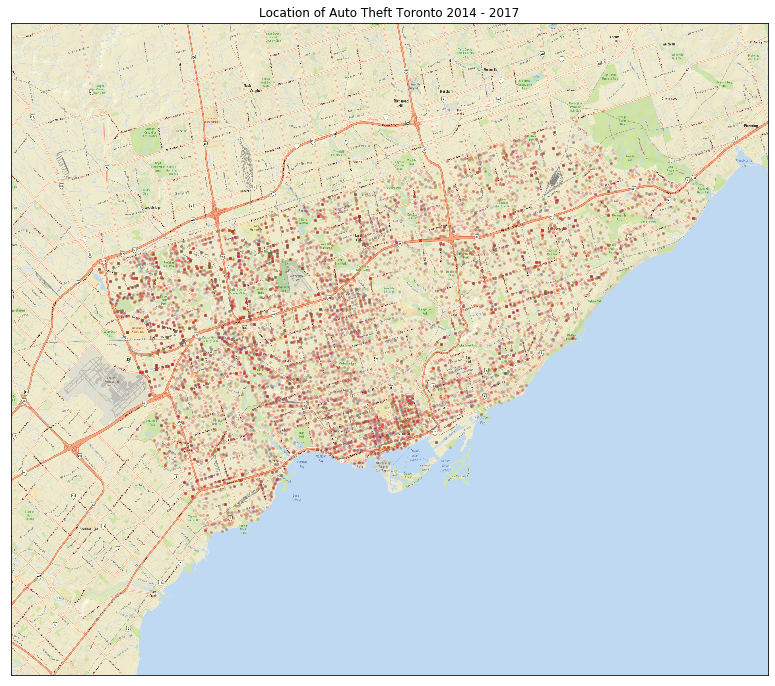

In [39]:
#Auto Theft Loc
plt.figure(figsize=(15,12))

Long = [-79.71,-79.07] # Longitude Range
Lat = [43.5,43.9] # Latitude Range

# Create basemap map
my_map = Basemap(
    epsg=3395,
    projection='merc',
    resolution='i',
    area_thresh = 100,
    llcrnrlon = Long[0],     # Lower latitude
    urcrnrlon = Long[1],     # Upper longitude
    llcrnrlat = Lat[0],      # Lower latitude
    urcrnrlat = Lat[1]       # Upper latitude
)

# Basemap map drawing parameters
#my_map.drawcoastlines()
#my_map.drawcountries()
#my_map.drawmapboundary()
#my_map.drawstates()
#my_map.drawrivers()
#my_map.fillcontinents(color='green',alpha=0.3)
#my_map.shadedrelief()
my_map.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels=12000, verbose=False)

my_lats = loc_AT_lats
my_longs = loc_AT_longs


X,Y = my_map(my_longs, my_lats)
# Draw weather stations on map:
for (x,y) in zip(X,Y):
    my_map.plot(x,y,
                markerfacecolor=([1,0,0]),
                marker = 'o',
                markersize = 2,
                alpha = 0.2)
plt.title('Location of Auto Theft Toronto 2014 - 2017')

# Theft Over basemap

C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  app.launch_new_instance()


Text(0.5, 1.0, 'Location of Theft Over Toronto 2014 - 2017')

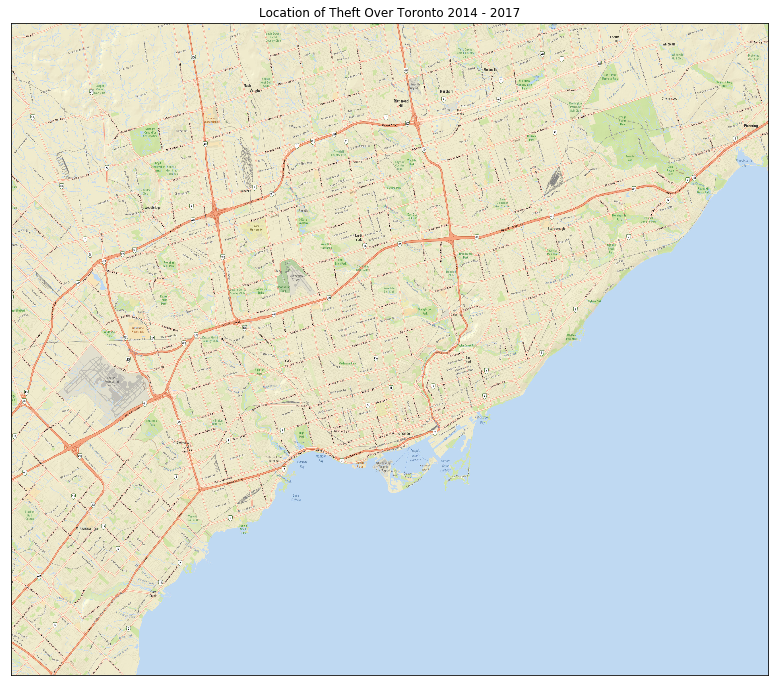

In [15]:
#Theft Over Loc
plt.figure(figsize=(15,12))

Long = [-79.71,-79.07] # Longitude Range
Lat = [43.5,43.9] # Latitude Range

# Create basemap map
my_map = Basemap(
    epsg=3395,
    projection='merc',
    resolution='i',
    area_thresh = 100,
    llcrnrlon = Long[0],     # Lower latitude
    urcrnrlon = Long[1],     # Upper longitude
    llcrnrlat = Lat[0],      # Lower latitude
    urcrnrlat = Lat[1]       # Upper latitude
)

# Basemap map drawing parameters
#my_map.drawcoastlines()
#my_map.drawcountries()
#my_map.drawmapboundary()
#my_map.drawstates()
#my_map.drawrivers()
#my_map.fillcontinents(color='green',alpha=0.3)
#my_map.shadedrelief()
my_map.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels=12000, verbose=False)

my_lats = loc_TO_lats
my_longs = loc_TO_longs


X,Y = my_map(my_longs, my_lats)
# Draw weather stations on map:
for (x,y) in zip(X,Y):
    my_map.plot(x,y,
                markerfacecolor=([1,0,0]),
                marker = 'o',
                markersize = 2,
                alpha = 0.2)
plt.title('Location of Theft Over Toronto 2014 - 2017')

# Break and Enter

C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  app.launch_new_instance()


Text(0.5, 1.0, 'Location of Break and Enter Toronto 2014 - 2017')

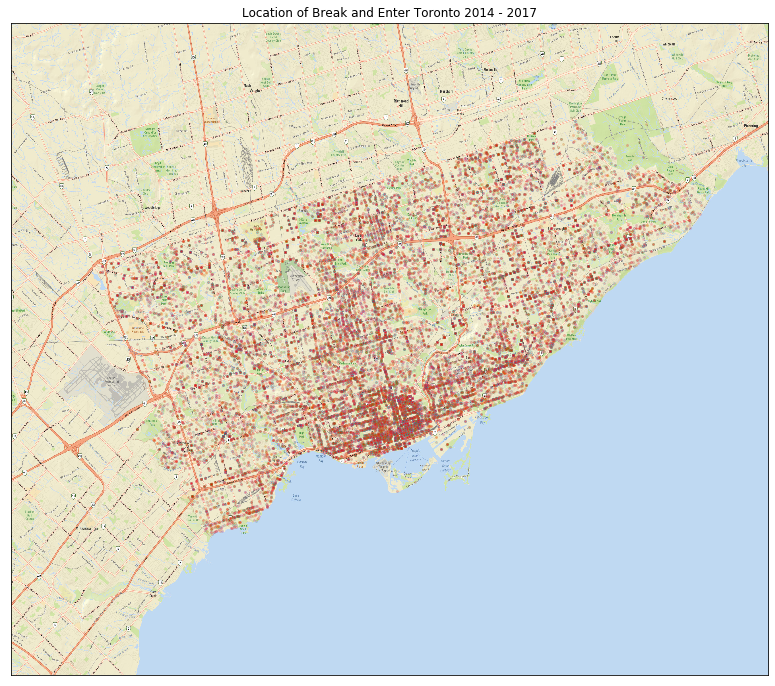

In [41]:
#Theft Over Loc
plt.figure(figsize=(15,12))

Long = [-79.71,-79.07] # Longitude Range
Lat = [43.5,43.9] # Latitude Range

# Create basemap map
my_map = Basemap(
    epsg=3395,
    projection='merc',
    resolution='i',
    area_thresh = 100,
    llcrnrlon = Long[0],     # Lower latitude
    urcrnrlon = Long[1],     # Upper longitude
    llcrnrlat = Lat[0],      # Lower latitude
    urcrnrlat = Lat[1]       # Upper latitude
)

# Basemap map drawing parameters
#my_map.drawcoastlines()
#my_map.drawcountries()
#my_map.drawmapboundary()
#my_map.drawstates()
#my_map.drawrivers()
#my_map.fillcontinents(color='green',alpha=0.3)
#my_map.shadedrelief()
my_map.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels=12000, verbose=False)

my_lats = loc_B_E_lats
my_longs = loc_B_E_longs


X,Y = my_map(my_longs, my_lats)
# Draw weather stations on map:
for (x,y) in zip(X,Y):
    my_map.plot(x,y,
                markerfacecolor=([1,0,0]),
                marker = 'o',
                markersize = 2,
                alpha = 0.2)
plt.title('Location of Break and Enter Toronto 2014 - 2017')

# Robbery

C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  app.launch_new_instance()


Text(0.5, 1.0, 'Location of Robbery Toronto 2014 - 2017')

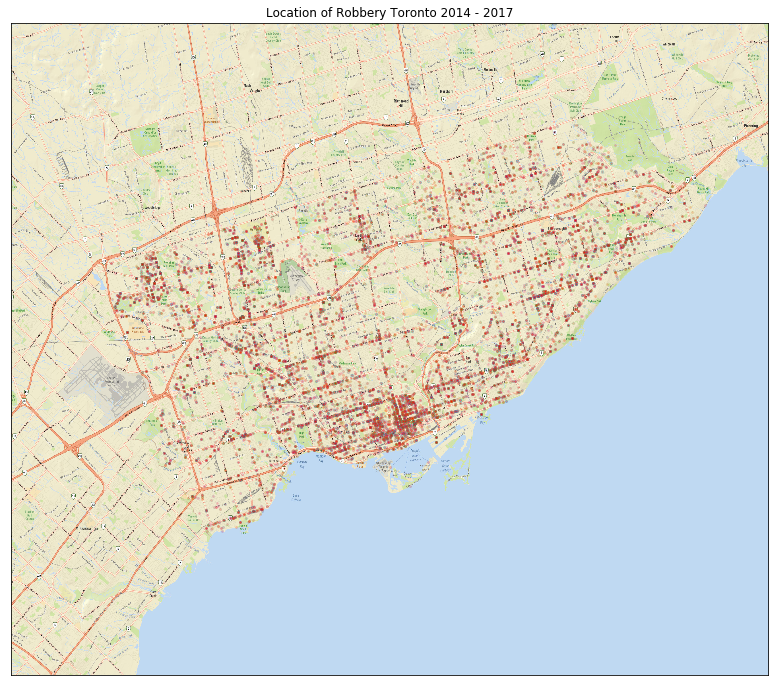

In [42]:
#Robbery Loc
plt.figure(figsize=(15,12))

Long = [-79.71,-79.07] # Longitude Range
Lat = [43.5,43.9] # Latitude Range

# Create basemap map
my_map = Basemap(
    epsg=3395,
    projection='merc',
    resolution='i',
    area_thresh = 100,
    llcrnrlon = Long[0],     # Lower latitude
    urcrnrlon = Long[1],     # Upper longitude
    llcrnrlat = Lat[0],      # Lower latitude
    urcrnrlat = Lat[1]       # Upper latitude
)

# Basemap map drawing parameters
#my_map.drawcoastlines()
#my_map.drawcountries()
#my_map.drawmapboundary()
#my_map.drawstates()
#my_map.drawrivers()
#my_map.fillcontinents(color='green',alpha=0.3)
#my_map.shadedrelief()
my_map.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels=12000, verbose=False)

my_lats = loc_Robbery_lats
my_longs = loc_Robbery_longs

X,Y = my_map(my_longs, my_lats)
# Draw weather stations on map:
for (x,y) in zip(X,Y):
    my_map.plot(x,y,
                markerfacecolor=([1,0,0]),
                marker = 'o',
                markersize = 2,
                alpha = 0.2)
plt.title('Location of Robbery Toronto 2014 - 2017')

# Assault

C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  app.launch_new_instance()


Text(0.5, 1.0, 'Location of Assault Toronto 2014 - 2017')

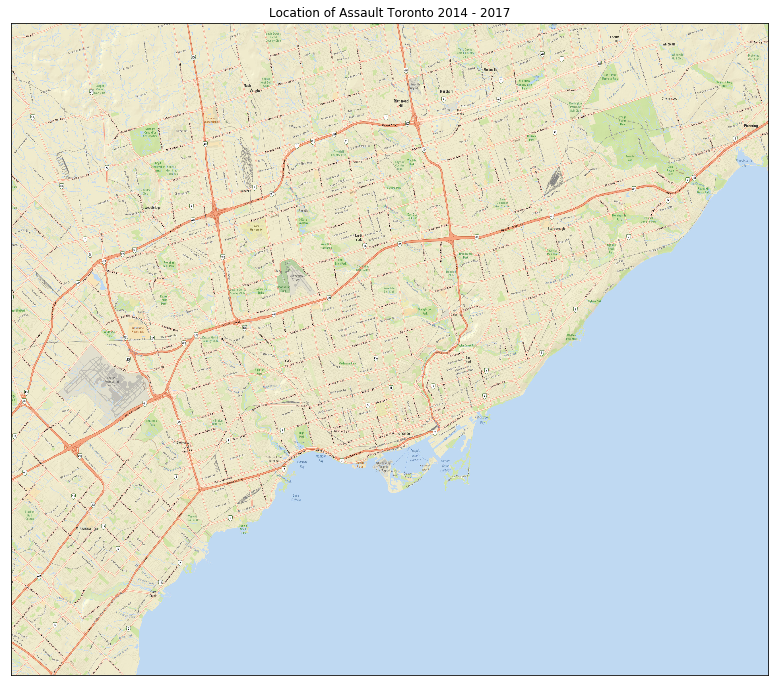

In [16]:
#Assault Loc
plt.figure(figsize=(15,12))

Long = [-79.71,-79.07] # Longitude Range
Lat = [43.5,43.9] # Latitude Range

# Create basemap map
my_map = Basemap(
    epsg=3395,
    projection='merc',
    resolution='i',
    area_thresh = 100,
    llcrnrlon = Long[0],     # Lower latitude
    urcrnrlon = Long[1],     # Upper longitude
    llcrnrlat = Lat[0],      # Lower latitude
    urcrnrlat = Lat[1]       # Upper latitude
)

# Basemap map drawing parameters
#my_map.drawcoastlines()
#my_map.drawcountries()
#my_map.drawmapboundary()
#my_map.drawstates()
#my_map.drawrivers()
#my_map.fillcontinents(color='green',alpha=0.3)
#my_map.shadedrelief()
my_map.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels=12000, verbose=False)

my_lats = loc_Assault_lats
my_longs = loc_Assault_longs

X,Y = my_map(my_longs, my_lats)
# Draw weather stations on map:
for (x,y) in zip(X,Y):
    my_map.plot(x,y,
                markerfacecolor=([1,0,0]),
                marker = 'o',
                markersize = 2,
                alpha = 0.2)
plt.title('Location of Assault Toronto 2014 - 2017')

In [ ]:
plt.figure(figsize=(15,12))

Long = [-79.71,-79.07] # Longitude Range
Lat = [43.5,43.9] # Latitude Range

# Create basemap map
my_map = Basemap(
    epsg=3395,
    projection='merc',
    resolution='i',
    area_thresh = 100,
    llcrnrlon = Long[0],     # Lower latitude
    urcrnrlon = Long[1],     # Upper longitude
    llcrnrlat = Lat[0],      # Lower latitude
    urcrnrlat = Lat[1]       # Upper latitude
)

# Basemap map drawing parameters
#my_map.drawcoastlines()
#my_map.drawcountries()
#my_map.drawmapboundary()
#my_map.drawstates()
#my_map.drawrivers()
#my_map.fillcontinents(color='green',alpha=0.3)
#my_map.shadedrelief()
my_map.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels=12000, verbose=False)

my_lats = list(MCI_raw.Lat)
my_longs = list(MCI_raw.Long)


X,Y = my_map(my_longs, my_lats)
# Draw weather stations on map:
for (x,y) in zip(X,Y):
    my_map.plot(x,y,
                markerfacecolor=([1,0,0]),
                marker = 'o',
                markersize = 2,
                alpha = 0.2)
plt.title('Location of Major Crime Indicator Toronto 2014 - 2017')

In [14]:
import pandas as pd

In [15]:
pd.__version__

'0.24.2'

In [13]:
from pandas.util._decorators import cache_readonly

In [136]:
try:
    import csv
    import numpy as np
    import pandas as pd
    # Plotting
    import matplotlib.pyplot as plt
    from matplotlib.pyplot import subplots, figure, show
    from matplotlib import pyplot, pylab

    import seaborn as sns
    %matplotlib inline
    import folium
    from folium.plugins.measure_control import MeasureControl
    #data processing
    from collections import Counter
    from pandas.core.dtypes.dtypes import CategoricalDtype
    import random
    import os
    import folium
    import json
    from folium.plugins import HeatMap
    #defalut font size
    plt.rcParams.update({'font.size': 12})
    from folium.plugins import MarkerCluster
    # from folium.element import IFrame
    import unicodedata
except:
    !pip install numpy
    !pip install pandas
    !pip install matplotlib -U
    !pip install seaborn
    !pip install cufflinks
    !pip install --upgrade pip
    !pip install folium
    !pip install geopandas
    

In [13]:
#figure property setup
sns.set_style("whitegrid")
# plt.style.use('classic')
# sns.set(style='ticks') 

In [14]:
#MCI - major crime indicator
MCI_raw = pd.read_csv("MCI_2014_to_2017.csv", sep = ",")

In [15]:
#drop useless columns
MCI = MCI_raw.drop(['X','Y','premisetype','offence','event_unique_id','occurrencedate','Index_',
                    'reportedyear','reportedmonth','reportedday',
                    'reporteddayofyear','reporteddayofweek','reportedhour',
                    'reporteddate','ucr_code','ucr_ext','occurrenceday','Hood_ID','FID'],
                   axis=1)
#delete entries with any missing values
MCI = MCI.dropna()
MCI = MCI.drop(MCI[MCI.occurrenceyear < 2014].index)
#need relations b/t "day hour month" & counts
#transfer float into integer
MCI["occurrenceyear"] = MCI.occurrenceyear.astype(int)
MCI["occurrencedayofyear"] = MCI.occurrencedayofyear.astype(int)
# MCI["occurrencehour"] = MCI.occurrencehour.astype(int)

In [16]:
MCI.head()

,occurrenceyear,occurrencemonth,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Neighbourhood,Lat,Long
0,2014,August,237,Monday,18,Assault,D31,Black Creek (24),43.768829,-79.520401
1,2014,August,237,Monday,9,Break and Enter,D22,Eringate-Centennial-West Deane (11),43.642574,-79.580856
2,2014,August,237,Monday,11,Assault,D41,Bendale (127),43.762909,-79.260445
3,2014,August,237,Monday,17,Break and Enter,D51,Cabbagetown-South St.James Town (71),43.663208,-79.367546
4,2014,August,237,Monday,16,Break and Enter,D43,Woburn (137),43.776440,-79.231758


In [17]:
MCI.shape

(130167, 10)

In [18]:
df.shape

(131073, 29)

In [19]:
df.isnull().all().all() #Count plot -- # Total Occurrence based on MCICount plot -- # Total Occurrence based on MCICount plot -- # Total Occurrence based on MCI)

False

In [20]:
df.isnull().sum().sum()


200

# Count plot -- # Total Occurrence based on MCI

In [21]:
MCI1 = pd.DataFrame()
MCI1["Occurrenceyear"] = MCI["occurrenceyear"].unique()

In [22]:
MCI1.shape

(4, 1)

In [23]:
MCI1["EventsOccurence"] = list(MCI.groupby("occurrenceyear")["occurrenceyear"].count())

In [24]:
MCI1

,Occurrenceyear,EventsOccurence
0,2014,31578
1,2015,32197
2,2016,32601
3,2017,33791


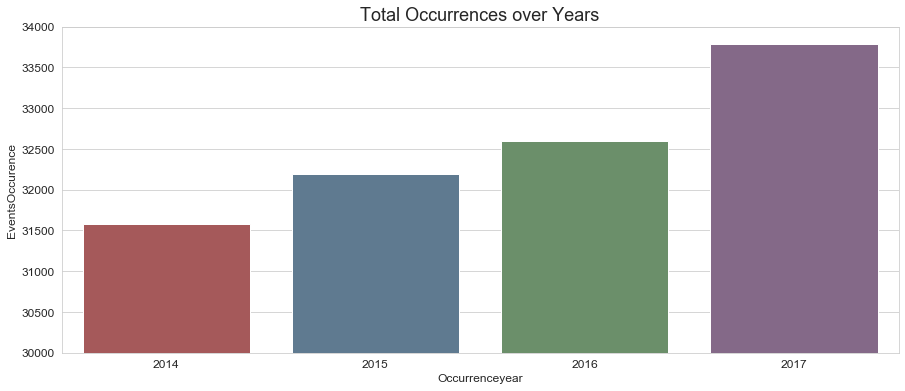

In [38]:
plt.subplots(figsize=(15, 6))
fig_MCI1 = sns.barplot(x="Occurrenceyear", y="EventsOccurence", data=MCI1, palette=sns.color_palette("Set1", n_colors=8, desat=.5))
fig_MCI1 = fig_MCI1.set_title("Total Occurrences over Years", fontsize = 18)
plt.ylim(30000, 34000)
plt.savefig('Total Crimes.pdf',bbox_inches = 'tight')

## Count plot -- # occurences over years/months/dayOfwk/hours based on MCI

In [25]:
MCI2 = pd.DataFrame()
MCI2["OccurrenceYear"] = MCI["occurrenceyear"]
MCI2["OccurrenceMonth"] = MCI["occurrencemonth"]
MCI2["OccurrenceHour"] = MCI["occurrencehour"]
MCI2["OccurrenceDayOfWk"] = MCI["occurrencedayofweek"]
MCI2["MCI"] = MCI["MCI"]

In [26]:
MCI2.head()

,OccurrenceYear,OccurrenceMonth,OccurrenceHour,OccurrenceDayOfWk,MCI
0,2014,August,18,Monday,Assault
1,2014,August,9,Monday,Break and Enter
2,2014,August,11,Monday,Assault
3,2014,August,17,Monday,Break and Enter
4,2014,August,16,Monday,Break and Enter


In [27]:
MCI2["EventsHappened"] = [1]*len(MCI)

In [28]:
MCI2.head()

,OccurrenceYear,OccurrenceMonth,OccurrenceHour,OccurrenceDayOfWk,MCI,EventsHappened
0,2014,August,18,Monday,Assault,1
1,2014,August,9,Monday,Break and Enter,1
2,2014,August,11,Monday,Assault,1
3,2014,August,17,Monday,Break and Enter,1
4,2014,August,16,Monday,Break and Enter,1


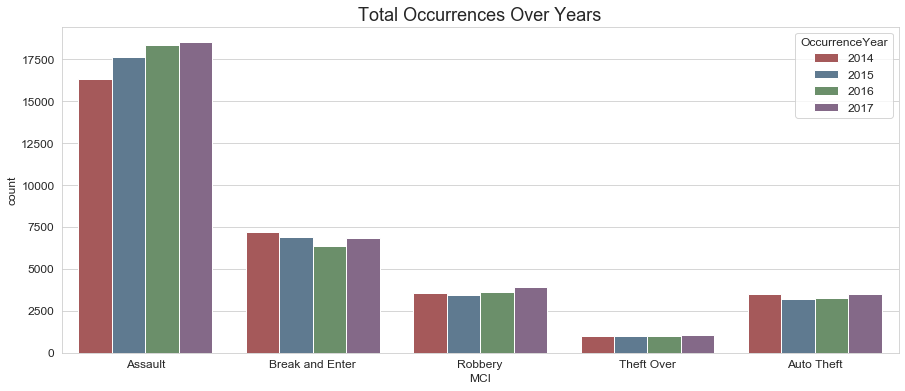

In [50]:
plt.subplots(figsize=(15, 6))
plot2_1 = sns.set_color_codes("pastel")
plot2_1 = sns.countplot(x="MCI", hue="OccurrenceYear", data=MCI2, palette=sns.color_palette("Set1", n_colors=8, desat=.5))
plot2_1 = plot2_1.set_title("Total Occurrences Over Years", fontsize = 18)
plt.savefig('Crimes Over Years.pdf',bbox_inches = 'tight')

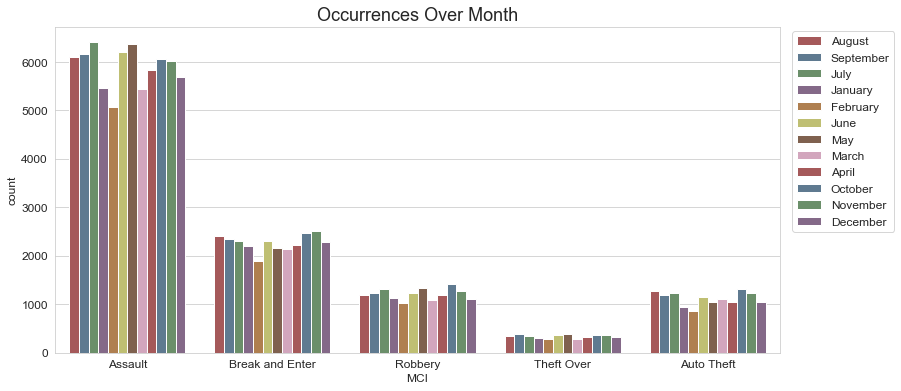

In [51]:
plt.subplots(figsize=(13, 6))
plot2_2 = sns.set_color_codes("pastel")
plot2_2 = sns.countplot(x="MCI", hue="OccurrenceMonth", data=MCI2, palette=sns.color_palette("Set1", n_colors=8, desat=.5))

plot2_2 = plot2_2.set_title("Occurrences Over Month", fontsize = 18)
plot2_2 = plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.4)
plt.savefig('Occurrences Over Months.pdf', bbox_inches = 'tight')

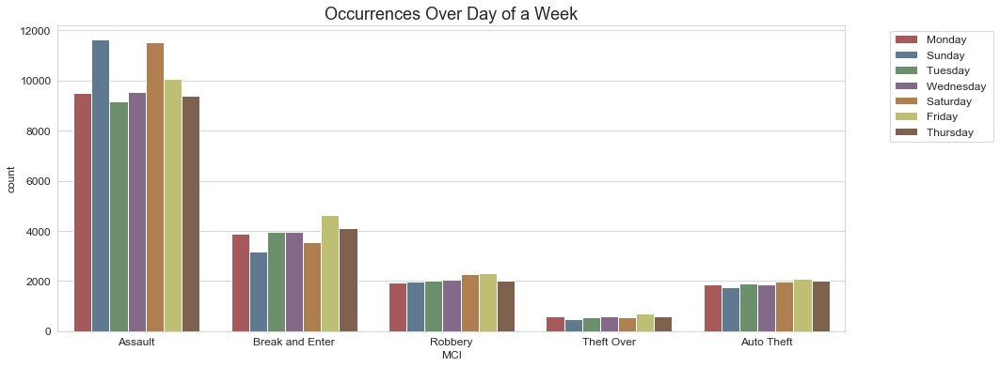

In [52]:
plt.subplots(figsize=(15, 6))
plot2_3 = sns.set_color_codes("pastel")
plot2_3 = sns.countplot(x="MCI", hue="OccurrenceDayOfWk", data=MCI2, palette=sns.color_palette("Set1", n_colors=8, desat=.5))
plot2_3 = plot2_3.set_title("Occurrences Over Day of a Week", fontsize = 18)
plot2_3 = plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.5)
plt.savefig('Occurrences Over Day of a Week.pdf', bbox_inches = 'tight')

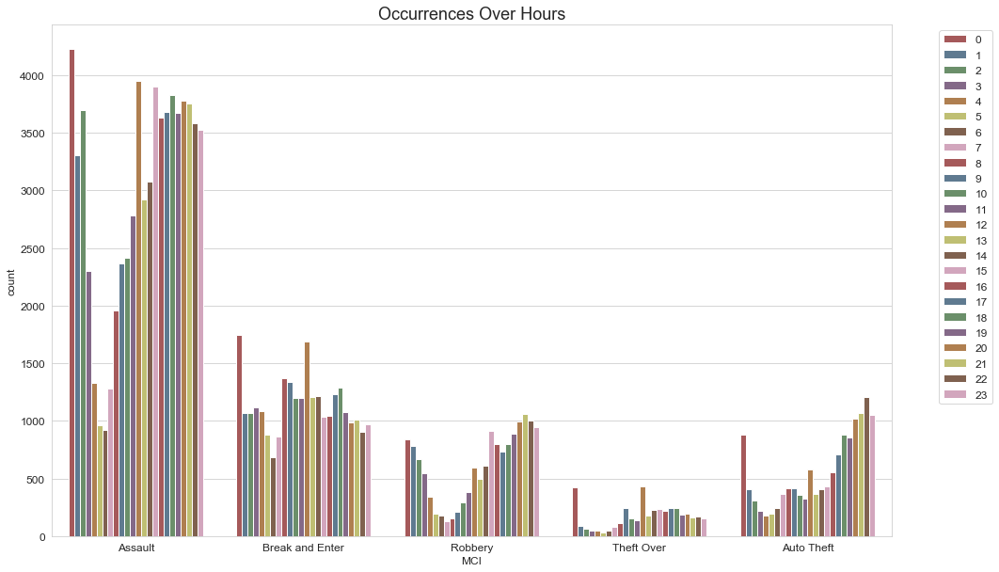

In [53]:
plt.subplots(figsize=(16, 10))
plot2_3 = sns.set_color_codes("pastel")
plot2_3 = sns.countplot(x="MCI", hue="OccurrenceHour", data=MCI2, palette=sns.color_palette("Set1", n_colors=8, desat=.5))
plot2_3 = plot2_3.set_title("Occurrences Over Hours", fontsize = 18)
plot2_3 = plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.5)
plt.savefig('Occurrences Over Hours.pdf', bbox_inches = 'tight')

## Count Plot -- #occurences over years based on neighbourhood

In [29]:
MCI3 = pd.DataFrame()
# MCI3["YearOfOccurence"] = MCI["reportedyear"]
MCI3["Neighbourhood"] = MCI["Neighbourhood"]
MCI3["Lat"] = MCI["Lat"]
MCI3["Long"] = MCI["Long"]
MCI3["EventsHappened"] = [1]*len(MCI)
MCI3.head()

,Neighbourhood,Lat,Long,EventsHappened
0,Black Creek (24),43.768829,-79.520401,1
1,Eringate-Centennial-West Deane (11),43.642574,-79.580856,1
2,Bendale (127),43.762909,-79.260445,1
3,Cabbagetown-South St.James Town (71),43.663208,-79.367546,1
4,Woburn (137),43.776440,-79.231758,1


In [30]:
MCI3.shape

(130167, 4)

In [31]:
MCI3plot = MCI3.groupby(["Neighbourhood","Lat","Long"]).count()
MCI3plot.head()

EventsHappened
Neighbourhood         Lat       Long                      
Agincourt North (129) 43.790581 -79.269959               2
                      43.793114 -79.271034               3
                      43.795204 -79.264580               8
                      43.796127 -79.261513               1
                      43.797062 -79.283440               3

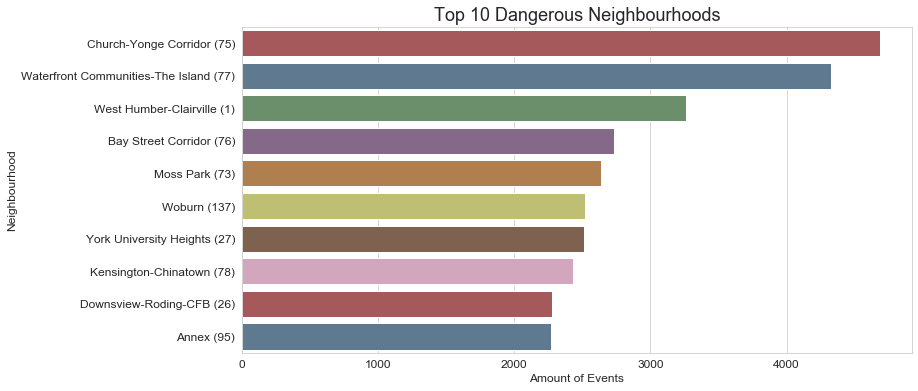

In [32]:
NNeighbourhood_counts = plt.figure(figsize = (12, 6))
Neighbourhood_counts = sns.countplot(y= 'Neighbourhood', data = MCI, 
              order = MCI['Neighbourhood'].value_counts().iloc[:10].index, palette=sns.color_palette("Set1", n_colors=8, desat=.5))
Neighbourhood_counts.set_title("Top 10 Dangerous Neighbourhoods", fontsize = 18)
Neighbourhood_counts = plt.xlabel("Amount of Events", fontsize = 12)
Neighbourhood_counts = plt.ylabel("Neighbourhood", fontsize = 12)
plt.savefig("Top10DangerousNeighbourhood.pdf", bbox_inches = 'tight')

### Heatmap Plots

In [33]:
MCI2_1 = pd.DataFrame()
MCI2_1["occurrenceyear"] = MCI["occurrenceyear"]
MCI2_1["MCI"] = MCI["MCI"]
MCI2_1["occurrencedayofweek"] = MCI["occurrencedayofweek"]
MCI2_1["EventsHappened"] = len(MCI)

In [34]:
MCI2_1.head()

,occurrenceyear,MCI,occurrencedayofweek,EventsHappened
0,2014,Assault,Monday,130167
1,2014,Break and Enter,Monday,130167
2,2014,Assault,Monday,130167
3,2014,Break and Enter,Monday,130167
4,2014,Break and Enter,Monday,130167


In [35]:
MCI2_1plot = MCI2_1.groupby(["occurrenceyear", "MCI", "occurrencedayofweek"]).count()
MCI2_1plot.head()

EventsHappened
occurrenceyear MCI     occurrencedayofweek                
2014           Assault Friday                         2189
                       Monday                         2156
                       Saturday                       2702
                       Sunday                         2643
                       Thursday                       2167

In [36]:
MCI2_1plot.tail()

EventsHappened
occurrenceyear MCI        occurrencedayofweek                
2017           Theft Over Saturday                        171
                          Sunday                          137
                          Thursday                        167
                          Tuesday                         148
                          Wednesday                       146

In [37]:
MCIlabel = list(MCI2_1plot.index.levels[1])
type(MCIlabel)

list

In [41]:
MCIlabel

['Assault', 'Auto Theft', 'Break and Enter', 'Robbery', 'Theft Over']

In [43]:
dayofwk

['Friday    ',
 'Monday    ',
 'Saturday  ',
 'Sunday    ',
 'Thursday  ',
 'Tuesday   ',
 'Wednesday ']

In [45]:
MCIlabel = list(MCI2_1plot.index.levels[1])
dayofwk = list(MCI2_1plot.index.levels[2])
MCI2_2plot = MCI2_1.groupby(["MCI", "occurrencedayofweek"]).count()
count_all = np.reshape(list(MCI2_2plot["EventsHappened"]),(5,7))
count_all[1]

array([2075, 1876, 1976, 1751, 2002, 1892, 1863])

In [46]:
count_all.shape

(5, 7)

In [47]:
count_all


array([[10051,  9519, 11539, 11628,  9375,  9180,  9525],
       [ 2075,  1876,  1976,  1751,  2002,  1892,  1863],
       [ 4640,  3893,  3542,  3159,  4126,  3952,  3957],
       [ 2298,  1926,  2265,  1990,  2007,  2013,  2050],
       [  710,   607,   536,   476,   603,   572,   593]])

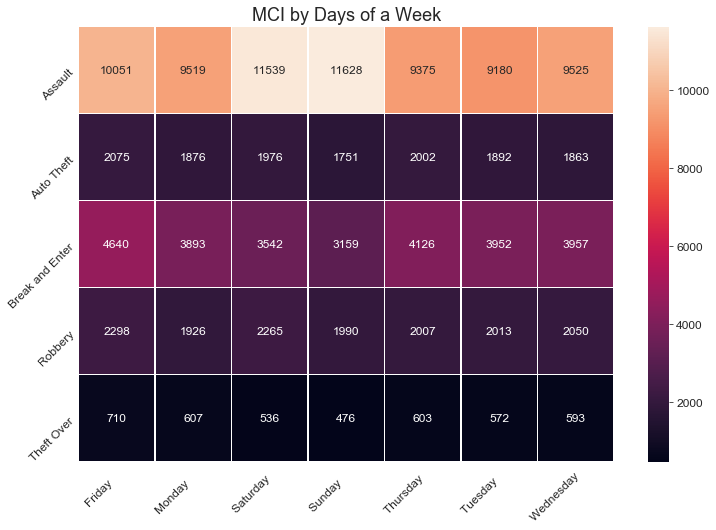

In [48]:
plt.subplots(figsize=(12, 8))
MCIall = sns.heatmap(count_all, annot=True, fmt="d" , linewidths=.5)
#label them with the respective list entries
MCIall.set_xticklabels(dayofwk)
MCIall.set_yticklabels(MCIlabel)
# Rotate the tick labels and set their alignment.
plt.setp(MCIall.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.setp(MCIall.get_yticklabels(), rotation=45, ha="right", rotation_mode="anchor")
MCIall = MCIall.set_title("MCI by Days of a Week",fontsize=18)
plt.savefig('MCI By DayofWk total.pdf', bbox_inches = 'tight')

In [49]:
MCIlabel = list(MCI2_1plot.index.levels[1])
dayofwk = list(MCI2_1plot.index.levels[2])
count_2014 = np.reshape(list(MCI2_1plot.loc[[2014]]["EventsHappened"]),(5,7))

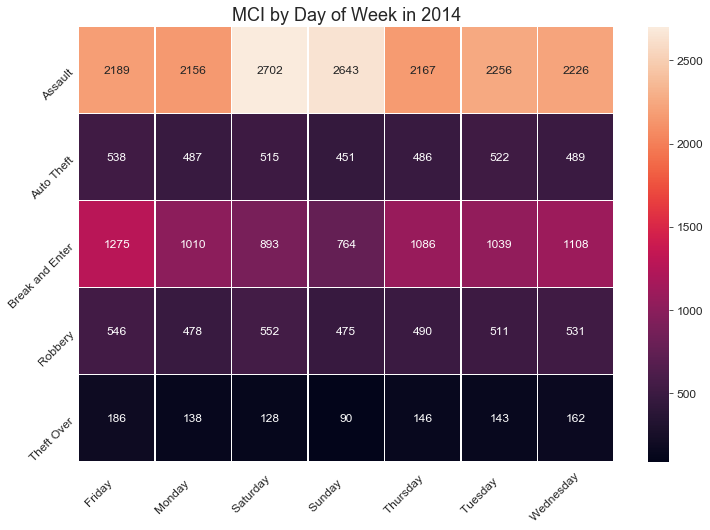

In [50]:
plt.subplots(figsize=(12, 8))
MCI2014 = sns.heatmap(count_2014, annot=True, fmt="d" , linewidths=.5)
#label them with the respective list entries
MCI2014.set_xticklabels(dayofwk)
MCI2014.set_yticklabels(MCIlabel)
# Rotate the tick labels and set their alignment.
plt.setp(MCI2014.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.setp(MCI2014.get_yticklabels(), rotation=45, ha="right", rotation_mode="anchor")
MCI2014 = MCI2014.set_title("MCI by Day of Week in 2014",fontsize=18)
plt.savefig('MCI By DayofWk 2014.pdf', bbox_inches = 'tight')

In [51]:
MCIlabel = list(MCI2_1plot.index.levels[1])
dayofwk = list(MCI2_1plot.index.levels[2])
count_2015 = np.reshape(list(MCI2_1plot.loc[[2015]]["EventsHappened"]),(5,7))

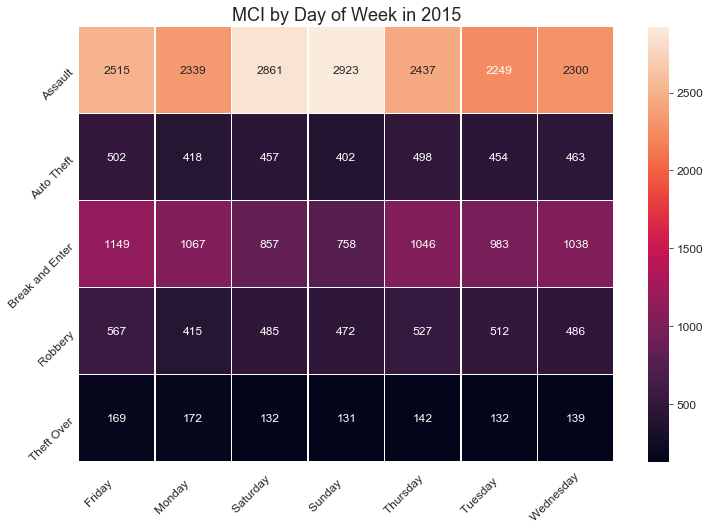

In [52]:
plt.subplots(figsize=(12, 8))
MCI2015 = sns.heatmap(count_2015, annot=True, fmt="d" , linewidths=.5)
#label them with the respective list entries
MCI2015.set_xticklabels(dayofwk)
MCI2015.set_yticklabels(MCIlabel)
# Rotate the tick labels and set their alignment.
plt.setp(MCI2015.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.setp(MCI2015.get_yticklabels(), rotation=45, ha="right", rotation_mode="anchor")
MCI2015 = MCI2015.set_title("MCI by Day of Week in 2015",fontsize=18)
plt.savefig('MCI By DayofWk 2015.pdf', bbox_inches = 'tight')

In [53]:
MCIlabel = list(MCI2_1plot.index.levels[1])
dayofwk = list(MCI2_1plot.index.levels[2])
count_2016 = np.reshape(list(MCI2_1plot.loc[[2016]]["EventsHappened"]),(5,7))

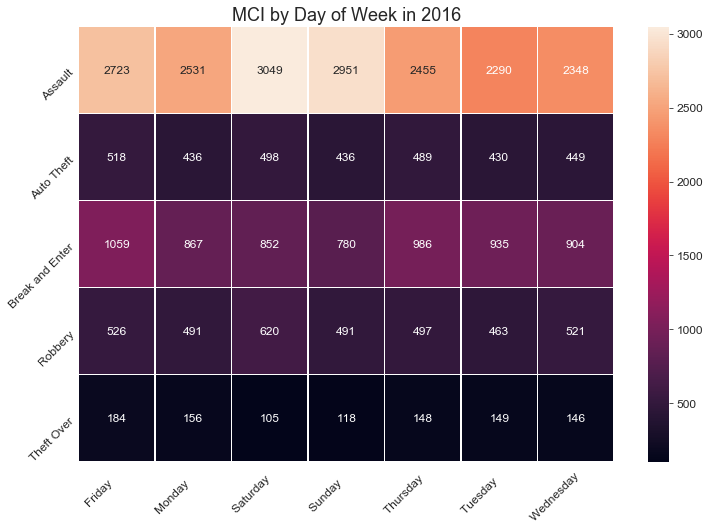

In [54]:
plt.subplots(figsize=(12, 8))
MCI2016 = sns.heatmap(count_2016, annot=True, fmt="d" , linewidths=.5)
#label them with the respective list entries
MCI2016.set_xticklabels(dayofwk)
MCI2016.set_yticklabels(MCIlabel)
# Rotate the tick labels and set their alignment.
plt.setp(MCI2016.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.setp(MCI2016.get_yticklabels(), rotation=45, ha="right", rotation_mode="anchor")
MCI2016 = MCI2016.set_title("MCI by Day of Week in 2016",fontsize=18)
plt.savefig('MCI By DayofWk 2016.pdf', bbox_inches = 'tight')

In [55]:
MCIlabel = list(MCI2_1plot.index.levels[1])
dayofwk = list(MCI2_1plot.index.levels[2])
count_2017 = np.reshape(list(MCI2_1plot.loc[[2017]]["EventsHappened"]),(5,7))

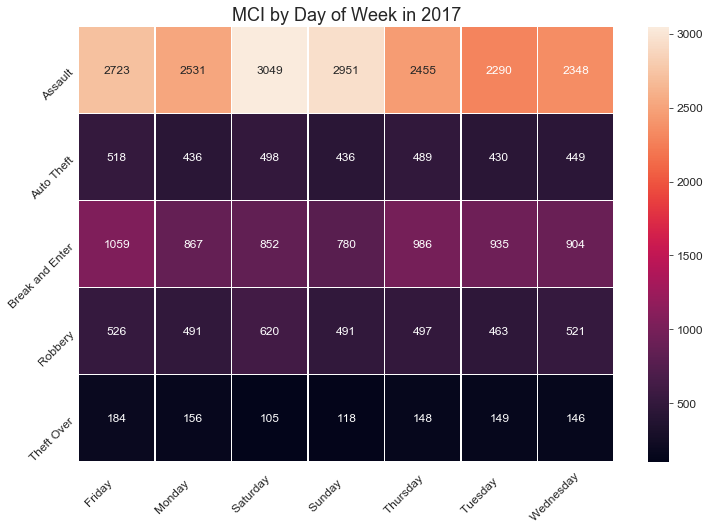

In [56]:
plt.subplots(figsize=(12, 8))
MCI2017 = sns.heatmap(count_2016, annot=True, fmt="d" , linewidths=.5)
#label them with the respective list entries
MCI2017.set_xticklabels(dayofwk)
MCI2017.set_yticklabels(MCIlabel)
# Rotate the tick labels and set their alignment.
plt.setp(MCI2017.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.setp(MCI2017.get_yticklabels(), rotation=45, ha="right", rotation_mode="anchor")
MCI2017 = MCI2017.set_title("MCI by Day of Week in 2017",fontsize=18)
plt.savefig('MCI By DayofWk 2017.pdf', bbox_inches = 'tight')

### Trend Plots

In [57]:
MCI_raw = pd.read_csv("MCI_2014_to_2017.csv", sep = ",")

In [59]:
#MCI_raw.occurrencehour.head()
#len(list(MCI_raw.occurrencehour))

In [61]:
MCI_raw.MCI.unique()

array(['Assault', 'Break and Enter', 'Robbery', 'Theft Over',
       'Auto Theft'], dtype=object)

In [63]:
MCI_raw.head(2)

,X,Y,Index_,event_unique_id,occurrencedate,reporteddate,premisetype,ucr_code,ucr_ext,offence,...,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Hood_ID,Neighbourhood,Lat,Long,FID
0,-79.520401,43.768829,14601,GO-20142775022,2014-08-25T04:00:00.000Z,2014-08-25T04:00:00.000Z,Outside,1430,100,Assault,...,237.0,Monday,18,Assault,D31,24,Black Creek (24),43.768829,-79.520401,14001
1,-79.580856,43.642574,14602,GO-20142870874,2014-08-25T04:00:00.000Z,2014-09-08T04:00:00.000Z,House,2120,220,B&E W'Intent,...,237.0,Monday,9,Break and Enter,D22,11,Eringate-Centennial-West Deane (11),43.642574,-79.580856,14002


In [64]:
time_occur_dict = {}
for i in MCI_raw.occurrencehour:
    if i not in time_occur_dict:
        time_occur_dict[i] = 1
    else:
        time_occur_dict[i] += 1

In [65]:
MCI_raw.occurrencehour.head()

0    18
1     9
2    11
3    17
4    16
Name: occurrencehour, dtype: int64

In [69]:
time_occur_dict

{18: 7064,
 9: 4620,
 11: 4830,
 17: 6611,
 16: 6264,
 21: 7076,
 20: 6989,
 19: 6690,
 3: 4233,
 10: 4441,
 8: 4041,
 5: 2262,
 2: 5811,
 13: 5196,
 15: 6542,
 0: 8495,
 7: 2740,
 23: 6664,
 12: 7356,
 22: 6869,
 6: 2078,
 14: 5553,
 4: 2985,
 1: 5663}

In [71]:
a = sorted(time_occur_dict.items())
a

[(0, 8495),
 (1, 5663),
 (2, 5811),
 (3, 4233),
 (4, 2985),
 (5, 2262),
 (6, 2078),
 (7, 2740),
 (8, 4041),
 (9, 4620),
 (10, 4441),
 (11, 4830),
 (12, 7356),
 (13, 5196),
 (14, 5553),
 (15, 6542),
 (16, 6264),
 (17, 6611),
 (18, 7064),
 (19, 6690),
 (20, 6989),
 (21, 7076),
 (22, 6869),
 (23, 6664)]

In [72]:
hours = [w[0] for w in a]
occurrences = [w[1] for w in a]

Text(0.5, 1.0, 'Total Crime by Hour of Day in Toronto 2014 - 2017')

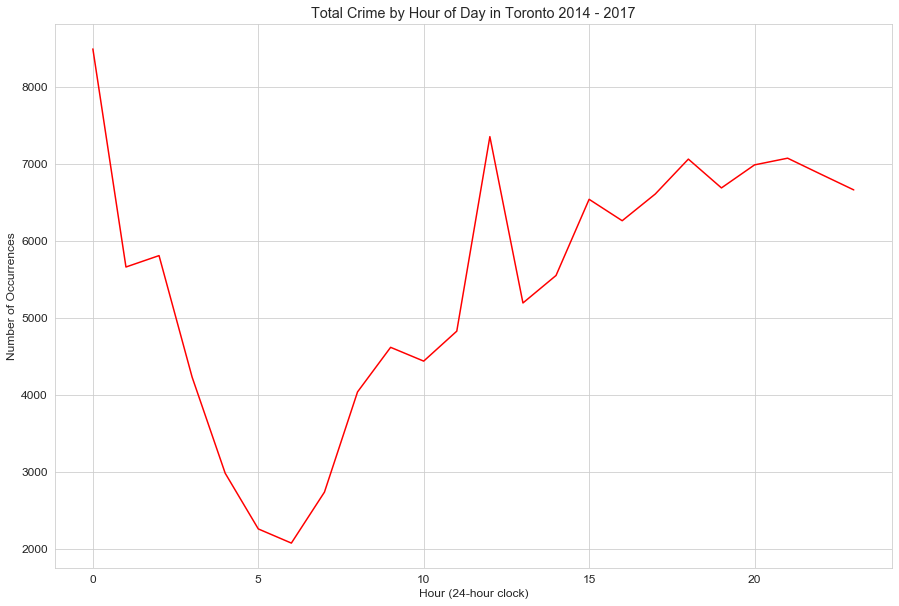

In [75]:
plt.figure(figsize=(15,10))
plt.plot(hours, occurrences,color='r')
plt.xlabel('Hour (24-hour clock)')
plt.ylabel('Number of Occurrences')
plt.title('Total Crime by Hour of Day in Toronto 2014 - 2017')

In [76]:
MCI_list_hours = list(zip(MCI_raw.MCI, MCI_raw.occurrencehour))
dic_Assault = {}
dic_B_E = {}
dic_Robbery = {}
dic_TO = {}
dic_AT = {}

In [77]:
for i in MCI_list_hours:
    if i[0] == 'Assault':
        if i[1] not in dic_Assault:
            dic_Assault[i[1]] = 1
        else:
            dic_Assault[i[1]] += 1 #
            
    elif i[0] == 'Break and Enter':
        if i[1] not in dic_B_E:
            dic_B_E[i[1]] = 1
        else:
            dic_B_E[i[1]] += 1 #
        
    elif i[0] == 'Robbery':
        if i[1] not in dic_Robbery:
            dic_Robbery[i[1]] = 1
        else:
            dic_Robbery[i[1]] += 1 #
        
    elif i[0] == 'Theft Over':
        if i[1] not in dic_TO:
            dic_TO[i[1]] = 1
        else:
            dic_TO[i[1]] += 1 #
        
    elif i[0] == 'Auto Theft':
        if i[1] not in dic_AT:
            dic_AT[i[1]] = 1
        else:
            dic_AT[i[1]] += 1 #

In [78]:
dic_Assault.get(0) + dic_B_E.get(0) + dic_Robbery.get(0) + dic_TO.get(0) + dic_AT.get(0)

8495

In [79]:
a = sorted(dic_Assault.items())
hours = [w[0] for w in a]
occurrences_a = [w[1] for w in a]

b = sorted(dic_B_E.items())
occurrences_b = [w[1] for w in b]

c = sorted(dic_Robbery.items())
occurrences_c = [w[1] for w in c]

d = sorted(dic_TO.items())
occurrences_d = [w[1] for w in d]

e = sorted(dic_AT.items())
occurrences_e = [w[1] for w in e]

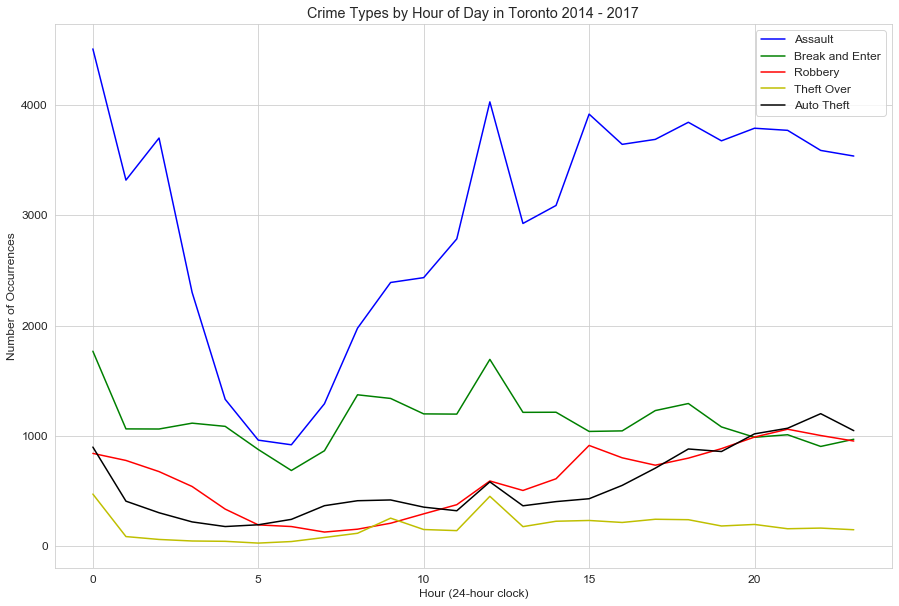

In [80]:
plt.figure(figsize=(15,10))
plt.plot(hours,occurrences_a,color='b',label='Assault')
plt.plot(hours,occurrences_b,color='g',label='Break and Enter')
plt.plot(hours,occurrences_c,color='r',label='Robbery')
plt.plot(hours,occurrences_d,color='y',label='Theft Over')
plt.plot(hours,occurrences_e,color='k',label='Auto Theft')
plt.xlabel('Hour (24-hour clock)')
plt.ylabel('Number of Occurrences')
plt.title('Crime Types by Hour of Day in Toronto 2014 - 2017')
plt.legend(loc='upper right')

In [81]:
MCI.columns

Index(['occurrenceyear', 'occurrencemonth', 'occurrencedayofyear',
       'occurrencedayofweek', 'occurrencehour', 'MCI', 'Division',
       'Neighbourhood', 'Lat', 'Long'],
      dtype='object')

In [82]:
MCI.shape

(130167, 10)

In [83]:
months = {"January":1,"February":2,"March":3,"April":4,
          "May":5,"June":6,"July":7,"August":8,
          "September":9,"October":10,"November":11,"December":12}

In [84]:
total = pd.DataFrame()
temp = []
total["month"] = MCI["occurrencemonth"]
total["year"] = MCI["occurrenceyear"]
total["counts"] = [1]*len(MCI)
total.head()
for i in range(len(total)):
    temp.append(months.get(total["month"].iloc[i]))

In [86]:
total.head()

,month,year,counts
0,August,2014,1
1,August,2014,1
2,August,2014,1
3,August,2014,1
4,August,2014,1


In [89]:
total["new_month"] = temp

In [88]:
total = total.sort_values(["new_month"])
total.head()

,month,year,counts,new_month
22225,January,2015,1,1
10367,January,2014,1,1
10368,January,2014,1,1
10369,January,2014,1,1
10370,January,2014,1,1


In [90]:
type(months)

dict

In [91]:
months.keys()

dict_keys(['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'])

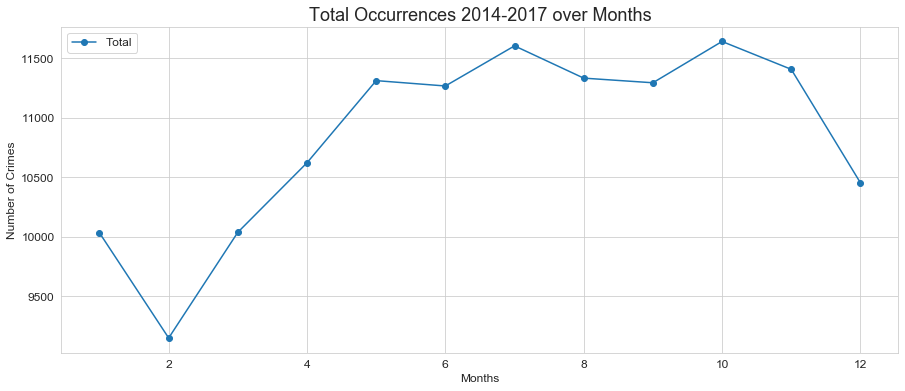

In [92]:
Ttotal = total.groupby("new_month")["counts"].count()
# Timeseries = total.groupby(["year", "new_month"])["counts"].count()
y, axs = plt.subplots(figsize=(15, 6))
y = plt.plot(Ttotal, marker = "o", label = "Total")
axs.set_xlabel("Months")
axs.set_ylabel("Number of Crimes")
axs.set_title("Total Occurrences 2014-2017 over Months", fontsize = 18)
plt.legend(loc="upper left")
# plt.xticks(np.arange(12), months)
plt.savefig("TotalOccurrenceOverMonths.pdf", bbox_inches = 'tight')

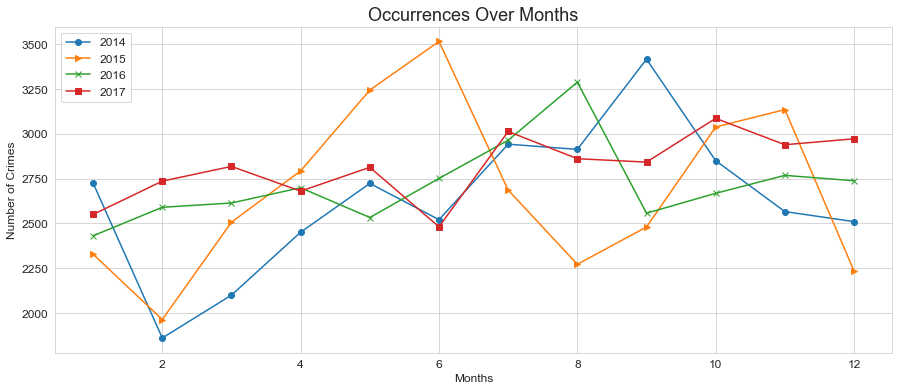

In [93]:
T2014 = total[total["year"] == 2014].groupby("new_month")["counts"].count()
T2015 = total[total["year"] == 2015].groupby("new_month")["counts"].count()
T2016 = total[total["year"] == 2016].groupby("new_month")["counts"].count()
T2017 = total[total["year"] == 2017].groupby("new_month")["counts"].count()

y, axs = plt.subplots(figsize=(15, 6))
y = plt.plot(T2014, marker = "o", label = "2014")
y = plt.plot(T2015, marker = ">", label = "2015")
y = plt.plot(T2016, marker = "x", label = "2016")
y = plt.plot(T2017, marker = "s", label = "2017")

axs.set_xlabel("Months")
axs.set_ylabel("Number of Crimes")
axs.set_title("Occurrences Over Months", fontsize = 18)
plt.legend(loc="upper left")
# plt.xticks(np.arange(12), months)
plt.savefig("OccurrencesOverMonths.pdf", bbox_inches = 'tight')

### Crime Map (Randomly chosen 5000 data points for each year)

In [94]:
def generate_crime_map(year):
    
    toronto_crime_map = folium.Map(location=[43.7001100, -79.4163000], zoom_start=10, tiles = "CartoDB dark_matter")
    Crime = MCI[MCI["occurrenceyear"] == year]
    locations = []
    for i in random.sample(range(len(Crime)), 5000):
        locations.append([Crime.iloc[i]["Lat"],Crime.iloc[i]["Long"]])
    #     folium.CircleMarker(location = [each[1]["Lat"],each[1]["Long"]]).add_to(toronto_crime_map)
    return toronto_crime_map.add_child(MarkerCluster(locations=locations))
    #         clustered_marker = True)

In [95]:
generate_crime_map(2014)

# Time Series Analysis (ARIMA)

This section has built the time series analysis with step of month

In [137]:
try:
    import pandas as pd
    import numpy as np
    import matplotlib.pylab as plt
    import matplotlib.ticker as ticker
    import random
    from sklearn.linear_model import LinearRegression
    from random import seed, gauss, random
    from matplotlib import pyplot
    import seaborn as sns
    import csv
    from arch import arch_model
    from scipy import stats
    import warnings
    import itertools
    import statsmodels.api as sm
    import statsmodels.tsa.api as smt
    import statsmodels.formula.api as smf
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    from io import StringIO
    import requests
    import calendar
    import sys
    plt.style.use('bmh')
    %matplotlib inline
except:
    !pip install arch
    !pip install statsmodels
    !pip install seaborn
    !pip install pandas
    !pip install scikit-learn



In [97]:
df = pd.read_csv('MCI_2014_to_2017.csv',sep=',')

In [98]:
df.head(2)

,X,Y,Index_,event_unique_id,occurrencedate,reporteddate,premisetype,ucr_code,ucr_ext,offence,...,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Hood_ID,Neighbourhood,Lat,Long,FID
0,-79.520401,43.768829,14601,GO-20142775022,2014-08-25T04:00:00.000Z,2014-08-25T04:00:00.000Z,Outside,1430,100,Assault,...,237.0,Monday,18,Assault,D31,24,Black Creek (24),43.768829,-79.520401,14001
1,-79.580856,43.642574,14602,GO-20142870874,2014-08-25T04:00:00.000Z,2014-09-08T04:00:00.000Z,House,2120,220,B&E W'Intent,...,237.0,Monday,9,Break and Enter,D22,11,Eringate-Centennial-West Deane (11),43.642574,-79.580856,14002


In [99]:
df.shape

(131073, 29)

In [101]:
df = df.drop(df[df['occurrenceyear'] < 2014].index)

In [102]:
df.shape

(130207, 29)

In [104]:
df = df.iloc[:,[16,17,18,19,22]]
df.head()

IndexError: positional indexers are out-of-bounds

In [105]:
df = pd.read_csv('MCI_2014_to_2017.csv',sep=',') 
df = df.drop(df[df['occurrenceyear'] < 2014].index)
df = df.iloc[:,[16,17,18,19,22]]
df.head()

,occurrenceyear,occurrencemonth,occurrenceday,occurrencedayofyear,MCI
0,2014.0,August,25.0,237.0,Assault
1,2014.0,August,25.0,237.0,Break and Enter
2,2014.0,August,25.0,237.0,Assault
3,2014.0,August,25.0,237.0,Break and Enter
4,2014.0,August,25.0,237.0,Break and Enter


In [106]:
df.shape

(130207, 5)

In [108]:
df.MCI.value_counts()

Assault            70851
Break and Enter    27269
Robbery            14550
Auto Theft         13438
Theft Over          4099
Name: MCI, dtype: int64

In [109]:
df['month'] = pd.to_datetime(df.occurrencemonth, format='%B').dt.month

df.head()

,occurrenceyear,occurrencemonth,occurrenceday,occurrencedayofyear,MCI,month
0,2014.0,August,25.0,237.0,Assault,8.0
1,2014.0,August,25.0,237.0,Break and Enter,8.0
2,2014.0,August,25.0,237.0,Assault,8.0
3,2014.0,August,25.0,237.0,Break and Enter,8.0
4,2014.0,August,25.0,237.0,Break and Enter,8.0


In [110]:
df = df.rename(columns = {'occurrenceyear':'year'})
df = df.rename(columns = {'occurrenceday':'day'})

In [111]:
df.head()

,year,occurrencemonth,day,occurrencedayofyear,MCI,month
0,2014.0,August,25.0,237.0,Assault,8.0
1,2014.0,August,25.0,237.0,Break and Enter,8.0
2,2014.0,August,25.0,237.0,Assault,8.0
3,2014.0,August,25.0,237.0,Break and Enter,8.0
4,2014.0,August,25.0,237.0,Break and Enter,8.0


In [112]:
df['Date'] = pd.to_datetime(df[['year', 'month']].assign(Day=1))

In [113]:
df.drop(df.columns[0:4], axis=1, inplace=True)
df.drop(df.columns[1], axis=1, inplace=True)

In [114]:
df.head()

,MCI,Date
0,Assault,2014-08-01
1,Break and Enter,2014-08-01
2,Assault,2014-08-01
3,Break and Enter,2014-08-01
4,Break and Enter,2014-08-01


In [115]:
df.shape

(130207, 2)

In [116]:
#frequency counts
df = df.groupby('Date')['MCI'].value_counts().reset_index(name='FC')

In [117]:
df.head()

,Date,MCI,FC
0,2014-01-01,Assault,1259
1,2014-01-01,Break and Enter,577
2,2014-01-01,Robbery,260
3,2014-01-01,Auto Theft,237
4,2014-01-01,Theft Over,97


In [118]:
FC_MCI = df.groupby(['Date'], as_index=False)['FC'].sum()

In [119]:
type(FC_MCI)

pandas.core.frame.DataFrame

In [120]:
FC_MCI.head()

,Date,FC
0,2014-01-01,2430
1,2014-02-01,2192
2,2014-03-01,2418
3,2014-04-01,2507
4,2014-05-01,2854


In [121]:
dates = pd.date_range(start='2014-01-01', freq='MS', periods=len(FC_MCI))

FC_MCI.set_index(dates, inplace=True)

In [124]:
FC_MCI.head()

,Date,FC
2014-01-01,2014-01-01,2430
2014-02-01,2014-02-01,2192
2014-03-01,2014-03-01,2418
2014-04-01,2014-04-01,2507
2014-05-01,2014-05-01,2854


In [122]:
MCI = FC_MCI
MCI.head()
MCI_total = MCI['FC']

C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


Text(0, 0.5, 'MCI')

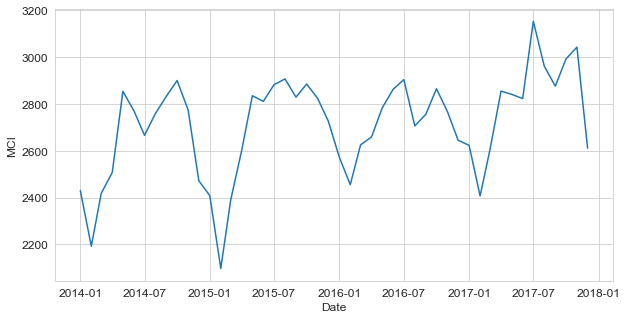

In [123]:
plt.figure(figsize=(10, 5))
plt.plot(MCI_total)
plt.xlabel('Date')
plt.ylabel('MCI')

Text(0, 0.5, 'MCI')

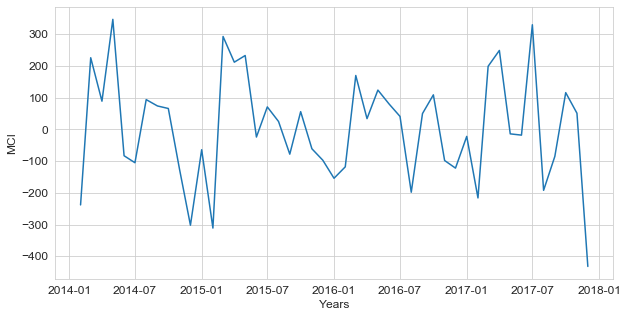

In [125]:
#STEP 1 Difference data to make data stationary on mean (remove trend)
#Plot data as time series
plt.figure(figsize=(10, 5))
plt.plot(MCI_total.diff(periods=1))
plt.xlabel('Years')
plt.ylabel('MCI')

Text(0, 0.5, 'MCI')

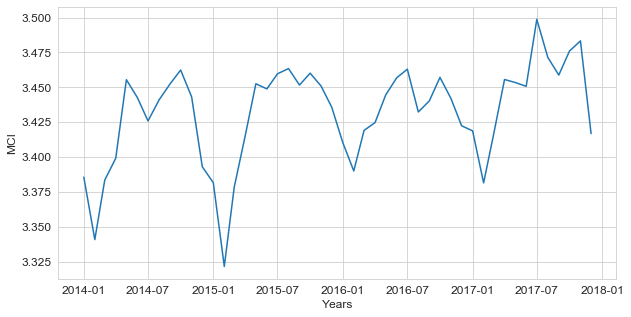

In [126]:
#STEP 2 Difference log transform data to make data stationary on both mean and variance
#log transform data (make data stationary on variance)
plt.figure(figsize=(10, 5))
plt.plot(np.log10(MCI_total))
plt.xlabel('Years')
plt.ylabel('MCI')

Text(0, 0.5, 'MCI')

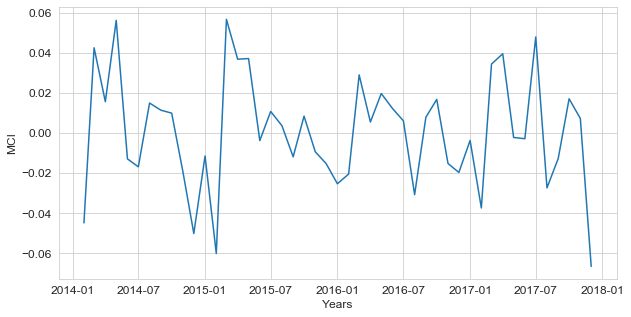

In [127]:
#differenced log transform data 
#To confirm if the series actually stationary on both mean and variance 
plt.figure(figsize=(10, 5))
plt.plot(np.log10(MCI_total).diff(periods=1))
plt.xlabel('Years')
plt.ylabel('MCI')

C:\Users\Bota\AppData\Local\Programs\Python\Python37\lib\site-packages\statsmodels\regression\linear_model.py:1358: RuntimeWarning: invalid value encountered in sqrt
  return rho, np.sqrt(sigmasq)


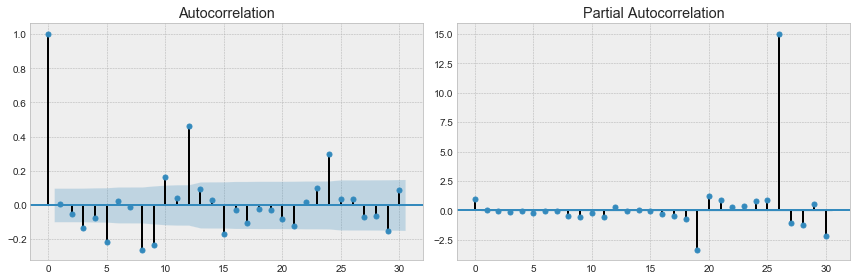

In [138]:
#Step 3
#PLOT ACF(Autocoreelation factor) AND PACF to identify potential AR and MA Model

MCI_log = np.log10(MCI_total)
MCI_log.dropna(inplace=True)

MCI_log_diff = MCI_log.diff(periods=1) # same as ts_log_diff = ts_log - ts_log.shift(periods=1)
MCI_log_diff.dropna(inplace=True)

fig, axes = plt.subplots(1, 2, sharey=False, sharex=False)
fig.set_figwidth(12)
fig.set_figheight(4)
smt.graphics.plot_acf(MCI_log_diff, lags=30, ax=axes[0], alpha=0.5)
smt.graphics.plot_pacf(MCI_log_diff, lags=30, ax=axes[1], alpha=0.5)
plt.tight_layout()

#Able to find the seasonal component availabe in the residuals at the lag 12 

In [139]:
#Step 4:
#Find ARIMA(p,d,q): Identification of best fit ARIMA model
#Test difference combination of p,d,q
#Find the minimum AIC(Akaike Information Criterion)
# d should be 1, from previous step
# Define the p, d and q parameters to take any value between 0 and 3
p = d = q = range(0, 3)

# Generate all different combinations of p, d and q triplets
pdq = list(itertools.product(p, d, q))

# Generate all different combinations of seasonal p, q and q triplets
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

In [140]:
warnings.filterwarnings("ignore") # specify to ignore warning messages

best_aic = np.inf
best_pdq = None
best_seasonal_pdq = None
temp_model = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        
        try:
            temp_model = sm.tsa.statespace.SARIMAX(MCI_log,
                                             order = param,
                                             seasonal_order = param_seasonal,
                                             enforce_stationarity=True,
                                             enforce_invertibility=True)
            results = temp_model.fit()

            # print("SARIMAX{}x{} - AIC:{}".format(param, param_seasonal, results.aic))
            if results.aic < best_aic:
                best_aic = results.aic
                best_pdq = param
                best_seasonal_pdq = param_seasonal
        except:
            #print("Unexpected error:", sys.exc_info()[0])
            continue
print("Best SARIMAX{}x{} model - AIC:{}".format(best_pdq, best_seasonal_pdq, best_aic))

Best SARIMAX(1, 1, 1)x(2, 0, 0, 12) model - AIC:-224.874774209623


### Time Series Prediction

In [142]:
#Step5 prediction

best_model = sm.tsa.statespace.SARIMAX(MCI_log, order=(1, 1, 1), seasonal_order=(2, 0, 0, 12), enforce_stationarity=True,
                                      enforce_invertibility=True)
best_results = best_model.fit()
# Get forecast 36 steps (3 years) ahead in future
n_steps = 36
pred_uc_99 = best_results.get_forecast(steps=36, alpha=0.01) # alpha=0.01 signifies 99% confidence interval
pred_uc_95 = best_results.get_forecast(steps=36, alpha=0.05) # alpha=0.05 95% CI

# Get confidence intervals 95% & 99% of the forecasts
pred_ci_99 = pred_uc_99.conf_int()
pred_ci_95 = pred_uc_95.conf_int()

idx = pd.date_range(MCI.index[-1], periods=n_steps, freq='MS')
fc_95 = pd.DataFrame(np.column_stack([np.power(10, pred_uc_95.predicted_mean), np.power(10, pred_ci_95)]), 
                     index=idx, columns=['forecast', 'lower_ci_95', 'upper_ci_95'])
fc_99 = pd.DataFrame(np.column_stack([np.power(10, pred_ci_99)]), 
                     index=idx, columns=['lower_ci_99', 'upper_ci_99'])
fc_all = fc_95.combine_first(fc_99)
fc_all = fc_all[['forecast', 'lower_ci_95', 'upper_ci_95', 'lower_ci_99', 'upper_ci_99']] # just reordering columns

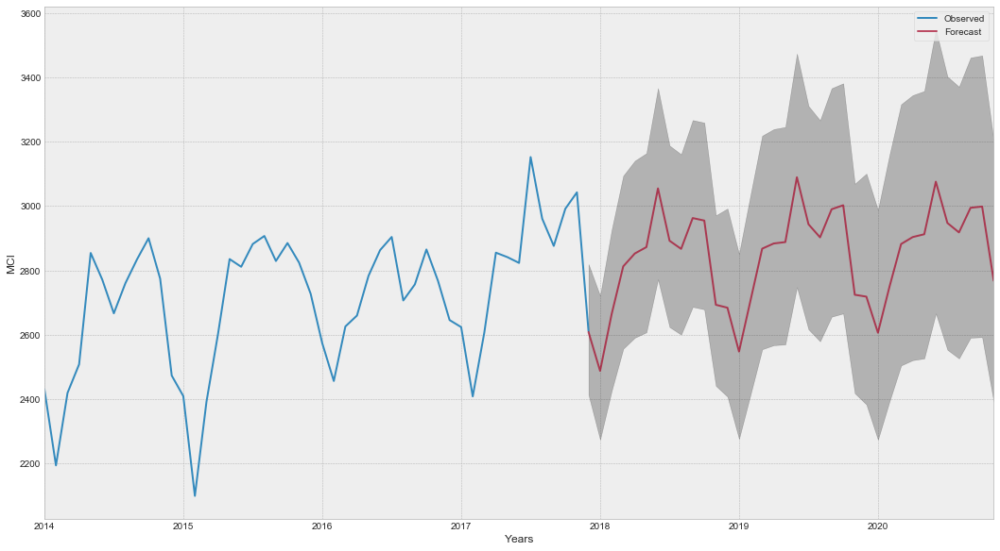

In [143]:
# plot the forecast along with the confidence band
axis = MCI_total.plot(label='Observed', figsize=(18, 10))
fc_all['forecast'].plot(ax=axis, label='Forecast', alpha=0.7)
axis.fill_between(fc_all.index, fc_all['lower_ci_95'], fc_all['upper_ci_95'], color='k', alpha=.25)
#axis.fill_between(fc_all.index, fc_all['lower_ci_99'], fc_all['upper_ci_99'], color='k', alpha=.75)
axis.set_xlabel('Years')
axis.set_ylabel('MCI')
plt.legend(loc='best')
plt.show()

In [144]:
MCI_total.head()

2014-01-01    2430
2014-02-01    2192
2014-03-01    2418
2014-04-01    2507
2014-05-01    2854
Freq: MS, Name: FC, dtype: int64

### Validate ARIMA Model

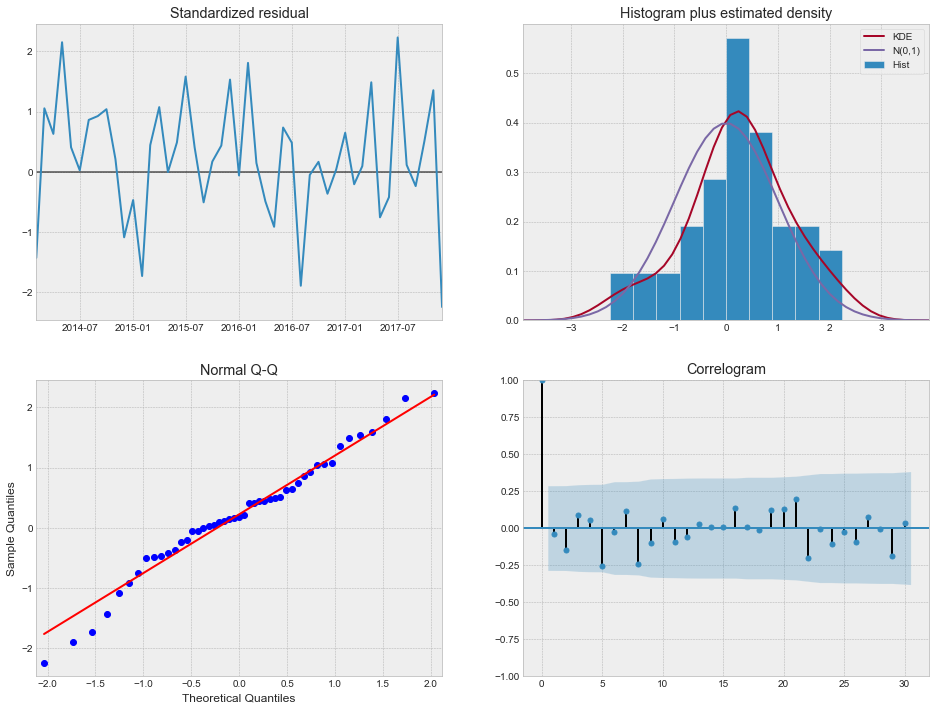

In [145]:
# validate Time series analysis result
best_results.plot_diagnostics(lags=30, figsize=(16,12))
plt.show()

# Random Forest Classifier Prediction

This section has built a prediction model using random forest classifier

In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.svm import SVC

import itertools
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")


### Data Preparation

In [2]:
# DATA IMPORT AND PRE-PROCESSING

#import full data set
df = pd.read_csv('MCI_2014_to_2017.csv',sep=',') 
df = df.drop(df[df['occurrenceyear'] < 2014].index)
data_org = df.iloc[:,[22,6,17,20,21,25]]
data_org = data_org.dropna()
data_org.head()

,MCI,premisetype,occurrencemonth,occurrencedayofweek,occurrencehour,Neighbourhood
0,Assault,Outside,August,Monday,18,Black Creek (24)
1,Break and Enter,House,August,Monday,9,Eringate-Centennial-West Deane (11)
2,Assault,House,August,Monday,11,Bendale (127)
3,Break and Enter,Commercial,August,Monday,17,Cabbagetown-South St.James Town (71)
4,Break and Enter,Other,August,Monday,16,Woburn (137)


In [3]:
# define a function to generate confusion matrix
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes , rotation=25)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

### MCI Prediction

In [4]:
data = data_org.copy()

# Get one hot encoding of columns MCI
#one_hot = pd.get_dummies(data['MCI'])
# Join the encoded df
#data = data.join(one_hot)

# Get one hot encoding of columns premisetype
one_hot = pd.get_dummies(data['premisetype'])
# Join the encoded df
data = data.join(one_hot)

# Get one hot encoding of columns occurrencemonth
one_hot = pd.get_dummies(data['occurrencemonth'])
# Join the encoded df
data = data.join(one_hot)

# Get one hot encoding of columns occurrencedayofweek
one_hot = pd.get_dummies(data['occurrencedayofweek'])
# Join the encoded df
data = data.join(one_hot)

# Get one hot encoding of columns occurrencehour
one_hot = pd.get_dummies(data['occurrencehour'])
# Join the encoded df
data = data.join(one_hot)

# Get one hot encoding of columns Neighbourhood
one_hot = pd.get_dummies(data['Neighbourhood'])
# Join the encoded df
data = data.join(one_hot)

# Set column Neighbourhood as target
data = data.drop('premisetype',axis = 1)
data = data.drop('occurrencemonth',axis = 1)
data = data.drop('Neighbourhood',axis = 1)
data = data.drop('occurrencedayofweek',axis = 1)
data = data.drop('occurrencehour',axis = 1)


In [5]:
# Target selection
y = data['MCI']
data = data.drop('MCI',axis = 1)
# Features selection
X = data[data.columns[:]]  

# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3) # 70% training and 30% test


### Random Forest

In [32]:
#Create a Gaussian Classifier
clf = RandomForestClassifier(n_estimators=50, max_depth = 25, criterion = 'gini')

#Train the model using the training sets.
clf.fit(X_train,y_train)

y_pred = clf.predict(X_test)
y_training = clf.predict(X_train)

In [33]:
# hyperparameter tuning
param_grid = {   'n_estimators': [20, 30, 50], 
                 'max_depth': [10, 15, 20, 25],
             }

grid_clf = GridSearchCV(clf, param_grid, cv=10)
grid_clf.fit(X_train, y_train)
grid_clf.best_params_

{'max_depth': 25, 'n_estimators': 50}

Testing Accuracy: 60.39 %
Training Accuracy: 64.79 %

Classification report: 
                  precision    recall  f1-score   support

        Assault       0.60      0.93      0.73     21284
     Auto Theft       0.59      0.12      0.20      4021
Break and Enter       0.61      0.40      0.48      8211
        Robbery       0.64      0.02      0.04      4316
     Theft Over       0.00      0.00      0.00      1219

       accuracy                           0.60     39051
      macro avg       0.49      0.29      0.29     39051
   weighted avg       0.59      0.60      0.52     39051
 

Confusion matrix, without normalization
[[19733   172  1339    40     0]
 [ 3107   484   418    11     1]
 [ 4874    62  3273     1     1]
 [ 4003    63   155    94     1]
 [ 1019    36   162     2     0]]


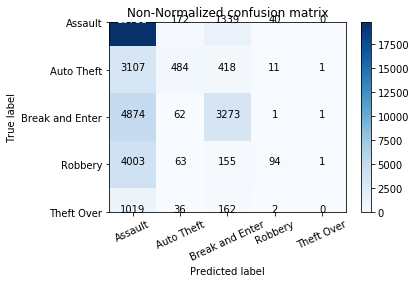

Normalized confusion matrix
[[9.27128359e-01 8.08118775e-03 6.29111069e-02 1.87934599e-03
  0.00000000e+00]
 [7.72693360e-01 1.20368068e-01 1.03954240e-01 2.73563790e-03
  2.48694355e-04]
 [5.93593959e-01 7.55084643e-03 3.98611619e-01 1.21787846e-04
  1.21787846e-04]
 [9.27479147e-01 1.45968489e-02 3.59128823e-02 2.17794254e-02
  2.31696015e-04]
 [8.35931091e-01 2.95324036e-02 1.32895816e-01 1.64068909e-03
  0.00000000e+00]]


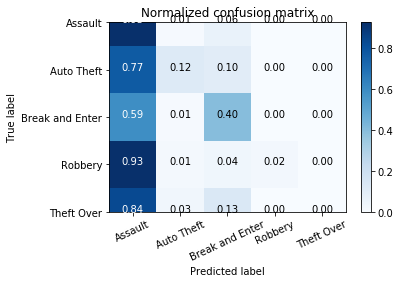

In [34]:
# result display
print("Testing Accuracy:", round(metrics.accuracy_score(y_test, y_pred) * 100, 2), "%")
print("Training Accuracy:", round(metrics.accuracy_score(y_train, y_training)* 100, 2), "%\n")
print( 'Classification report: \n', metrics.classification_report(y_test, y_pred), "\n")

plt.figure()
plot_confusion_matrix(metrics.confusion_matrix(y_test, y_pred), classes=list(clf.classes_), normalize=False, title='Non-Normalized confusion matrix')
plt.show()

plt.figure()
plot_confusion_matrix(metrics.confusion_matrix(y_test, y_pred), classes=list(clf.classes_), normalize=True, title='Normalized confusion matrix')
plt.show()


In [37]:
pred = clf.predict_proba(X_test)
eval = metrics.log_loss(y_test,pred) 
eval

0.9824374971006131

In [45]:
#Create a Gaussian Classifier
clf = RandomForestClassifier(n_estimators=10, max_depth = 25, criterion = 'gini')

#Train the model using the training sets.
clf.fit(X_train,y_train)

y_pred = clf.predict(X_test)
y_training = clf.predict(X_train)

Testing Accuracy: 59.86 %
Training Accuracy: 65.0 %

Classification report: 
                  precision    recall  f1-score   support

        Assault       0.61      0.91      0.73     21284
     Auto Theft       0.56      0.12      0.19      4021
Break and Enter       0.57      0.42      0.48      8211
        Robbery       0.55      0.03      0.06      4316
     Theft Over       0.17      0.00      0.00      1219

       accuracy                           0.60     39051
      macro avg       0.49      0.30      0.29     39051
   weighted avg       0.57      0.60      0.52     39051
 

Confusion matrix, without normalization
[[19344   177  1687    72     4]
 [ 2999   466   524    28     4]
 [ 4698    74  3428     6     5]
 [ 3908    83   189   134     2]
 [  967    37   207     5     3]]


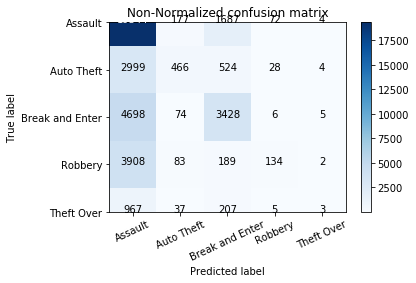

Normalized confusion matrix
[[9.08851720e-01 8.31610600e-03 7.92614170e-02 3.38282278e-03
  1.87934599e-04]
 [7.45834370e-01 1.15891569e-01 1.30315842e-01 6.96344193e-03
  9.94777419e-04]
 [5.72159299e-01 9.01230057e-03 4.17488735e-01 7.30727073e-04
  6.08939228e-04]
 [9.05468026e-01 1.92307692e-02 4.37905468e-02 3.10472660e-02
  4.63392030e-04]
 [7.93273175e-01 3.03527482e-02 1.69811321e-01 4.10172272e-03
  2.46103363e-03]]


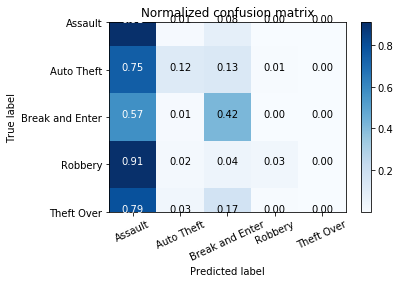

In [46]:
# result display
print("Testing Accuracy:", round(metrics.accuracy_score(y_test, y_pred) * 100, 2), "%")
print("Training Accuracy:", round(metrics.accuracy_score(y_train, y_training)* 100, 2), "%\n")
print( 'Classification report: \n', metrics.classification_report(y_test, y_pred), "\n")

plt.figure()
plot_confusion_matrix(metrics.confusion_matrix(y_test, y_pred), classes=list(clf.classes_), normalize=False, title='Non-Normalized confusion matrix')
plt.show()

plt.figure()
plot_confusion_matrix(metrics.confusion_matrix(y_test, y_pred), classes=list(clf.classes_), normalize=True, title='Normalized confusion matrix')
plt.show()

In [47]:
pred = clf.predict_proba(X_test)
eval = metrics.log_loss(y_test,pred) 
eval

0.9966408801390946

### Gaussian Naive Bayes

In [9]:

from sklearn.pipeline import make_pipeline
from sklearn.naive_bayes import GaussianNB
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

In [10]:

# Fit to data and predict using pipelined scaling, GNB and PCA.
std_clf = make_pipeline(StandardScaler(), PCA(n_components=3), GaussianNB())
std_clf.fit(X_train, y_train)
pred_test_std = std_clf.predict(X_test)

In [11]:
# Show prediction accuracies in scaled and unscaled data.
print('\nPrediction accuracy for the standardized test dataset with PCA')
print('{:.2%}\n'.format(metrics.accuracy_score(y_test, pred_test_std)))


Prediction accuracy for the standardized test dataset with PCA
55.24%



In [12]:
pred = std_clf.predict_proba(X_test)
eval = metrics.log_loss(y_test,pred) 
eval

1.1073301893141123

### Logistic Regression

In [26]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(class_weight=None)
logreg.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

In [27]:
y_train_pred = logreg.predict(X_train)
y_test_pred = logreg.predict(X_test)


In [28]:

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

Testing Accuracy: 58.98 %
Training Accuracy: 59.35 %

Classification report: 
                  precision    recall  f1-score   support

        Assault       0.60      0.93      0.73     21284
     Auto Theft       0.62      0.11      0.19      4021
Break and Enter       0.61      0.41      0.49      8211
        Robbery       0.65      0.03      0.06      4316
     Theft Over       0.20      0.00      0.00      1219

       accuracy                           0.61     39051
      macro avg       0.54      0.29      0.29     39051
   weighted avg       0.60      0.61      0.53     39051
 

Confusion matrix, without normalization
[[19047   430  1745    62     0]
 [ 2597   715   669    40     0]
 [ 4983    41  3186     1     0]
 [ 3674   267   290    85     0]
 [  884    64   268     3     0]]


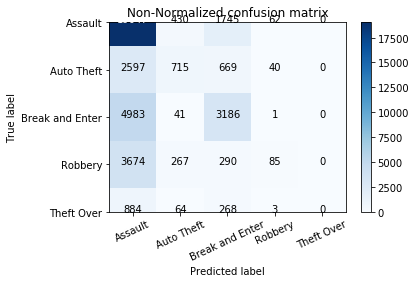

ValueError: Found input variables with inconsistent numbers of samples: [39051, 91116]

<Figure size 432x288 with 0 Axes>

In [29]:
# result display
print("Testing Accuracy:", round(metrics.accuracy_score(y_test, y_test_pred) * 100, 2), "%")
print("Training Accuracy:", round(metrics.accuracy_score(y_train, y_train_pred)* 100, 2), "%\n")
print( 'Classification report: \n', metrics.classification_report(y_test, y_pred), "\n")

plt.figure()
plot_confusion_matrix(metrics.confusion_matrix(y_test, y_test_pred), classes=list(logreg.classes_), normalize=False, title='Non-Normalized confusion matrix')
plt.show()

plt.figure()
plot_confusion_matrix(metrics.confusion_matrix(y_test, y_train_pred), classes=list(logreg.classes_), normalize=True, title='Normalized confusion matrix')
plt.show()


In [30]:
pred = logreg.predict_proba(X_test)
eval = metrics.log_loss(y_test,pred) 
eval

1.0072812942229814

### K-Nearest Neighbor

In [41]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=300)
knn.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=300, p=2,
                     weights='uniform')

In [42]:
y_pred = knn.predict(X_test)

In [43]:
metrics.accuracy_score(y_test, y_pred)

0.5864382474200405

In [44]:

pred = knn.predict_proba(X_test)
eval = metrics.log_loss(y_test,pred) 
eval

1.023580608295489

### Decision Tree Classifier

In [38]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

param_grid = {'min_samples_split':[50, 300, 500, 600] }

treeclf = DecisionTreeClassifier(min_samples_split=300, 
                                 criterion='gini', max_depth=4, 
                                 random_state=1)

#treeclf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', max_depth=6, 
#                                 random_state=1), param_grid)

treeclf.fit(X_train, y_train)
y_pred = treeclf.predict(X_test)

In [39]:
metrics.accuracy_score(y_test, y_pred)

0.5679496043635246

In [40]:
# Log-Loss

pred = treeclf.predict_proba(X_test)
eval = metrics.log_loss(y_test,pred) 
eval

1.053673965018412